# Paquetes y Funciones

In [1]:
import nbimporter
from funciones_eda import *

import warnings
warnings.filterwarnings("ignore")

# Carga de datos

In [2]:
ruta_datos_procesados = os.getcwd().replace("Codigo\\EDA", "Datos\\Procesados\\")

In [20]:
df = pd.read_csv(ruta_datos_procesados + 'datos_jobs_finales.csv')

# Análisis exploratorio de datos

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18237 entries, 0 to 18236
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   titulo            18237 non-null  object 
 1   empresa           18166 non-null  object 
 2   fecha             18181 non-null  object 
 3   herramientas      18237 non-null  object 
 4   descripcion       18237 non-null  object 
 5   presencialidad    18237 non-null  object 
 6   jornada           18237 non-null  object 
 7   experiencia       9526 non-null   float64
 8   tipo_contrato     18237 non-null  object 
 9   beneficios        18237 non-null  bool   
 10  solicitudes       18237 non-null  int64  
 11  portal            18237 non-null  object 
 12  salario_min       3076 non-null   float64
 13  salario_max       3065 non-null   float64
 14  localidad         15162 non-null  object 
 15  provincia         15680 non-null  object 
 16  comunidad         15685 non-null  object

In [22]:
df.describe()

,experiencia,solicitudes,salario_min,salario_max,latitud,longitud
count,9526.000000,18237.000000,3076.000000,3065.000000,18193.000000,18193.000000
mean,3.204808,4.092614,31899.020481,39794.680261,40.527237,-2.385124
std,1.891088,14.990332,12438.474113,15849.840571,2.202528,4.126953
min,0.000000,0.000000,0.000000,4400.000000,-38.416097,-103.347339
25%,2.000000,0.000000,24000.000000,30000.000000,40.416775,-3.749220
50%,3.000000,0.000000,30000.000000,39000.000000,40.463667,-3.703790
75%,4.000000,0.000000,39000.000000,48000.000000,41.387397,-0.376288
max,10.000000,125.000000,168000.000000,180000.000000,55.378051,106.629664


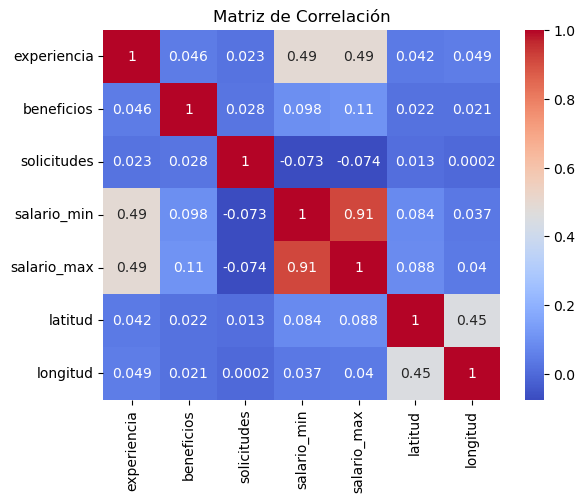

In [23]:
df_numeric = df.select_dtypes(include=['float64', 'int64', 'bool'])

correlation_matrix = df_numeric.corr()

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlación')
plt.show()

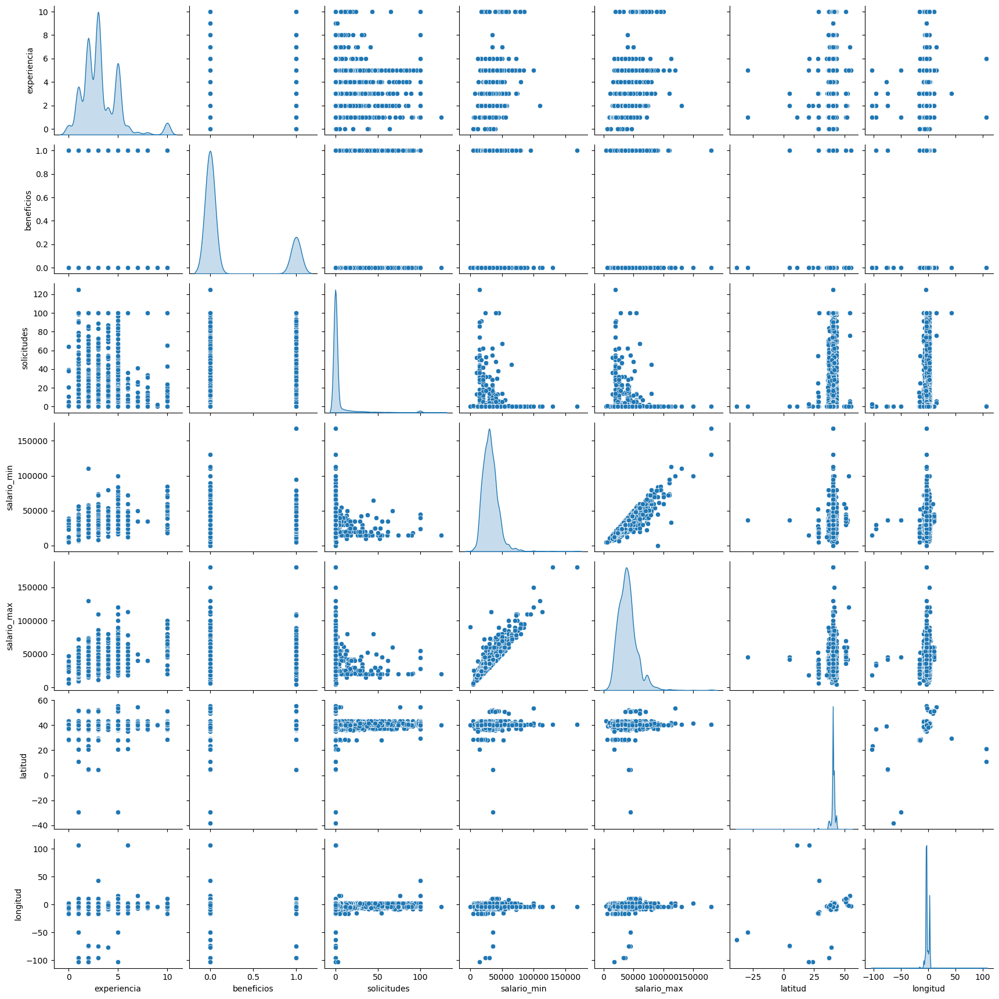

In [24]:
sns.pairplot(df, diag_kind='kde')
plt.show()

## 1. Preparación de los datos

### Ejecutar la limpieza

In [25]:
# Aplica la función safe_literal_eval para convertir los strings a sets
df['herramientas'] = df['herramientas'].apply(safe_literal_eval)

# Contamos las herramientas en el DataFrame original
conteo_herramientas_original = contar_herramientas(df)

# Hacemos los cambios in place, removiendo los sets vacíos que representan valores NaN
df['herramientas'] = df['herramientas'].apply(lambda x: x if x != {'set()'} else set())

### Descartar columnas innecesarias

In [26]:
df = df.drop(['descripcion', 'latitud', 'longitud'], axis=1)

### Herramientas

In [27]:
df_herramientas = df.copy()

df_herramientas['herramientas'] = df_herramientas['herramientas'].apply(lambda x : str(x)) 

df_herramientas['herramientas'] = df_herramientas['herramientas'].replace('set()', None)

df_herramientas = df_herramientas.dropna(subset = 'herramientas').reset_index(drop = True)

df_herramientas['herramientas'] = df_herramientas['herramientas'].apply(lambda x: re.sub(r"[{}']", '', str(x)).split(', '))

# Crear un objeto MultiLabelBinarizer
mlb = MultiLabelBinarizer()

# Aplicar el MultiLabelBinarizer a la columna 'herramientas'
encoded_data = mlb.fit_transform(df_herramientas['herramientas'])
columnas_herramientas = mlb.classes_

# Crear un DataFrame con las columnas one-hot
df_encoded = pd.DataFrame(encoded_data, columns=columnas_herramientas)

# Concatenar el nuevo DataFrame con el original eliminando la columna original
df_herramientas = pd.concat([df_herramientas, df_encoded], axis=1)

In [28]:
############################ Limpieza OFFICE ######################################
############################ Limpieza OFFICE ######################################
df_herramientas['microsoft 365'] = df_herramientas['office'] + df_herramientas['microsoft 365']

df_herramientas['microsoft 365'] = df_herramientas['microsoft 365'].replace({2:1})

df_herramientas = df_herramientas.drop(columns = 'office')
############################ Limpieza OFFICE ######################################
############################ Limpieza OFFICE ######################################

In [29]:
categorias_empleo = df_herramientas['categoria_empleo'].unique()

df_herramientas_con_ingles = df_herramientas.copy()

df_herramientas = df_herramientas.drop(columns = 'ingles')

columnas_herramientas = df_herramientas.columns.drop(df.columns).tolist()
columnas_herramientas_con_ingles = df_herramientas_con_ingles.columns.drop(df.columns).tolist()

In [30]:
# Seleccionar las herramientas que aparecen al menos un 0.5% de las veces
conteo_true = df_herramientas[columnas_herramientas].mean()
columnas_a_eliminar = conteo_true[conteo_true < 0.005].index

# Eliminar las columnas seleccionadas del DataFrame
df_herramientas = df_herramientas.drop(columns=columnas_a_eliminar)
columnas_herramientas = list(set(columnas_herramientas).intersection(set(df_herramientas.columns)))

valores = df_herramientas[columnas_herramientas].sum().sort_values(ascending = False).reset_index()

top_combinaciones_2, idx_2 = combinaciones_herramientas(df_herramientas, valores['index'].head(50), 2)
top_combinaciones_3, idx_3 = combinaciones_herramientas(df_herramientas, valores['index'].head(50), 3)

#Parejas
top_combinaciones_2 = top_combinaciones_2.replace({0:np.nan}).dropna().head(1500)
combinaciones = top_combinaciones_2['combinacion'].values

columnas_parejas_herramientas = []
for combinacion in combinaciones:

    nombre_columna = ''
    for el in combinacion:
        nombre_columna += el + ' + ' if el != combinacion[-1] else el

    columnas_parejas_herramientas.append(nombre_columna)
    df_herramientas[nombre_columna] = 0
    df_herramientas.loc[idx_2[combinacion], nombre_columna] = 1

#Ternas
top_combinaciones_3 = top_combinaciones_3.replace({0:np.nan}).dropna().head(1500)
combinaciones = top_combinaciones_3['combinacion'].values

columnas_ternas_herramientas = []
for combinacion in combinaciones:

    nombre_columna = ''
    for el in combinacion:
        nombre_columna += el + ' + ' if el != combinacion[-1] else el

    columnas_ternas_herramientas.append(nombre_columna)
    df_herramientas[nombre_columna] = 0
    df_herramientas.loc[idx_3[combinacion], nombre_columna] = 1

### Salarios

In [31]:
df_salarios = df.dropna(subset = ['salario_min', 'salario_max'], how = 'all')

df_salarios = df_salarios[df_salarios['salario_min'] > 15000]

df_salarios = metodo_tukey(df_salarios, 'salario_min', 1.5)
df_salarios = metodo_tukey(df_salarios, 'salario_max', 1.5)

df_salarios['salario_medio'] = (df['salario_min'].replace({np.nan : 0}) + df['salario_max'].replace({np.nan : 0})) / 2

columnas_salarios = ['salario_min', 'salario_max', 'salario_medio']

nombres_intervalos = ['muy_bajo', 'bajo', 'estandar', 'alto']
columnas_intervalos_salariales = []

for salario in columnas_salarios:
    media = df_salarios[salario].mean()
    std = df_salarios[salario].std()
    
    limites_superiores = [media - 1.5 * std, media - 0.75 * std, media + 0.75 * std, media + 1.5 * std]
    indices_libres = df_salarios.index

    for limite_superior, nombre_intervalo in zip(limites_superiores, nombres_intervalos):
        nombre_columna = f'{salario}_{nombre_intervalo}'
        
        df_salarios[nombre_columna] = df_salarios.loc[indices_libres][salario].apply(lambda x : 1 if x < limite_superior else 0)
        
        indices_ocupados = set(df_salarios[df_salarios[nombre_columna] == 1].index)        
        
        indices_libres = list(set(indices_libres).difference(indices_ocupados))
        columnas_intervalos_salariales.append(nombre_columna)
    
    df_temp = df_salarios.loc[indices_libres]
        
    df_salarios[f'{salario}_muy_alto'] = 0
    df_salarios.loc[indices_libres, f'{salario}_muy_alto'] = 1
    columnas_intervalos_salariales.append(f'{salario}_muy_alto')
    
        
df_salarios[columnas_intervalos_salariales] = df_salarios[columnas_intervalos_salariales].fillna(0)

In [32]:
df_salarios_completo = df_salarios.copy()
columnas_intervalos_salariales_completo = columnas_intervalos_salariales.copy()

df_salarios = df_salarios.drop(columns = [columna for columna in columnas_intervalos_salariales if not columna.startswith('salario_medio')])
columnas_intervalos_salariales = [columna for columna in columnas_intervalos_salariales if columna.startswith('salario_medio')]

In [35]:
columnas_booleanas = columnas_intervalos_salariales

def obtener_categoria(row):
    for columna in columnas_booleanas:
        if row[columna] == 1:
            return columna
    return None   

df_salarios['intervalo_salarial_medio'] = df_salarios.apply(obtener_categoria, axis=1)

### Empresas

In [36]:
df_empresas = df.copy()
columnas_empresas = df.dropna(subset = 'empresa')['empresa'].unique().tolist()

In [37]:
df_empresas = pd.get_dummies(data = df_empresas, columns = ['empresa'], dtype = int, prefix = '', prefix_sep = '')

### Stack

In [38]:
df_stack = df.copy()
columnas_stack = df.dropna(subset = 'categoria_empleo')['categoria_empleo'].unique().tolist()

In [39]:
df_stack = pd.get_dummies(data = df_stack, columns = ['categoria_empleo'], dtype = int, prefix = '', prefix_sep = '')

# 2. Análisis univariable

## 2.1. Herramientas

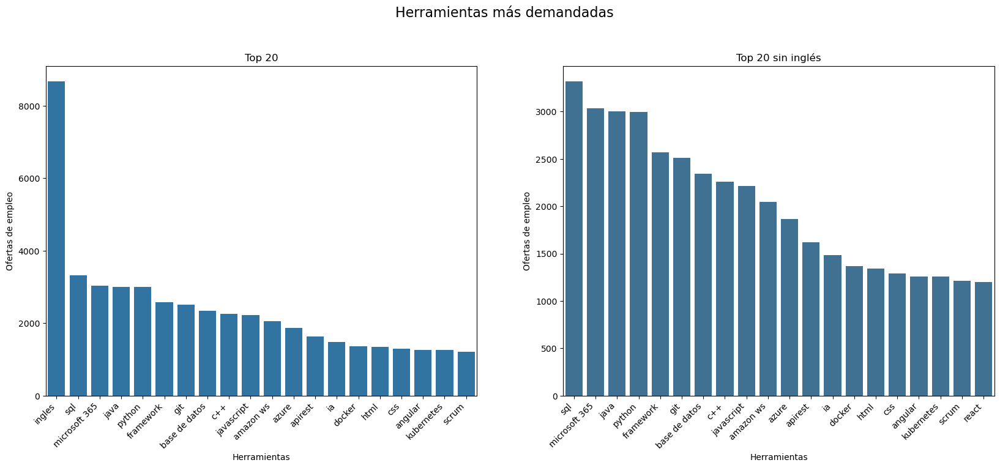

In [40]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df_herramientas_con_ingles[columnas_herramientas_con_ingles].sum().sort_values(ascending = False)

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['ingles']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Herramientas')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')
axes[0].set_title(f'Top 20')

axes[1].set_xlabel('Herramientas')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Top 20 sin inglés')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle(f'Herramientas más demandadas', fontsize=16, y=1.02)

plt.show()

### 2.1.1. Análisis por pares de  herramientas

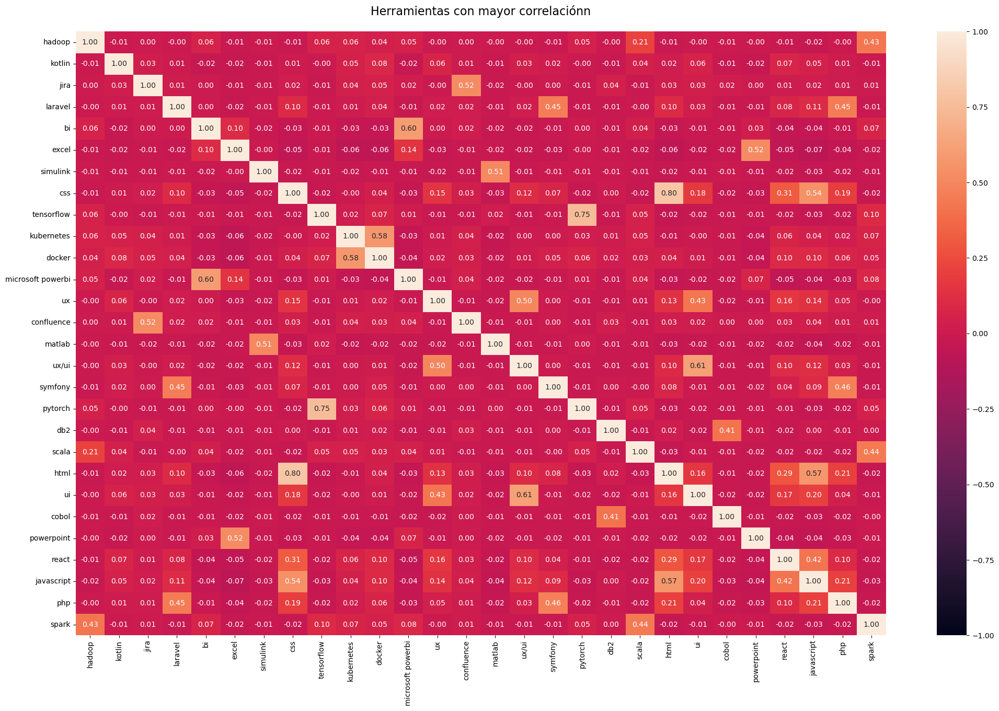

In [41]:
matriz_correlacion = df_herramientas[columnas_herramientas].corr()

# Elegimos los pares con mayor correlacion
max_corr_20_pairs = matriz_correlacion.abs().unstack().sort_values(ascending=False).drop_duplicates().head(20)

#Nos quedamos con los elementos unicos del multiindice
herraminetas_mayor_correlacion = set([herramienta for par_herramientas in max_corr_20_pairs.index for herramienta in par_herramientas])
herraminetas_mayor_correlacion = list(herraminetas_mayor_correlacion)

plt.figure(figsize = (25,15))
sns.heatmap(df_herramientas[herraminetas_mayor_correlacion].corr(), vmin=-1, vmax=1, annot=True, fmt=".2f")
plt.title(f'Herramientas con mayor correlaciónn', fontsize=16, y=1.02)
plt.show()

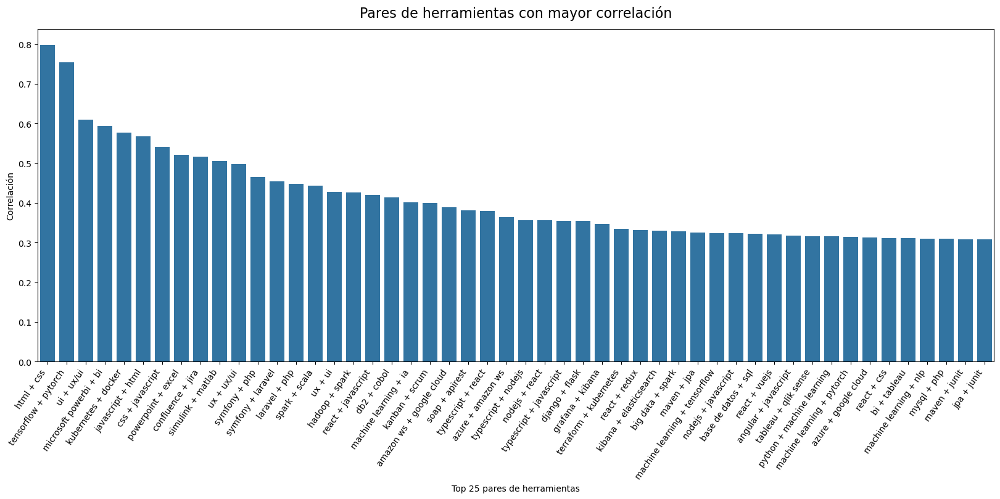

In [42]:
corr_pairs = matriz_correlacion.abs().unstack().sort_values(ascending=False).drop_duplicates()

#Elefimos solo los pares con herramientas diferentes
max_corr_50_pairs = []
for indice in corr_pairs.index:
    if indice[0] != indice[1]:
        max_corr_50_pairs.append(indice)
        if len(max_corr_50_pairs) == 50:
            break   
max_corr_50_pairs = corr_pairs[max_corr_50_pairs]

# obtenermos los indices para graficas

max_corr_50_pairs = max_corr_50_pairs.reset_index()

max_corr_50_pairs['indice'] = max_corr_50_pairs['level_0'] + ' + ' + max_corr_50_pairs['level_1']

plt.figure(figsize = (20,7))
sns.barplot(x=max_corr_50_pairs['indice'], y=max_corr_50_pairs[0])
plt.xlabel('Top 25 pares de herramientas')
plt.ylabel('Correlación')
plt.xticks(rotation = 55, ha = 'right')
plt.title(f'Pares de herramientas con mayor correlación', fontsize=16, y=1.02)
plt.show()

### 2.1.2. Análisis por grupos de  herramientas

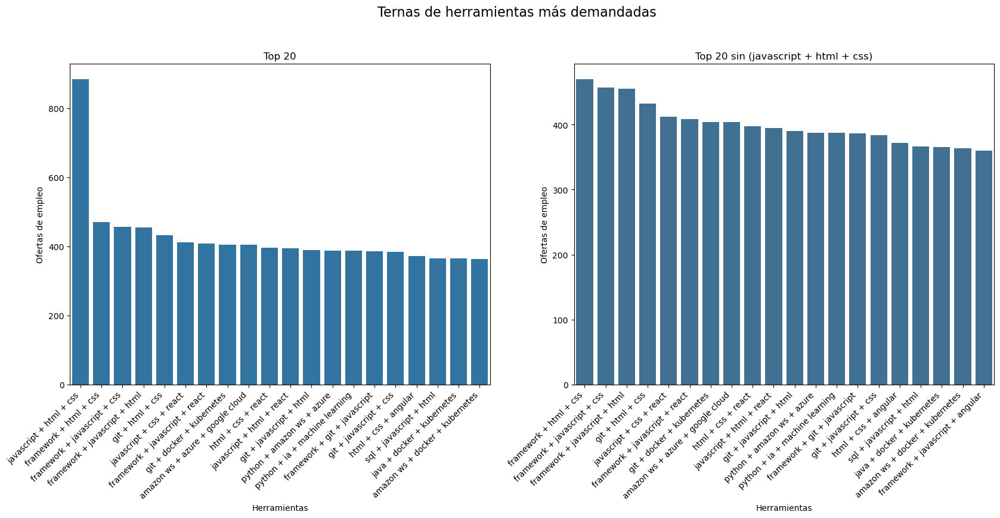

In [43]:
top_combinaciones_3['combinacion'] = top_combinaciones_3['combinacion'].apply(lambda x: ' + '.join(x) if isinstance(x, (list, tuple)) else x)

fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()

sns.barplot(data = top_combinaciones_3.head(20), x = 'combinacion', y = 'total', ax = axes[0])

categorias_a_eliminar = [top_combinaciones_3.iloc[0,0]]
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(data = top_combinaciones_3.drop(0).head(20), x = 'combinacion', y = 'total', palette = colores, ax = axes[1])

axes[0].set_xlabel('Herramientas')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')
axes[0].set_title(f'Top 20')

axes[1].set_xlabel('Herramientas')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Top 20 sin (javascript + html + css)')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle(f'Ternas de herramientas más demandadas', fontsize=16, y=1.02)

plt.show()

## 2.2. Salarios

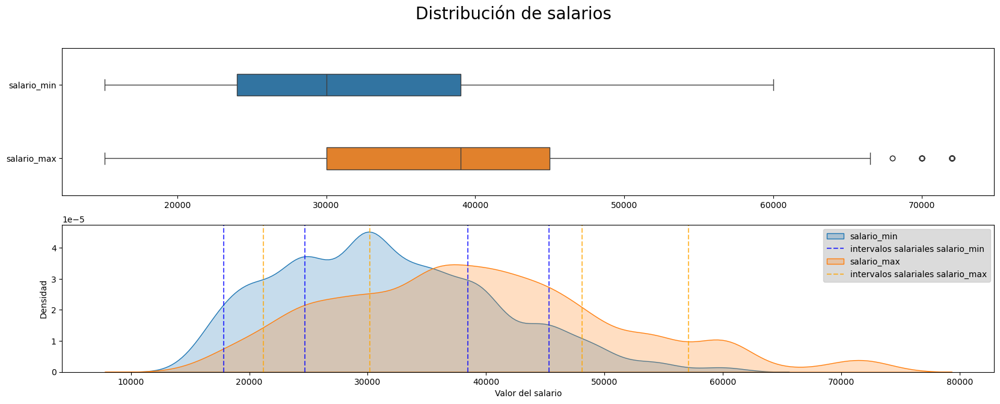

In [44]:
fig, axes = plt.subplots(2,1, figsize = (20,7))
axes = axes.flatten()

sns.boxplot(data = df_salarios[['salario_min', 'salario_max']], orient = 'h', width = 0.3, ax = axes[0])

for color, salario in zip(['blue', 'orange'], ['salario_min', 'salario_max']):
    sns.kdeplot(df_salarios[salario], label=f'{salario}', fill=True, ax = axes[1])
    media = df_salarios[salario].mean()
    std = df_salarios[salario].std()
    
    limites_superiores = [media - 1.5 * std, media - 0.75 * std, media + 0.75 * std, media + 1.5 * std]

    label_agregado = False

    for limite in limites_superiores:
        if not label_agregado:
            axes[1].axvline(x=limite, linestyle='--', color=color, alpha=0.7, label = f'intervalos salariales {salario}')
            label_agregado = True
        
        else:
            axes[1].axvline(x=limite, linestyle='--', color=color, alpha=0.7)
        

# Añadir leyenda
plt.legend(facecolor='lightgray', labelcolor='black')

# Configuraciones adicionales
plt.suptitle('Distribución de salarios', fontsize=20)
plt.xlabel('Valor del salario')
plt.ylabel('Densidad')

# Mostrar el gráfico
plt.show()  

## 2.3. Empresas

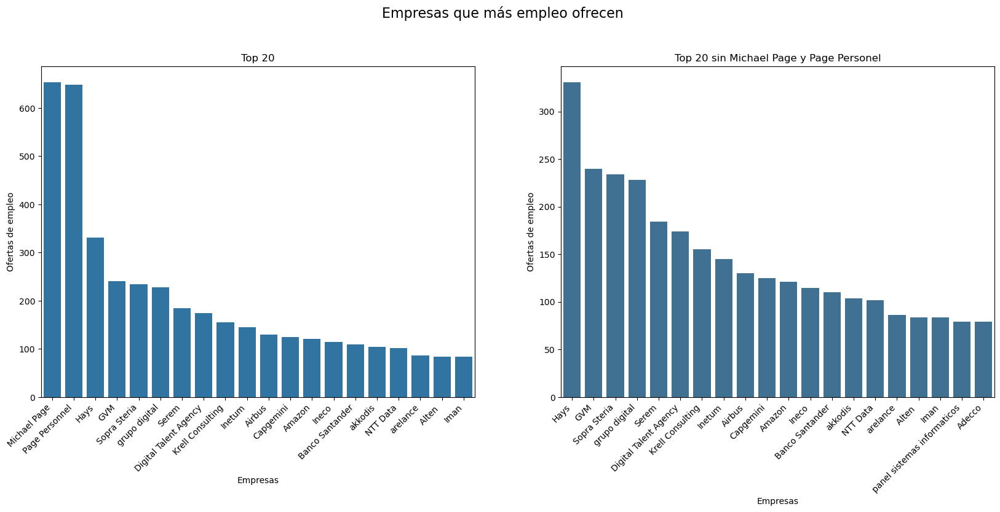

In [45]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df['empresa'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['Michael Page', 'Page Personnel']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Empresas')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')
axes[0].set_title(f'Top 20')

axes[1].set_xlabel('Empresas')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Top 20 sin Michael Page y Page Personel')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle(f'Empresas que más empleo ofrecen', fontsize=16, y=1.02)

plt.show()

## 2.4. Particularidades del contrato

### 2.4.1. Presencialidad

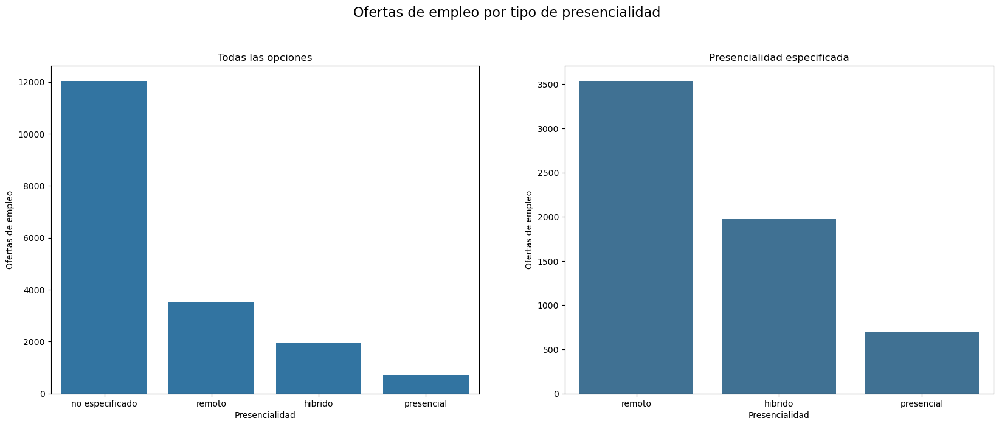

In [46]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df['presencialidad'].value_counts()

sns.barplot(x=df_grafico.index, y=df_grafico.values, ax = axes[0])

categorias_a_eliminar = ['no especificado']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).index, y=df_grafico.drop(categorias_a_eliminar).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Presencialidad')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Todas las opciones')

axes[1].set_xlabel('Presencialidad')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Presencialidad especificada')

fig.suptitle('Ofertas de empleo por tipo de presencialidad', fontsize=16, y=1.02)

plt.show()

### 2.4.2. Jornada

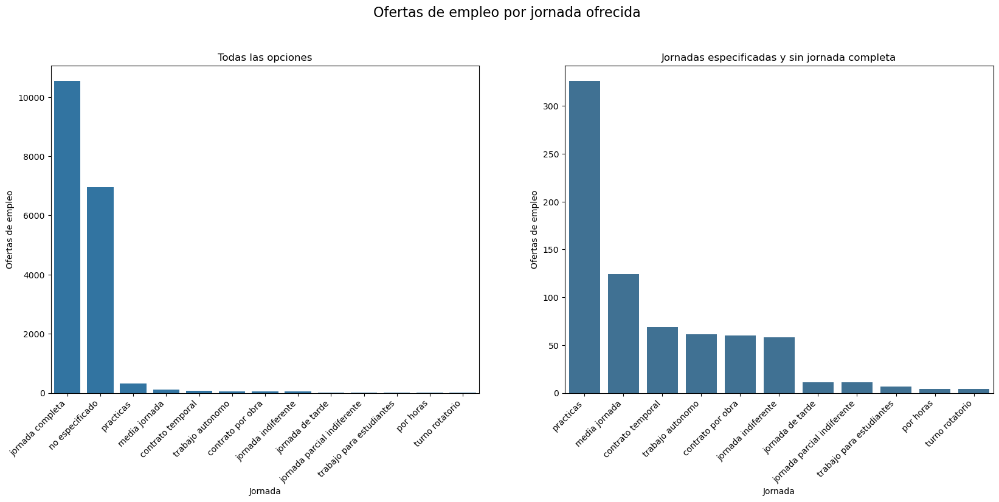

In [47]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df['jornada'].value_counts()

sns.barplot(x=df_grafico.index, y=df_grafico.values, ax = axes[0])

categorias_a_eliminar = ['no especificado', 'jornada completa']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).index, y=df_grafico.drop(categorias_a_eliminar).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Jornada')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')
axes[0].set_title(f'Todas las opciones')

axes[1].set_xlabel('Jornada')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Jornadas especificadas y sin jornada completa')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por jornada ofrecida', fontsize=16, y=1.02)

plt.show()

### 2.4.3. Beneficios

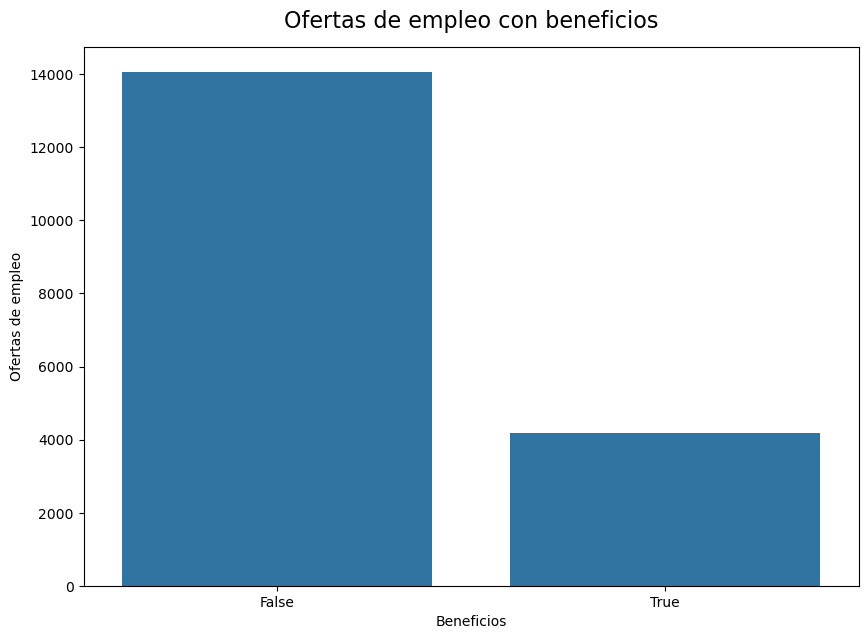

In [48]:
plt.figure(figsize = (10,7))

df_grafico = df['beneficios'].value_counts()

sns.barplot(x=df_grafico.index, y=df_grafico.values)

plt.title('Ofertas de empleo con beneficios', fontsize=16, y=1.02)
plt.xlabel('Beneficios')
plt.ylabel('Ofertas de empleo')

plt.show()

## 2.5. Experiencia

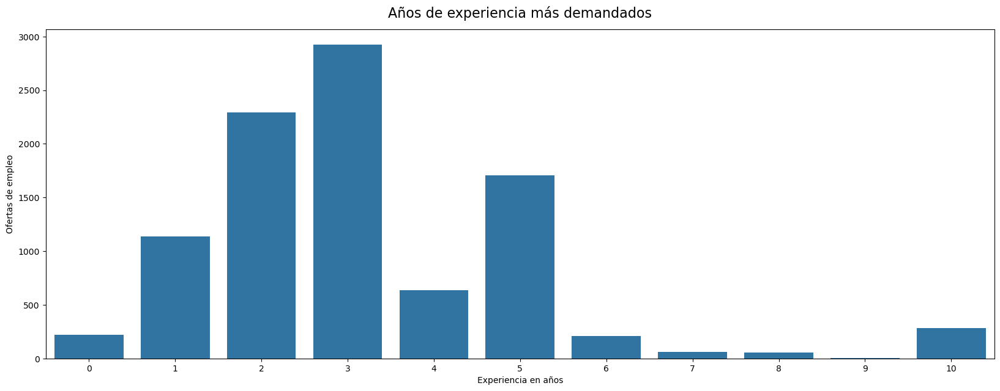

In [49]:
plt.figure(figsize = (20,7))

df_grafico = df['experiencia'].value_counts()
df_grafico.index = df_grafico.index.astype(int)

sns.barplot(x=df_grafico.index, y=df_grafico.values)

plt.title('Años de experiencia más demandados', fontsize=16, y=1.02)
plt.xlabel('Experiencia en años')
plt.ylabel('Ofertas de empleo')

plt.show()

## 2.6. Tipo de contrato

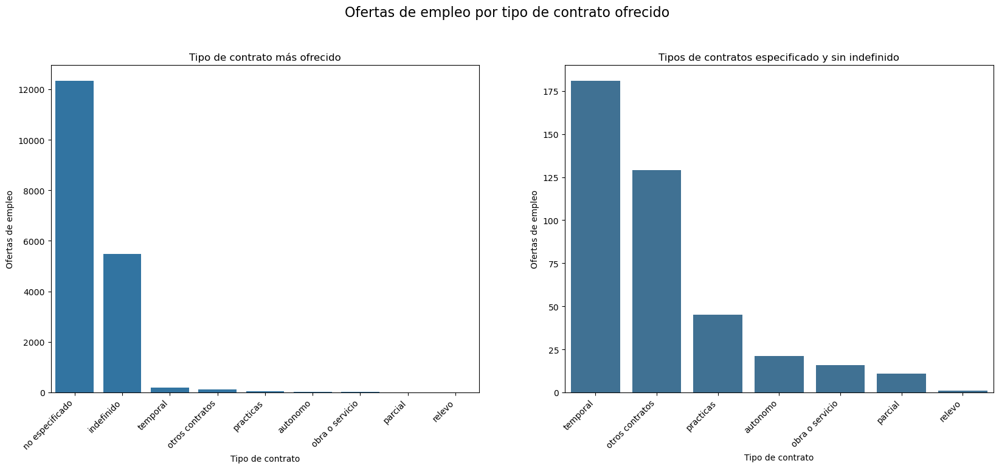

In [50]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df['tipo_contrato'].value_counts()

sns.barplot(x=df_grafico.index, y=df_grafico.values, ax = axes[0])

categorias_a_eliminar = ['no especificado', 'indefinido']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).index, y=df_grafico.drop(categorias_a_eliminar).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Tipo de contrato')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Tipo de contrato más ofrecido')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('Tipo de contrato')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Tipos de contratos especificado y sin indefinido')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por tipo de contrato ofrecido', fontsize=16, y=1.02)

plt.show()

## 2.7. Solicitudes

<Figure size 1000x600 with 0 Axes>

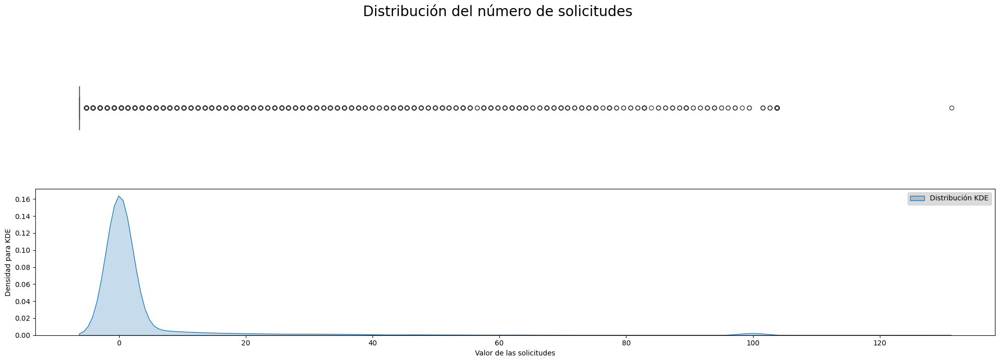

In [51]:
plt.figure(figsize=(10, 6))
fig, axes = plt.subplots(2, 1, figsize=(20, 7))
axes = axes.flatten()

# Boxplot
sns.boxplot(data=df['solicitudes'], orient='h', width=0.3, ax=axes[0])
axes[0].set_axis_off()

# KDE plot
sns.kdeplot(df['solicitudes'], fill=True, ax=axes[1], label='Distribución KDE')

# Configuraciones adicionales
plt.suptitle('Distribución de solicitudes', y=1.02)  # Título principal para ambos subgráficos
plt.xlabel('Valor de las solicitudes')

# Mostrar la leyenda
axes[1].legend(facecolor='lightgray', labelcolor='black')

# Ajustes adicionales
plt.ylabel('Densidad para KDE')
plt.tight_layout()

fig.suptitle('Distribución del número de solicitudes', fontsize=20, y=1.02)

# Mostrar el gráfico
plt.show()


## 2.8. Localización

### 2.8.1. Distribución de los empleos por país

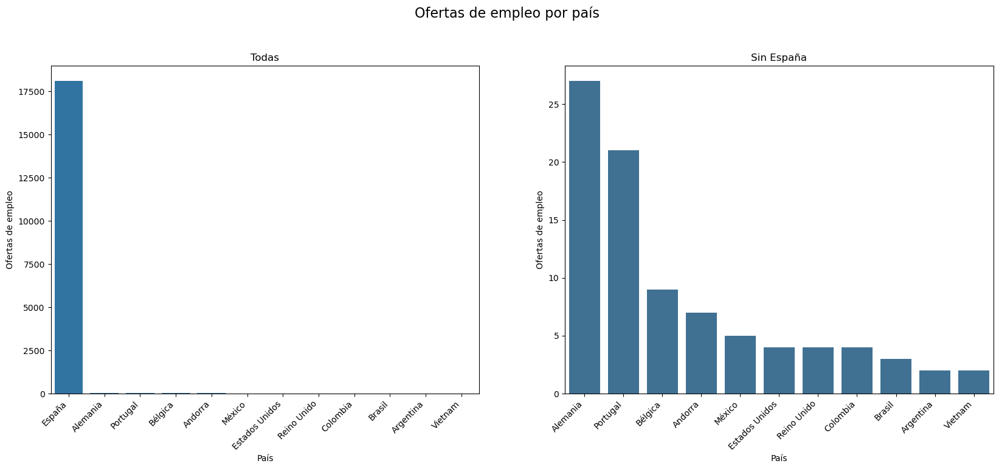

In [52]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df['pais'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['España']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('País')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Todas')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('País')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Sin España')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por país', fontsize=16, y=1.02)

plt.show()

### 2.8.2. Distribución de los empleos por comunidad autónoma

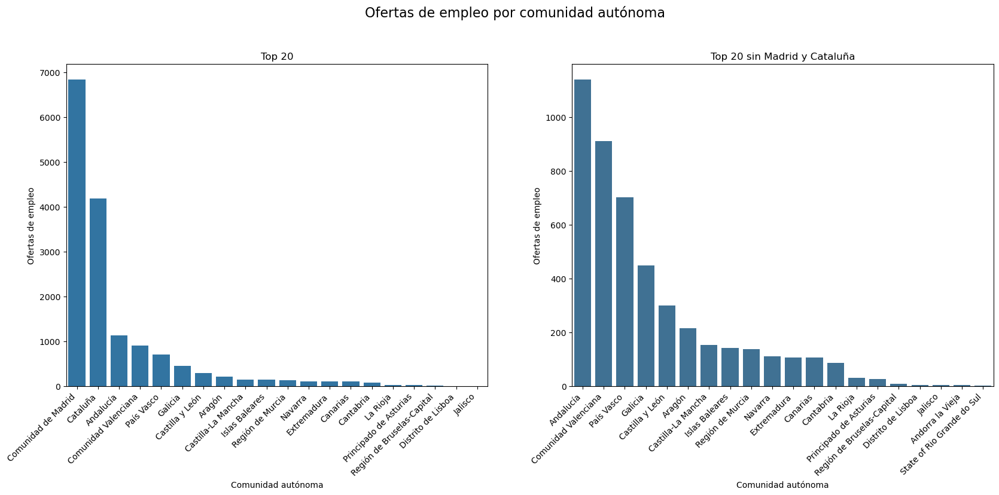

In [53]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df['comunidad'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['Comunidad de Madrid', 'Cataluña']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Comunidad autónoma')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Top 20')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('Comunidad autónoma')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Top 20 sin Madrid y Cataluña')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por comunidad autónoma', fontsize=16, y=1.02)


plt.show()

### 2.8.3. Distribución de los empleos por provincia

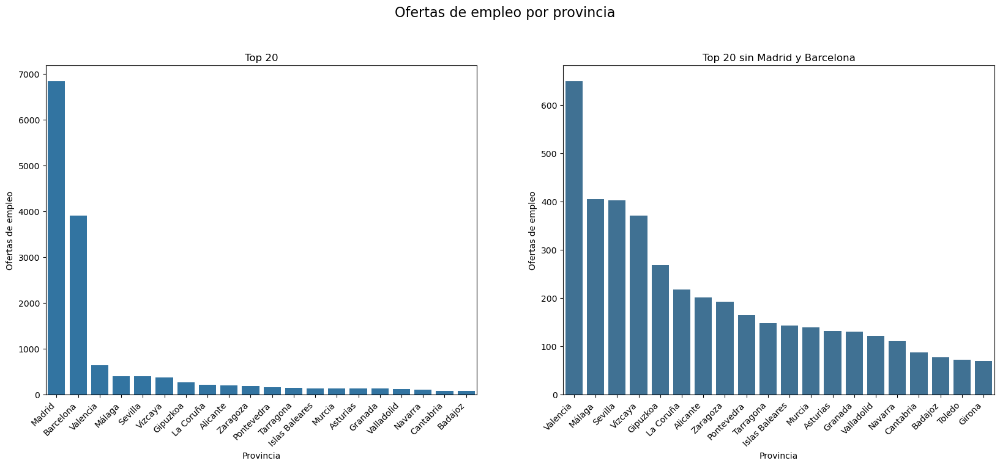

In [54]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df['provincia'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['Madrid', 'Barcelona']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Provincia')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Top 20')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('Provincia')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Top 20 sin Madrid y Barcelona')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por provincia', fontsize=16, y=1.02)


plt.show()

### 2.8.4. Distribución de los empleos por localidad

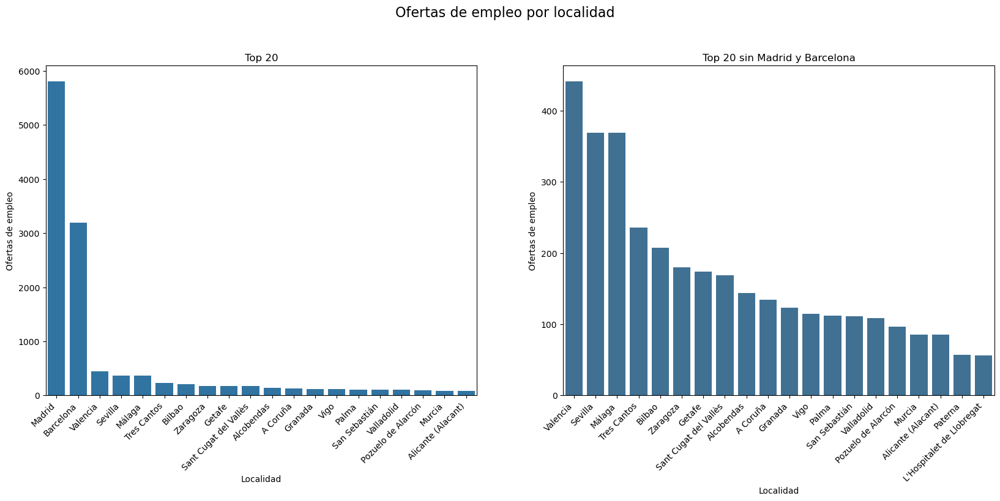

In [55]:
fig, axes = plt.subplots(1,2, figsize = (20,7))
axes = axes.flatten()
df_grafico = df['localidad'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['Madrid', 'Barcelona']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Localidad')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Top 20')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('Localidad')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Top 20 sin Madrid y Barcelona')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por localidad', fontsize=16, y=1.02)


plt.show()

## 2.9. Sector tecnológico y rol

### 2.9.1. Sector tecnológico 

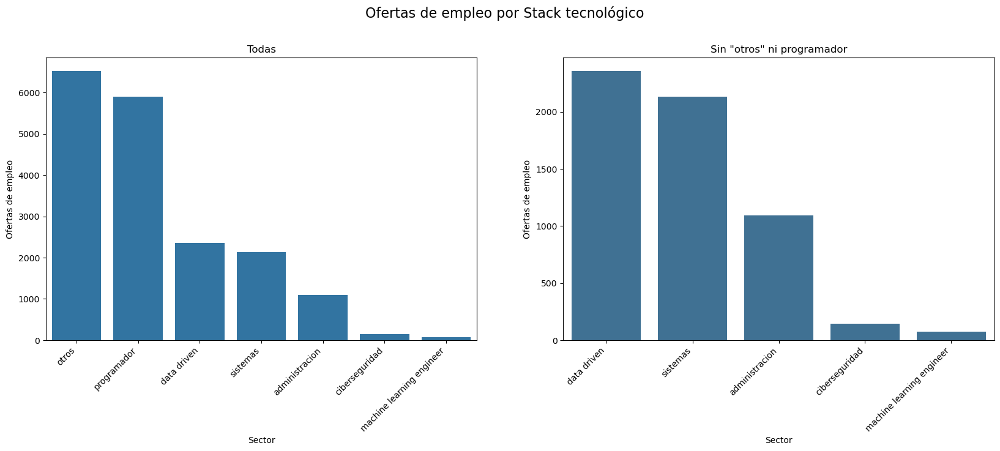

In [56]:
fig, axes = plt.subplots(1,2, figsize = (20,6))
axes = axes.flatten()
df_grafico = df['categoria_empleo'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['otros', 'programador']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Sector')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Todas')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('Sector')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Sin "otros" ni programador')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por Stack tecnológico', fontsize=16, y=1.02)

plt.show()

 ### 2.9.2. Rol

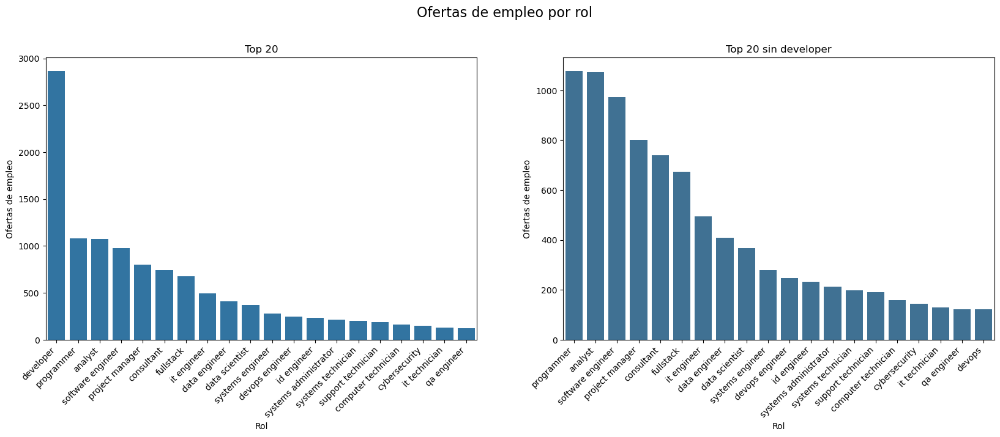

In [57]:
fig, axes = plt.subplots(1,2, figsize = (20,6))
axes = axes.flatten()
df_grafico = df['titulo'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['developer']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('Rol')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Top 20')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('Rol')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Top 20 sin developer')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por rol', fontsize=16, y=1.02)

plt.show()

# 3. Análisis bivariable

## 3.1. Stack Tecnológico - rol

### 3.1.1. Otros

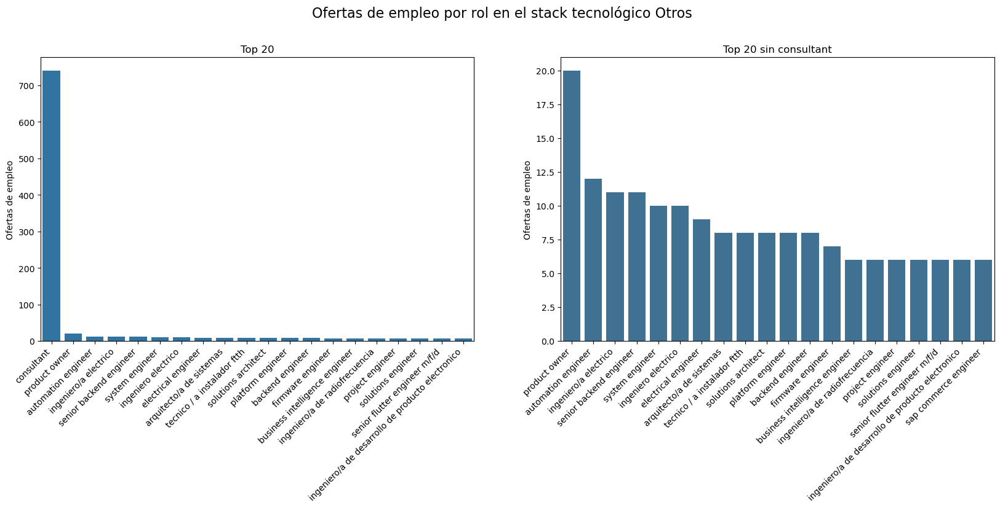

In [58]:
fig, axes = plt.subplots(1,2, figsize = (20,6))
axes = axes.flatten()
df_grafico = df[df['categoria_empleo'] == 'otros']['titulo'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['consultant']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Top 20')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Top 20 sin consultant')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por rol en el stack tecnológico Otros', fontsize=16, y=1.02)

plt.show()

### 3.1.2. Programador

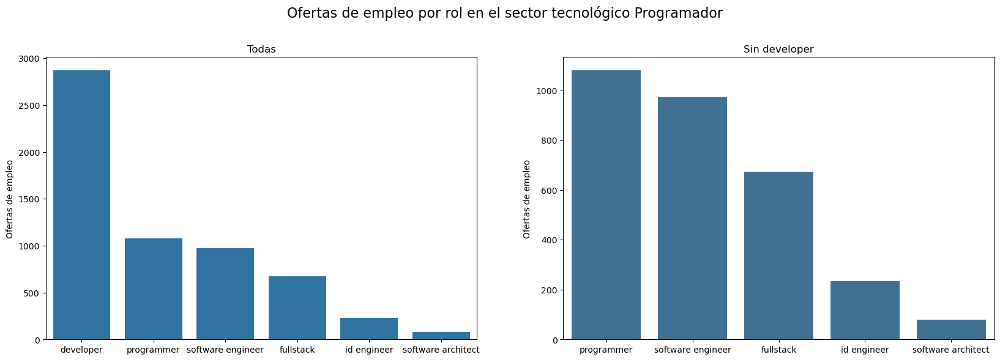

In [59]:
fig, axes = plt.subplots(1,2, figsize = (20,6))
axes = axes.flatten()
df_grafico = df[df['categoria_empleo'] == 'programador']['titulo'].value_counts()

sns.barplot(x=df_grafico.index, y=df_grafico.values, ax = axes[0])

categorias_a_eliminar = ['developer']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).index, y=df_grafico.drop(categorias_a_eliminar).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Todas')

axes[1].set_xlabel('')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Sin developer')

fig.suptitle('Ofertas de empleo por rol en el sector tecnológico Programador', fontsize=16, y=1.02)

plt.show()

### 3.1.3. Data driven

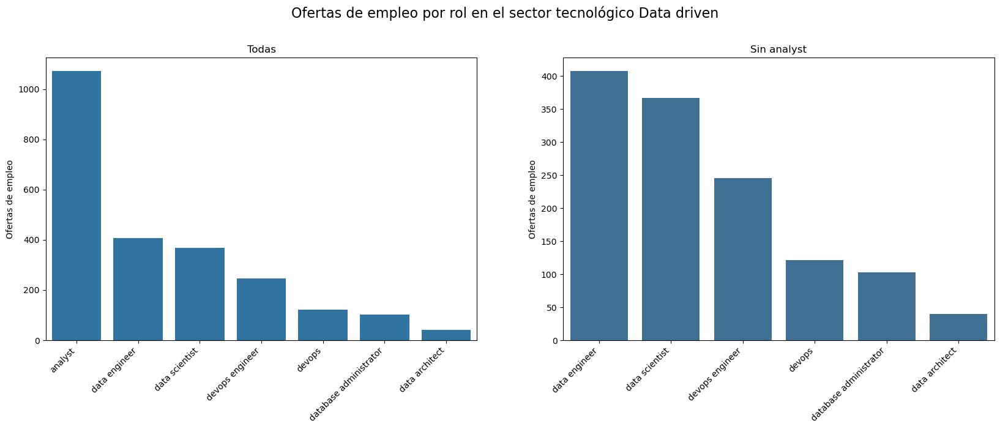

In [60]:
fig, axes = plt.subplots(1,2, figsize = (20,6))
axes = axes.flatten()
df_grafico = df[df['categoria_empleo'] == 'data driven']['titulo'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['analyst']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Todas')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Sin analyst')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por rol en el sector tecnológico Data driven', fontsize=16, y=1.02)

plt.show()

### 3.1.4. Sistemas

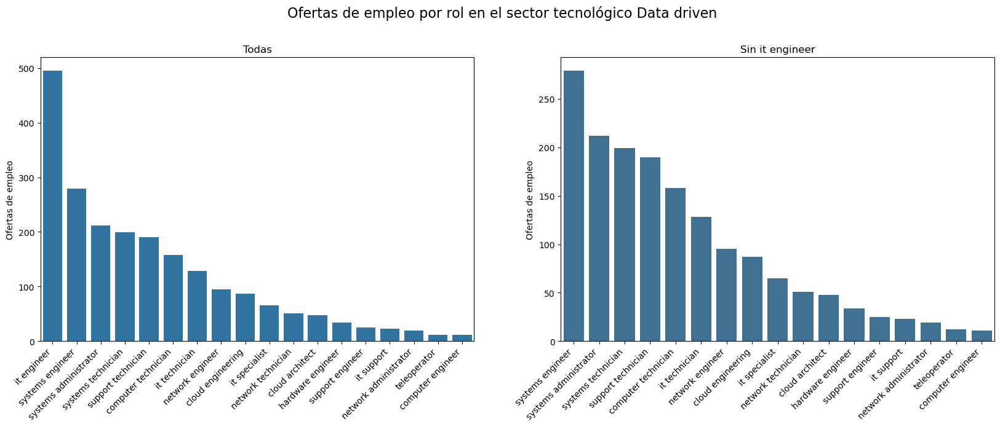

In [61]:
fig, axes = plt.subplots(1,2, figsize = (20,6))
axes = axes.flatten()
df_grafico = df[df['categoria_empleo'] == 'sistemas']['titulo'].value_counts()

sns.barplot(x=df_grafico.head(20).index, y=df_grafico.head(20).values, ax = axes[0])

categorias_a_eliminar = ['it engineer']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).head(20).index, y=df_grafico.drop(categorias_a_eliminar).head(20).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Todas')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

axes[1].set_xlabel('')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Sin it engineer')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

fig.suptitle('Ofertas de empleo por rol en el sector tecnológico Data driven', fontsize=16, y=1.02)

plt.show()

### 3.1.5. Administración

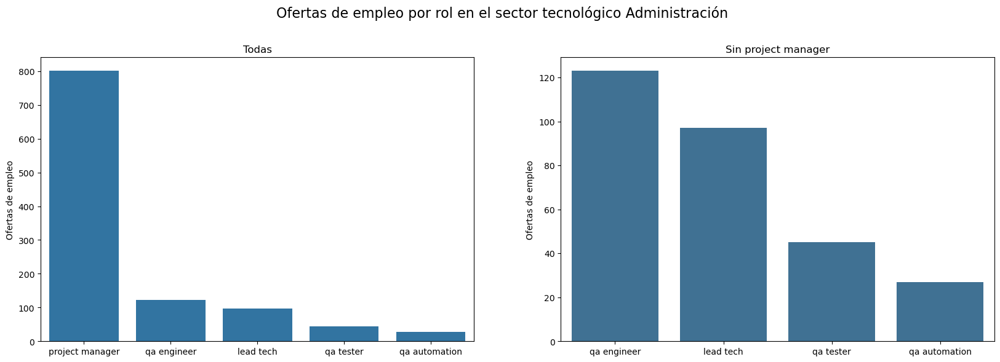

In [62]:
fig, axes = plt.subplots(1,2, figsize = (20,6))
axes = axes.flatten()
df_grafico = df[df['categoria_empleo'] == 'administracion']['titulo'].value_counts()

sns.barplot(x=df_grafico.index, y=df_grafico.values, ax = axes[0])

categorias_a_eliminar = ['project manager']
colores = [patch.get_facecolor() for patch in axes[0].patches[len(categorias_a_eliminar):]]

sns.barplot(x=df_grafico.drop(categorias_a_eliminar).index, y=df_grafico.drop(categorias_a_eliminar).values, palette = colores, ax = axes[1])

axes[0].set_xlabel('')
axes[0].set_ylabel('Ofertas de empleo')
axes[0].set_title(f'Todas')

axes[1].set_xlabel('')
axes[1].set_ylabel('Ofertas de empleo')
axes[1].set_title(f'Sin project manager')

fig.suptitle('Ofertas de empleo por rol en el sector tecnológico Administración', fontsize=16, y=1.02)

plt.show()

### 3.1.6. Ciberseguridad

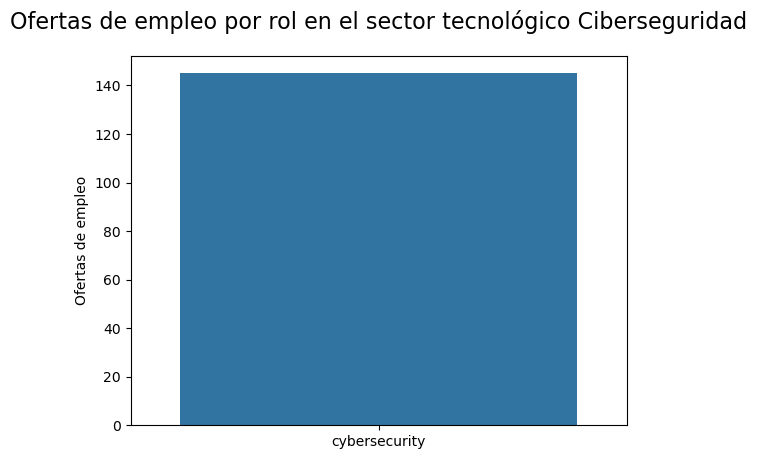

In [63]:
df_grafico = df[df['categoria_empleo'] == 'ciberseguridad']['titulo'].value_counts()

sns.barplot(x=df_grafico.index, y=df_grafico.values)

plt.xlabel('')
plt.ylabel('Ofertas de empleo')

plt.title('Ofertas de empleo por rol en el sector tecnológico Ciberseguridad', fontsize=16, y=1.05)

plt.show()

#### 3.1.7. Machine learning engineer

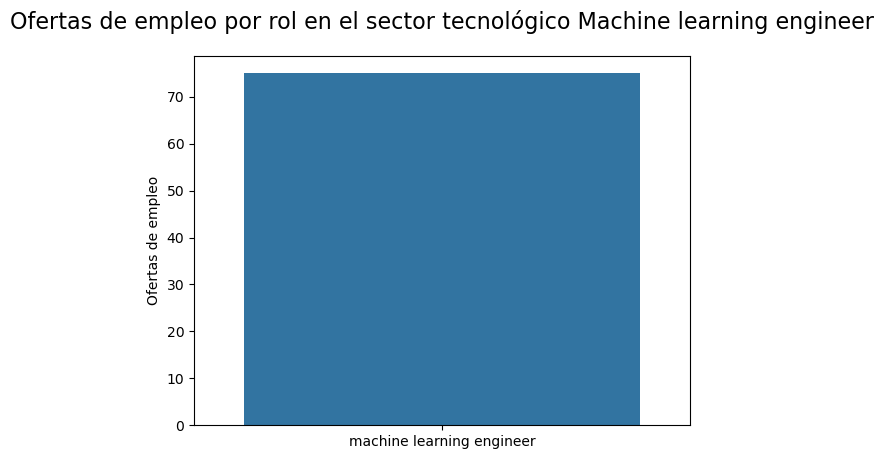

In [64]:
df_grafico = df[df['categoria_empleo'] == 'machine learning engineer']['titulo'].value_counts()

sns.barplot(x=df_grafico.index, y=df_grafico.values)

plt.xlabel('')
plt.ylabel('Ofertas de empleo')

plt.title('Ofertas de empleo por rol en el sector tecnológico Machine learning engineer', fontsize=16, y=1.05)

plt.show()

## 3.2. Herramientas - Sector tecnológico

In [65]:
grupos_categorias = df_herramientas_con_ingles.groupby('categoria_empleo')

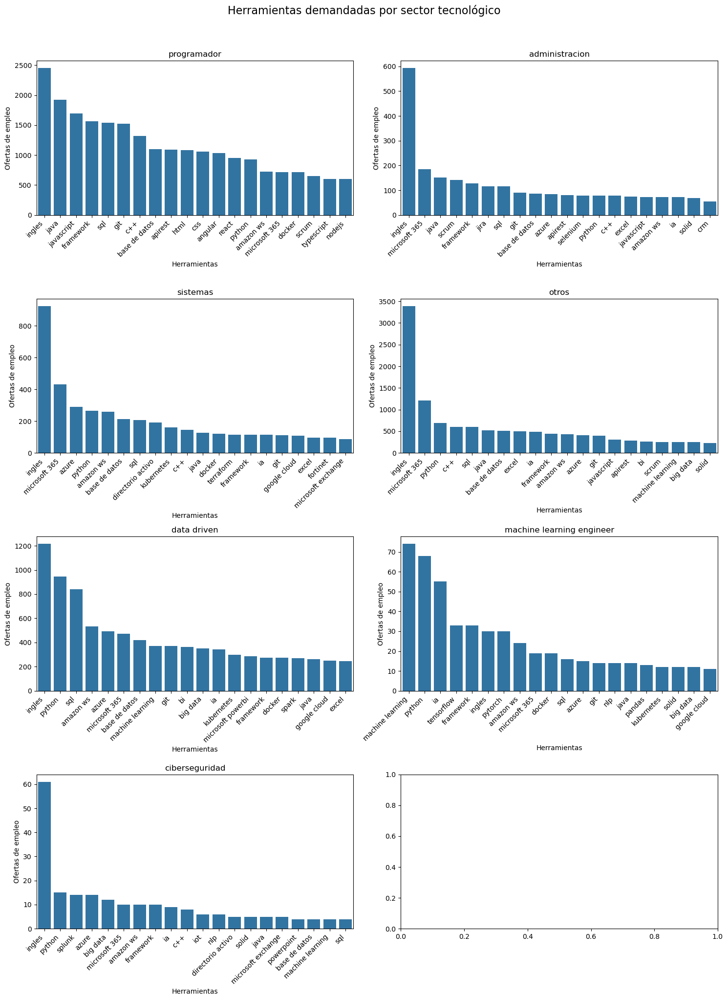

In [66]:
fig, axes = plt.subplots(4,2, figsize = (15, 20))
axes = axes.flatten()

for ax, categoria in zip(axes, categorias_empleo):
    df_grafico = grupos_categorias.get_group(categoria)
    valores = df_grafico[columnas_herramientas_con_ingles].sum().sort_values(ascending = False).head(20).reset_index()
    sns.barplot(x = valores['index'], y = valores[0], ax = ax)
    ax.set_xlabel('Herramientas')
    ax.set_ylabel('Ofertas de empleo')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.set_title(categoria)
    
fig.suptitle('Herramientas demandadas por sector tecnológico', fontsize=16, y=1.02)

plt.tight_layout()
plt.show()

- Vemos que el inglés realmente está demandado en todos los empleos, por lo que prescindiremos de él en el resto del análisis

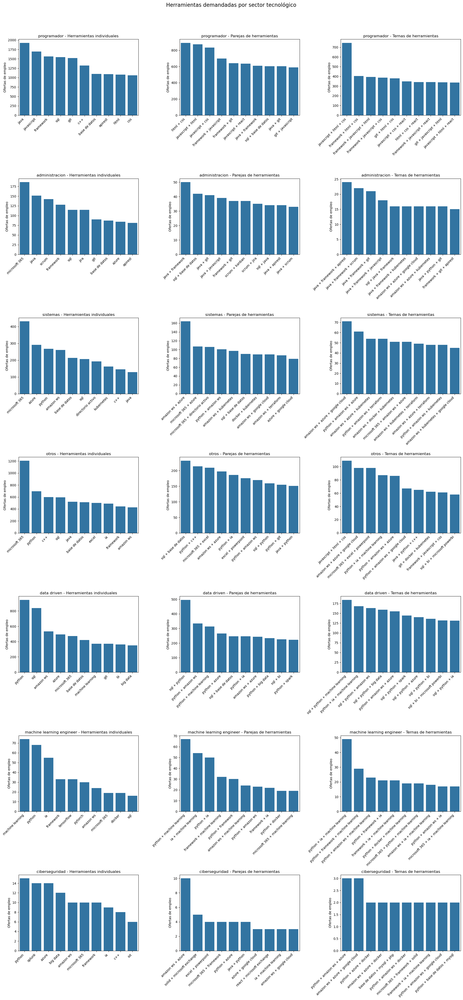

In [67]:
fig, axes = plt.subplots(len(categorias_empleo), 3, figsize = (20, 6 * len(categorias_empleo)))

grupos_categorias = df_herramientas.groupby('categoria_empleo')

for i, categoria in enumerate(categorias_empleo):
    df_grafico = grupos_categorias.get_group(categoria)

    valores = df_grafico[columnas_herramientas].sum().sort_values(ascending = False).reset_index().head(10)

    sns.barplot(x = valores['index'], y = valores[0], ax = axes[i,0])
    axes[i,0].set_xlabel('')
    axes[i,0].set_ylabel('Ofertas de empleo')
    axes[i,0].set_xticklabels(axes[i,0].get_xticklabels(), rotation=45, ha='right')
    axes[i,0].set_title(f'{categoria} - Herramientas individuales')

    valores = df_grafico[columnas_parejas_herramientas].sum().sort_values(ascending = False).reset_index().head(10)
    
    sns.barplot(x = valores['index'], y = valores[0], ax = axes[i,1])
    axes[i,1].set_xlabel('')
    axes[i,1].set_ylabel('Ofertas de empleo')
    axes[i,1].set_xticklabels(axes[i,1].get_xticklabels(), rotation=45, ha='right')
    axes[i,1].set_title(f'{categoria} - Parejas de herramientas')
    
    valores = df_grafico[columnas_ternas_herramientas].sum().sort_values(ascending = False).reset_index().head(10)
    
    sns.barplot(x = valores['index'], y = valores[0], ax = axes[i,2])
    axes[i,2].set_xlabel('')
    axes[i,2].set_ylabel('Ofertas de empleo')
    axes[i,2].set_xticklabels(axes[i,2].get_xticklabels(), rotation=45, ha='right')
    axes[i,2].set_title(f'{categoria} - Ternas de herramientas')
    
fig.suptitle('Herramientas demandadas por sector tecnológico', fontsize=16, y=1.02)

plt.tight_layout()
plt.show()
plt.show()

In [68]:
#hacemos OneHotEncoding con las categorias de empleo
df_herramientas_categoria = pd.get_dummies(df_herramientas, columns=['categoria_empleo'], prefix = 'sector', prefix_sep = '_', dtype = int)

columnas_categorias_empleo = ['sector_' + empleo for empleo in categorias_empleo]

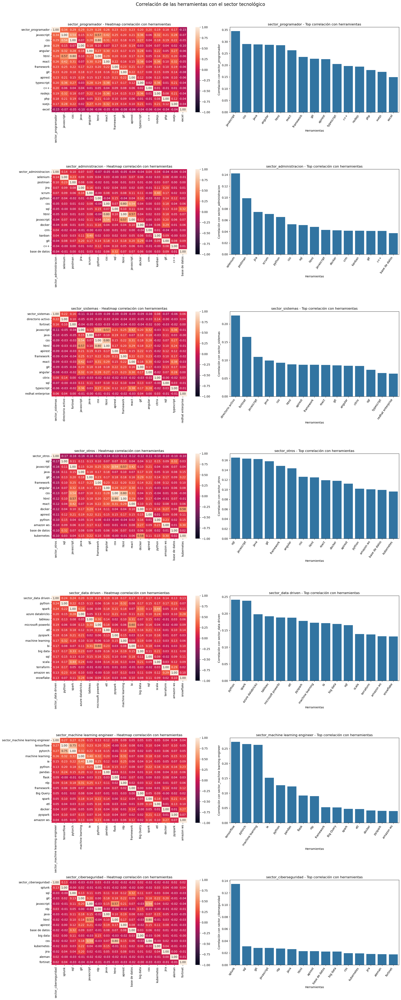

In [69]:
fig, axes = plt.subplots(len(columnas_categorias_empleo), 2, figsize=(20, 7 * len(columnas_categorias_empleo)))

for i, categoria in enumerate(columnas_categorias_empleo):
    matriz_correlacion = df_herramientas_categoria[columnas_herramientas + [categoria]].corr()
    top_15_herramientas_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)
    
    # Plot del heatmap
    sns.heatmap(df_herramientas_categoria[top_15_herramientas_mayor_correlacion.index].corr(), vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap correlación con herramientas')
    
    # Plot del barplot
    top_15_herramientas_mayor_correlacion = top_15_herramientas_mayor_correlacion.drop(categoria)
    sns.barplot(x=top_15_herramientas_mayor_correlacion.index, y=top_15_herramientas_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel('Herramientas')
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Top correlación con herramientas')
    
fig.suptitle('Correlación de las herramientas con el sector tecnológico', fontsize=16, y=1.01)

    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

## 3.3. Herramientas - Experiencia

In [70]:
df_herramientas_experiencia = df_herramientas.copy()

df_herramientas_experiencia = df_herramientas_experiencia.dropna(subset = 'experiencia')

df_herramientas_experiencia['rango'] = df_herramientas_experiencia['experiencia'].apply(intervalo_experiencia)

In [71]:
#Datos a tratar
df_normalizar = df_herramientas_experiencia.copy()

columnas_iterar = columnas_intervalos_salariales

columna_groupby = 'rango'

#Caracteristicas grafico
variable = 'experiencia'

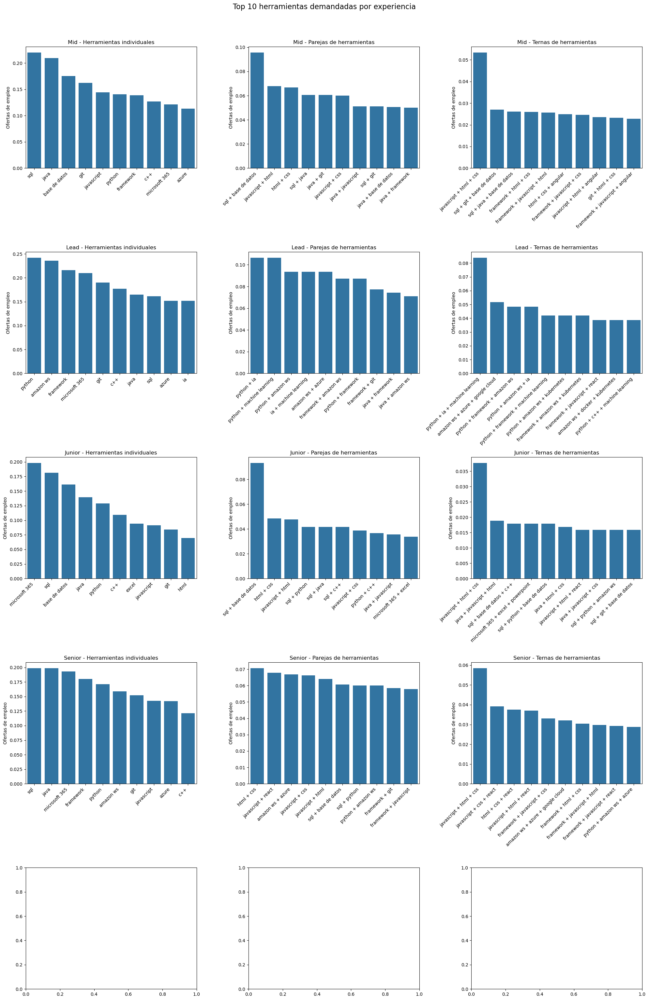

In [72]:
fig, axes = plt.subplots(len(columnas_iterar), 3, figsize = (20, 6 * len(columnas_iterar)))

grupos_categorias = df_normalizar.groupby(columna_groupby)
columnas = df_normalizar[columna_groupby].unique()

for i, categoria in enumerate(columnas):
    df_grafico = grupos_categorias.get_group(categoria)

    # Seleccionar las herramientas que aparecen al menos un 0.5% de las veces (True <= 10)
    conteo_true = df_grafico[columnas_herramientas].mean()
    columnas_a_eliminar = conteo_true[conteo_true < 0.005].index

    # Eliminar las columnas seleccionadas del DataFrame
    df_grafico = df_grafico.drop(columns=columnas_a_eliminar)
    columnas_herramientas_categoria = list(set(columnas_herramientas).intersection(set(df_grafico.columns)))
    
    valores = df_grafico[columnas_herramientas_categoria].mean().sort_values(ascending = False).reset_index()
    
    sns.barplot(x = valores['index'].head(10), y = valores[0].head(10), ax = axes[i,0])
    axes[i,0].set_xlabel('')
    axes[i,0].set_ylabel('Ofertas de empleo')
    axes[i,0].set_xticklabels(axes[i,0].get_xticklabels(), rotation=45, ha='right')
    axes[i,0].set_title(f'{categoria} - Herramientas individuales')


    valores = df_grafico[columnas_parejas_herramientas].mean().sort_values(ascending = False).reset_index().head(10)
    
    sns.barplot(x = valores['index'], y = valores[0], ax = axes[i,1])
    axes[i,1].set_xlabel('')
    axes[i,1].set_ylabel('Ofertas de empleo')
    axes[i,1].set_xticklabels(axes[i,1].get_xticklabels(), rotation=45, ha='right')
    axes[i,1].set_title(f'{categoria} - Parejas de herramientas')
    
    valores = df_grafico[columnas_ternas_herramientas].mean().sort_values(ascending = False).reset_index().head(10)
    
    sns.barplot(x = valores['index'], y = valores[0], ax = axes[i,2])
    axes[i,2].set_xlabel('')
    axes[i,2].set_ylabel('Ofertas de empleo')
    axes[i,2].set_xticklabels(axes[i,2].get_xticklabels(), rotation=45, ha='right')
    axes[i,2].set_title(f'{categoria} - Ternas de herramientas')
    
fig.suptitle(f'Top 10 herramientas demandadas por {variable}', fontsize=16, y=1.02)

plt.tight_layout()
plt.show()
plt.show()

## 3.4. Herramientas - Comunidades

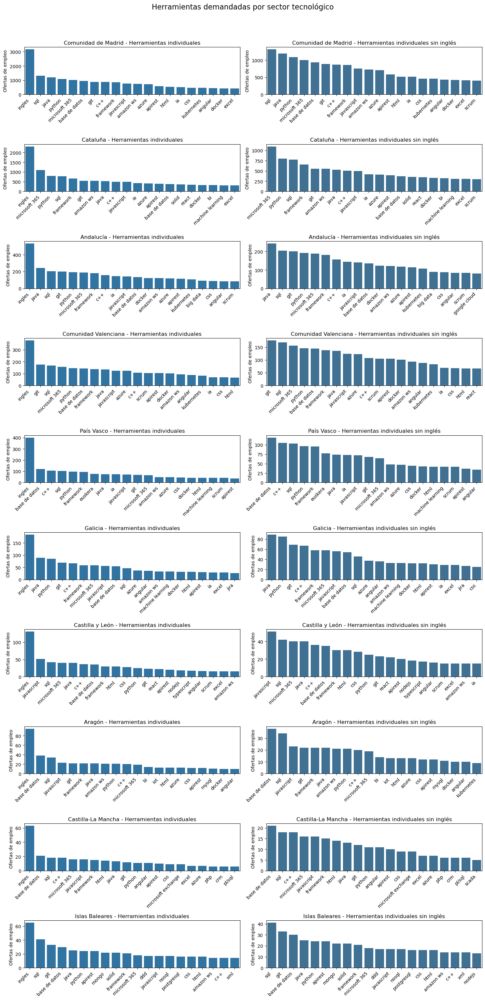

In [73]:
comunidades_top_10 = df_herramientas_con_ingles['comunidad'].value_counts().head(10).index

fig, axes = plt.subplots(len(comunidades_top_10),2, figsize = (15, 30))

grupos_categorias = df_herramientas_con_ingles.groupby('comunidad')

for i, categoria in enumerate(comunidades_top_10):
    df_grafico = grupos_categorias.get_group(categoria)
    
    # Seleccionar las herramientas que aparecen al menos un 0.5% de las veces (True <= 10)
    conteo_true = df_grafico[columnas_herramientas_con_ingles].mean()
    columnas_a_eliminar = conteo_true[conteo_true < 0.005].index

    # Eliminar las columnas seleccionadas del DataFrame
    df_grafico = df_grafico.drop(columns=columnas_a_eliminar)
    columnas_herramientas_categoria = list(set(columnas_herramientas_con_ingles).intersection(set(df_grafico.columns))) 
    
    valores = df_grafico[columnas_herramientas_categoria].sum().sort_values(ascending = False)

    sns.barplot(x = valores.head(20).index, y = valores.head(20).values, ax = axes[i,0])
    axes[i,0].set_xlabel('')
    axes[i,0].set_ylabel('Ofertas de empleo')
    axes[i,0].set_xticklabels(axes[i,0].get_xticklabels(), rotation=45, ha='right')
    axes[i,0].set_title(f'{categoria} - Herramientas individuales')
    
    categorias_a_eliminar = ['ingles']
    colores = [patch.get_facecolor() for patch in axes.flatten()[0].patches[len(categorias_a_eliminar):]]
    
    sns.barplot(x = valores.drop('ingles').head(20).index, y = valores.drop('ingles').head(20).values, palette = colores, ax = axes[i,1])
    axes[i,1].set_xlabel('')
    axes[i,1].set_ylabel('Ofertas de empleo')
    axes[i,1].set_xticklabels(axes[i,1].get_xticklabels(), rotation=45, ha='right')
    axes[i,1].set_title(f'{categoria} - Herramientas individuales sin inglés')

        
fig.suptitle('Herramientas demandadas por sector tecnológico', fontsize=16, y=1.02)

plt.tight_layout()
plt.show()
plt.show()
plt.show()

## 3.5. Herramientas - Salario

In [74]:
df_herramientas_salarios = pd.merge(left = df_herramientas, right = df_salarios, on = df.columns.drop('herramientas').tolist())

In [75]:
#Datos a tratar
df_normalizar = df_herramientas_salarios.copy()

columnas_normalizar = columnas_herramientas

columnas_iterar = columnas_intervalos_salariales

columna_groupby = 'intervalo_salarial_medio'

#Caracteristicas grafico
variable = 'herramientas'

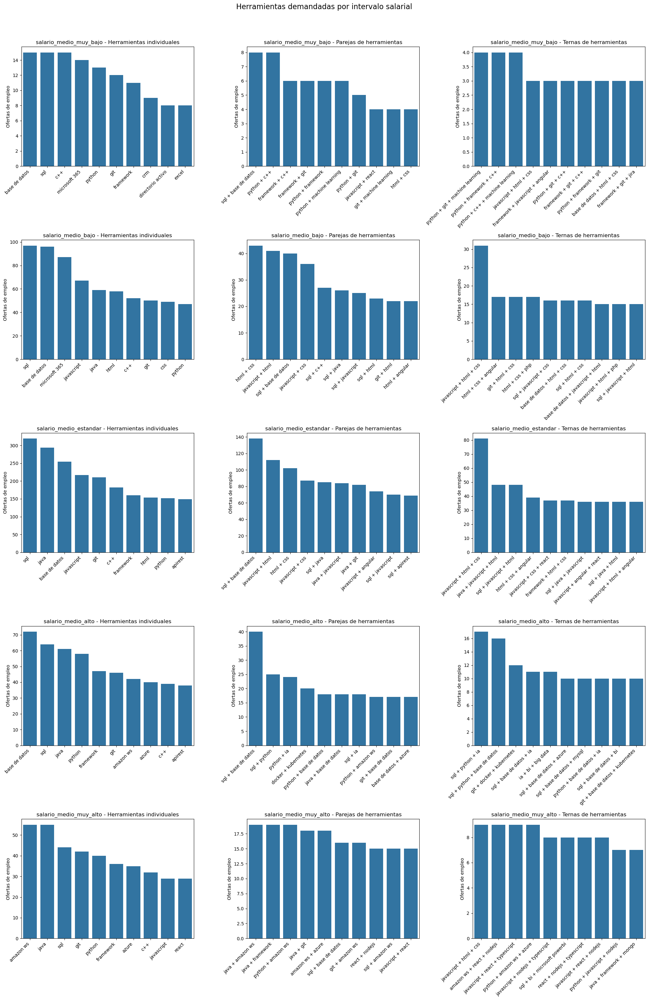

In [76]:
fig, axes = plt.subplots(len(columnas_iterar), 3, figsize = (20, 6 * len(columnas_iterar)))

grupos_categorias = df_normalizar.groupby(columna_groupby)

for i, categoria in enumerate(columnas_iterar):
    df_grafico = grupos_categorias.get_group(categoria)

    valores = df_grafico[columnas_herramientas].sum().sort_values(ascending = False).reset_index().head(10)

    sns.barplot(x = valores['index'], y = valores[0], ax = axes[i,0])
    axes[i,0].set_xlabel('')
    axes[i,0].set_ylabel('Ofertas de empleo')
    axes[i,0].set_xticklabels(axes[i,0].get_xticklabels(), rotation=45, ha='right')
    axes[i,0].set_title(f'{categoria} - Herramientas individuales')

    valores = df_grafico[columnas_parejas_herramientas].sum().sort_values(ascending = False).reset_index().head(10)
    
    sns.barplot(x = valores['index'], y = valores[0], ax = axes[i,1])
    axes[i,1].set_xlabel('')
    axes[i,1].set_ylabel('Ofertas de empleo')
    axes[i,1].set_xticklabels(axes[i,1].get_xticklabels(), rotation=45, ha='right')
    axes[i,1].set_title(f'{categoria} - Parejas de herramientas')
    
    valores = df_grafico[columnas_ternas_herramientas].sum().sort_values(ascending = False).reset_index().head(10)
    
    sns.barplot(x = valores['index'], y = valores[0], ax = axes[i,2])
    axes[i,2].set_xlabel('')
    axes[i,2].set_ylabel('Ofertas de empleo')
    axes[i,2].set_xticklabels(axes[i,2].get_xticklabels(), rotation=45, ha='right')
    axes[i,2].set_title(f'{categoria} - Ternas de herramientas')
    
fig.suptitle('Herramientas demandadas por intervalo salarial', fontsize=16, y=1.02)

plt.tight_layout()
plt.show()
plt.show()

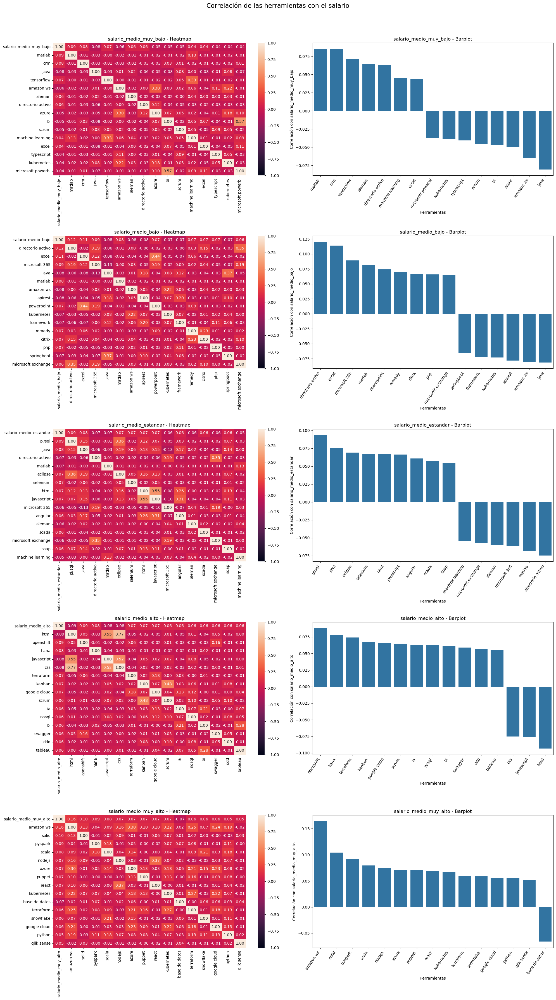

In [77]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):

    matriz_correlacion = df_herramientas_salarios[columnas_normalizar + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)
    
    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de las {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

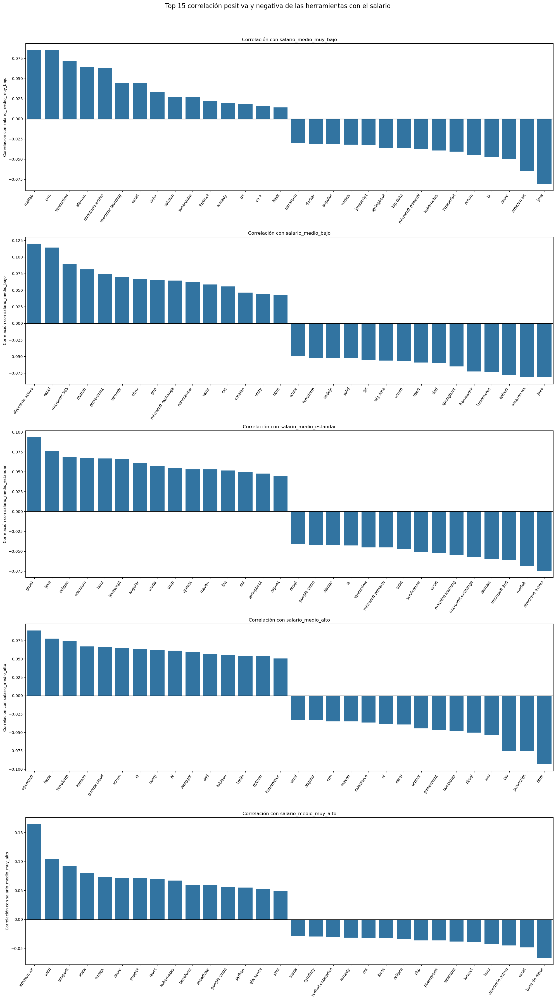

In [78]:
fig, axes = plt.subplots(len(columnas_iterar), figsize=(20, 7 * len(columnas_iterar)))

axes = axes.flatten()

for ax, categoria in zip(axes, columnas_iterar):
    df_grafico = df_normalizar
    
    matriz_correlacion = df_grafico[columnas_normalizar + [categoria]].corr()
    df_correlaciones = matriz_correlacion[categoria].reset_index()
    top_15_correlacion_positiva = df_correlaciones[(df_correlaciones[categoria] > 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).head(15)
    top_15_correlacion_negativa = df_correlaciones[(df_correlaciones[categoria] < 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).tail(15)
    df_grafico = pd.concat([top_15_correlacion_positiva, top_15_correlacion_negativa])
    
    # Plot del barplot
    sns.barplot(data=df_grafico, x='index', y=categoria, ax=ax)
    ax.set_xlabel('')
    ax.set_ylabel(f'Correlación con {categoria}')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=55, ha='right')
    ax.set_title(f'Correlación con {categoria}')
    
    # Ajustes para mover el eje x por debajo del valor mínimo en el eje y
    ax.axhline(y=0, color="black", linewidth=1)
    
fig.suptitle(f'Top 15 correlación positiva y negativa de las {variable} con el salario', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

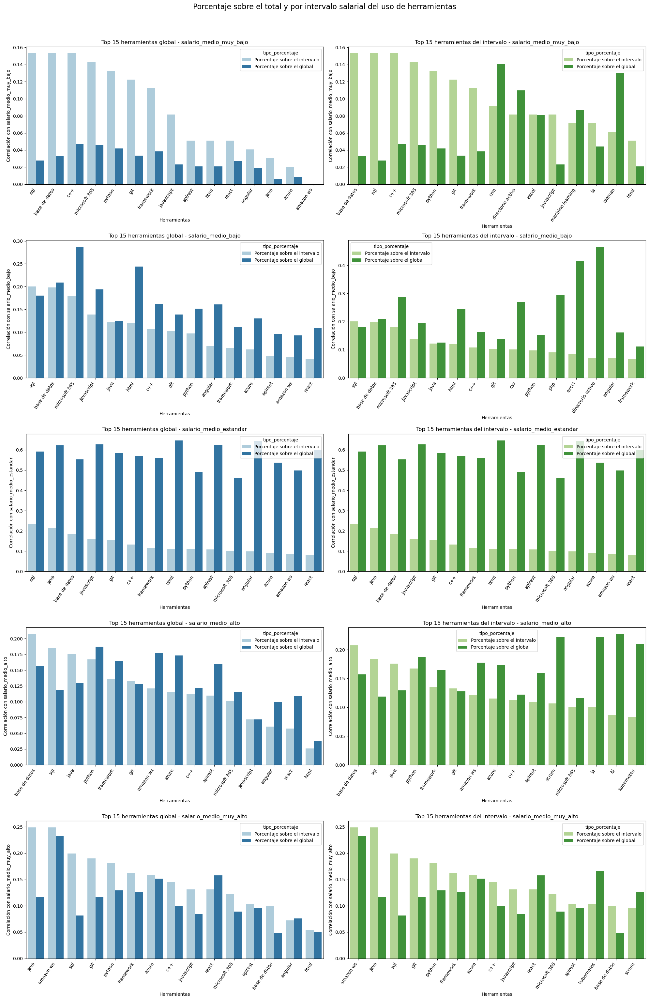

In [79]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 6 * len(columnas_iterar)))

top_15_herramientas = df_normalizar[columnas_normalizar].sum().sort_values(ascending = False).head(15)
df_temp_1 = df_normalizar[top_15_herramientas.index.tolist() + columnas_intervalos_salariales]

for i, categoria in enumerate(columnas_iterar):
    
    top_15_herramientas_categoria = df_normalizar[df_normalizar[categoria] == 1][columnas_normalizar].sum().sort_values(ascending = False).head(15)
    df_temp_2 = df_normalizar[top_15_herramientas_categoria.index.tolist() + columnas_intervalos_salariales]
    
    #Creamos el df del primer grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].mean().values
    porcentaje_top_total_global = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].sum().values / top_15_herramientas.values    

    dic_1 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired"), ax=axes[i, 0])
    axes[i, 0].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 0].set_ylabel(f'Correlación con {categoria}')
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=55, ha='right')
    axes[i, 0].set_title(f'Top 15 herramientas global - {categoria}')

    #Creamos el df del segundo grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas_categoria.index].mean().values
    porcentaje_top_total_global = top_15_herramientas_categoria.values / df_normalizar[top_15_herramientas_categoria.index].sum().values

    dic_1 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired")[2:], ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'Top 15 herramientas del intervalo - {categoria}')
    
fig.suptitle(f'Porcentaje sobre el total y por intervalo salarial del uso de herramientas', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

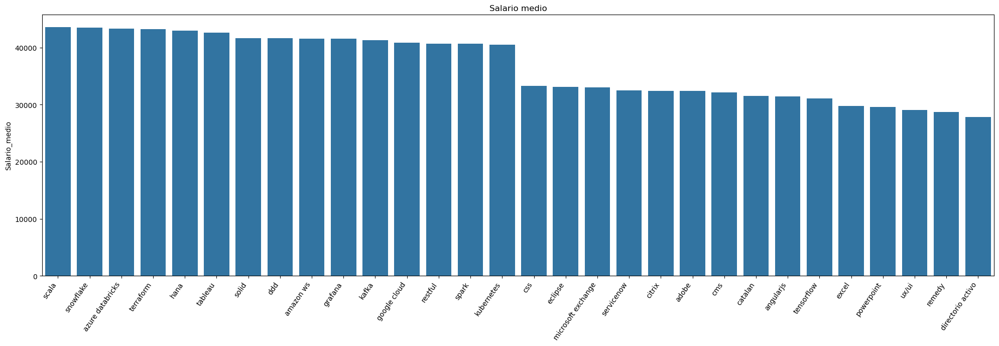

In [80]:
plt.figure(figsize=(20, 7))

df_grafico = df_normalizar.copy()

# Seleccionar las herramientas que aparecen al menos un 0.5% de las veces 
conteo_true = df_grafico[columnas_herramientas].mean()
columnas_normalizar = conteo_true[conteo_true > 0.005].index.tolist()

df_grafico = cambiar_bool_por_salario(df_normalizar, 'salario_medio', columnas_normalizar)[['salario_medio'] + columnas_normalizar]

salario_variable = df_grafico.replace(0, np.nan).mean().dropna().drop('salario_medio').astype(int).round(-1).sort_values(ascending = False)

top_15_salario_variable = salario_variable.head(15)
antitop_15_salario_variable = salario_variable.tail(15)

df_grafico = pd.concat([top_15_salario_variable, antitop_15_salario_variable]).reset_index(name = 'salario_medio')

# Plot del barplot
sns.barplot(data=df_grafico, x='index', y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')
plt.title(f'Salario medio')

fig.suptitle(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

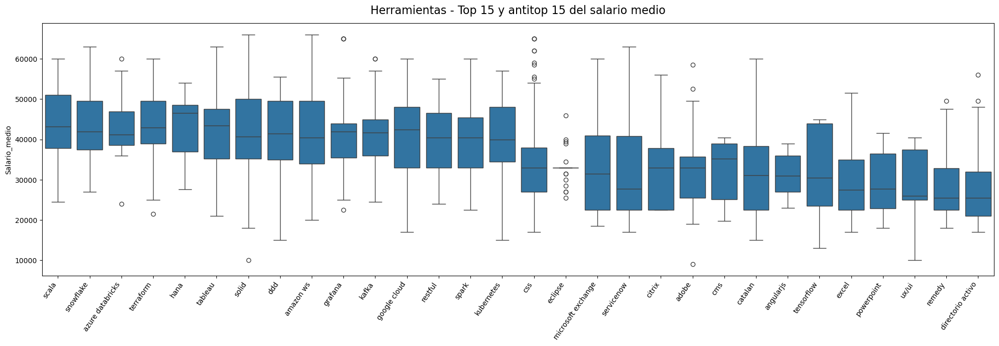

In [81]:
plt.figure(figsize=(20, 7))

df_grafico = df_normalizar.copy()

# Seleccionar las herramientas que aparecen al menos un 0.5% de las veces 
conteo_true = df_grafico[columnas_normalizar].mean()
columnas_normalizar = conteo_true[conteo_true > 0.005].index.tolist()

df_grafico = cambiar_bool_por_salario(df_normalizar, 'salario_medio', columnas_normalizar)[['salario_medio'] + columnas_normalizar]

salario_variable = df_grafico.replace(0, np.nan).mean().dropna().drop('salario_medio').astype(int).round(-1).sort_values(ascending = False)

top_15_salario_variable = salario_variable.head(15).index.tolist()
antitop_15_salario_variable = salario_variable.tail(15).index.tolist()

df_selected = df_herramientas_salarios[top_15_salario_variable + antitop_15_salario_variable + ['salario_medio']]

# Melt para convertir las columnas booleanas en una sola columna 'variable_categorica'
df_melted = pd.melt(df_selected, id_vars=['salario_medio'], var_name=variable, value_name='valor_booleano')

# Filtrar solo las filas con valor True en las columnas booleanas y ordenamos por media de salario
df_grafico = df_melted[df_melted['valor_booleano'] == True]

# Plot del boxplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

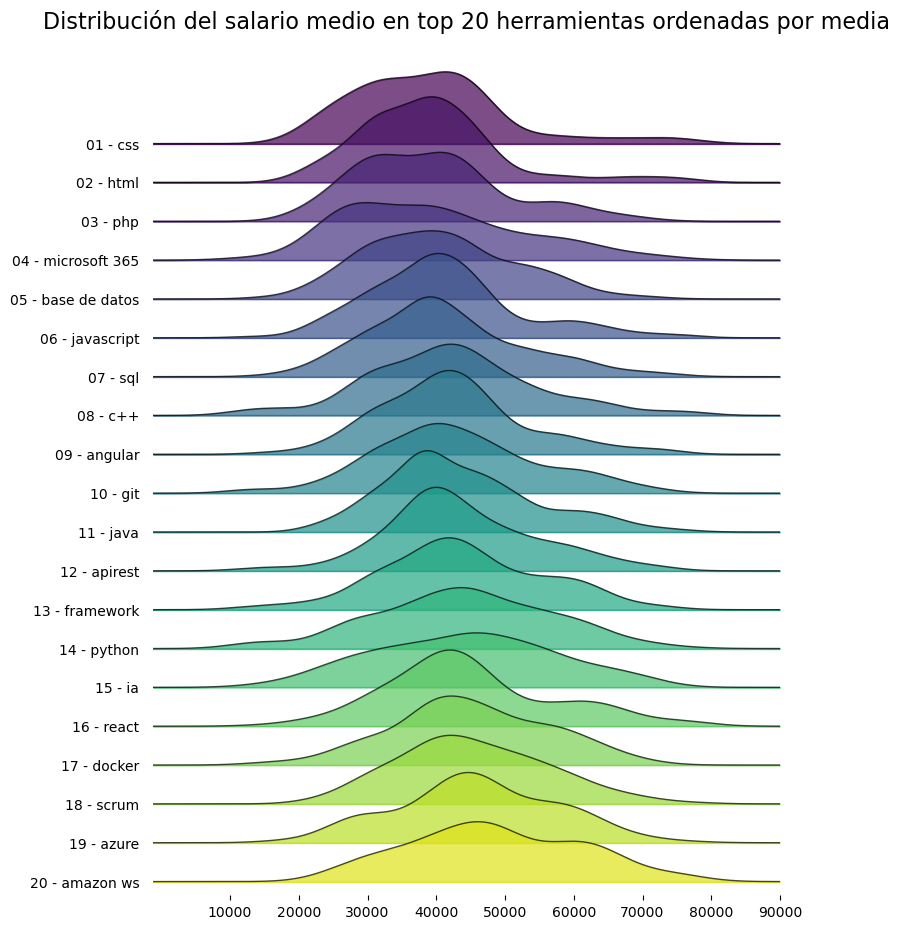

In [82]:
#Definimos el df y la variable

top_15_herramientas = df_herramientas_salarios[columnas_herramientas].sum().sort_values(ascending = False).head(20)
df_top_15_herramientas_salarios = df_herramientas_salarios[top_15_herramientas.index.tolist() + ['salario_medio']]

df_selected = df_top_15_herramientas_salarios[['salario_medio'] + top_15_herramientas.index.tolist()]

# Melt para convertir las columnas booleanas en una sola columna 'variable_categorica'
df_melted = pd.melt(df_selected, id_vars=['salario_medio'], var_name='herramienta', value_name='valor_booleano')

# Filtrar solo las filas con valor True en las columnas booleanas y ordenamos por media de salario
df_grafico = df_melted[df_melted['valor_booleano'] == True]
variable = 'herramienta'
titulo = 'herramientas'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en top 20 {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

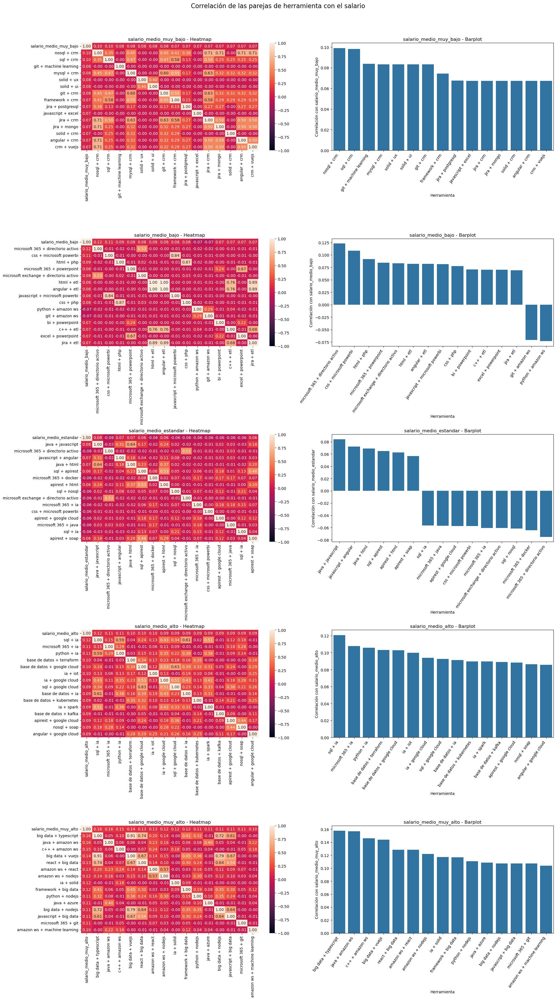

In [83]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):

    matriz_correlacion = df_herramientas_salarios[columnas_parejas_herramientas + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)
    
    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de las parejas de {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

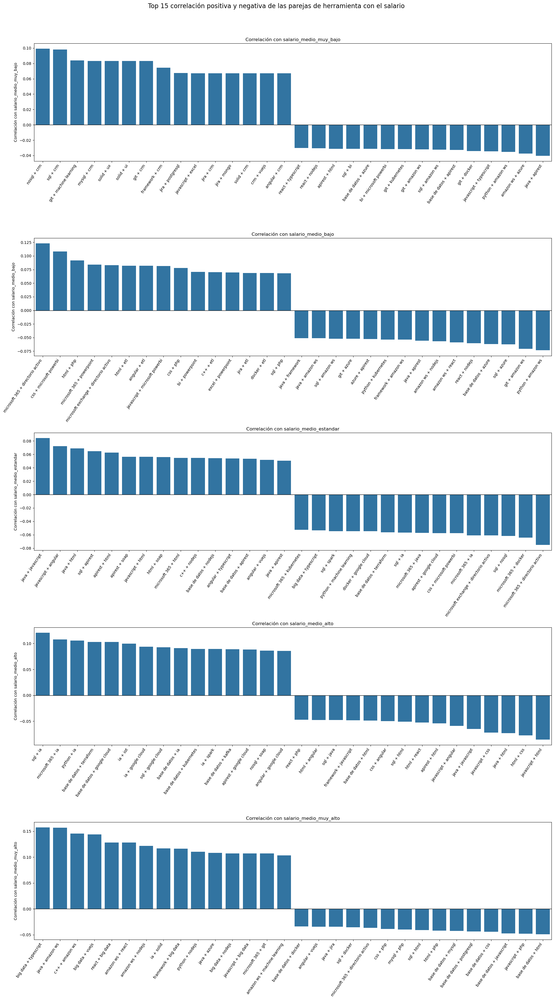

In [84]:
fig, axes = plt.subplots(len(columnas_iterar), figsize=(20, 7 * len(columnas_iterar)))

axes = axes.flatten()

for ax, categoria in zip(axes, columnas_iterar):
    df_grafico = df_normalizar
    
    matriz_correlacion = df_grafico[columnas_parejas_herramientas + [categoria]].corr()
    df_correlaciones = matriz_correlacion[categoria].reset_index()
    top_15_correlacion_positiva = df_correlaciones[(df_correlaciones[categoria] > 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).head(15)
    top_15_correlacion_negativa = df_correlaciones[(df_correlaciones[categoria] < 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).tail(15)
    df_grafico = pd.concat([top_15_correlacion_positiva, top_15_correlacion_negativa])
    
    # Plot del barplot
    sns.barplot(data=df_grafico, x='index', y=categoria, ax=ax)
    ax.set_xlabel('')
    ax.set_ylabel(f'Correlación con {categoria}')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=55, ha='right')
    ax.set_title(f'Correlación con {categoria}')
    
    # Ajustes para mover el eje x por debajo del valor mínimo en el eje y
    ax.axhline(y=0, color="black", linewidth=1)
    
fig.suptitle(f'Top 15 correlación positiva y negativa de las parejas de {variable} con el salario', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

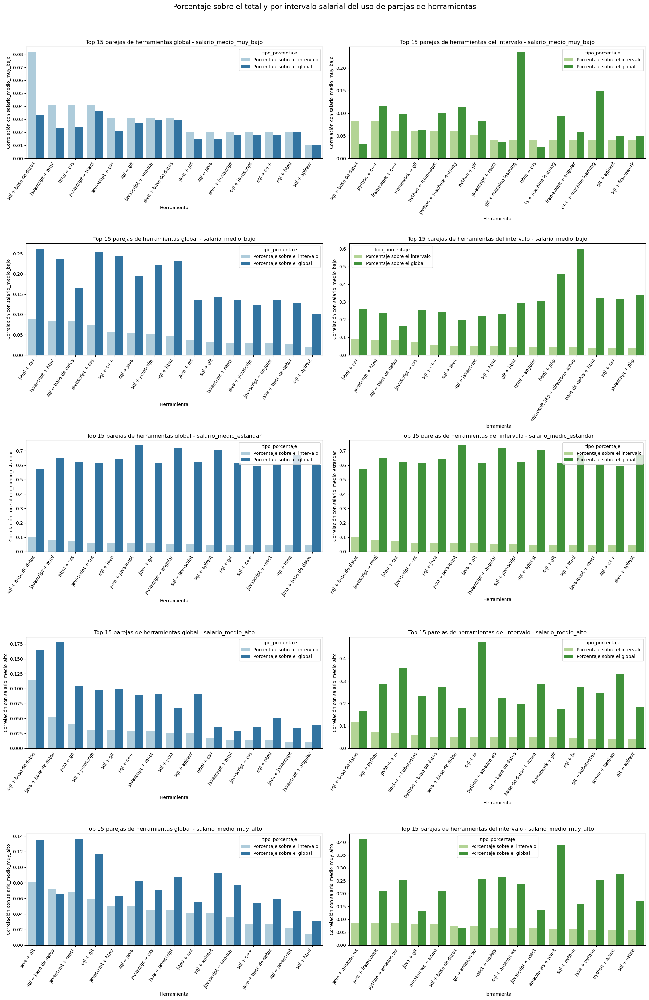

In [85]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 6 * len(columnas_iterar)))

top_15_herramientas = df_normalizar[columnas_parejas_herramientas].sum().sort_values(ascending = False).head(15)
df_temp_1 = df_normalizar[top_15_herramientas.index.tolist() + columnas_intervalos_salariales]

for i, categoria in enumerate(columnas_iterar):
    
    top_15_herramientas_categoria = df_normalizar[df_normalizar[categoria] == 1][columnas_parejas_herramientas].sum().sort_values(ascending = False).head(15)
    df_temp_2 = df_normalizar[top_15_herramientas_categoria.index.tolist() + columnas_intervalos_salariales]
    
    #Creamos el df del primer grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].mean().values
    porcentaje_top_total_global = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].sum().values / top_15_herramientas.values    

    dic_1 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired"), ax=axes[i, 0])
    axes[i, 0].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 0].set_ylabel(f'Correlación con {categoria}')
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=55, ha='right')
    axes[i, 0].set_title(f'Top 15 parejas de herramientas global - {categoria}')

    #Creamos el df del segundo grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas_categoria.index].mean().values
    porcentaje_top_total_global = top_15_herramientas_categoria.values / df_normalizar[top_15_herramientas_categoria.index].sum().values

    dic_1 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired")[2:], ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'Top 15 parejas de herramientas del intervalo - {categoria}')
    
fig.suptitle(f'Porcentaje sobre el total y por intervalo salarial del uso de parejas de herramientas', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

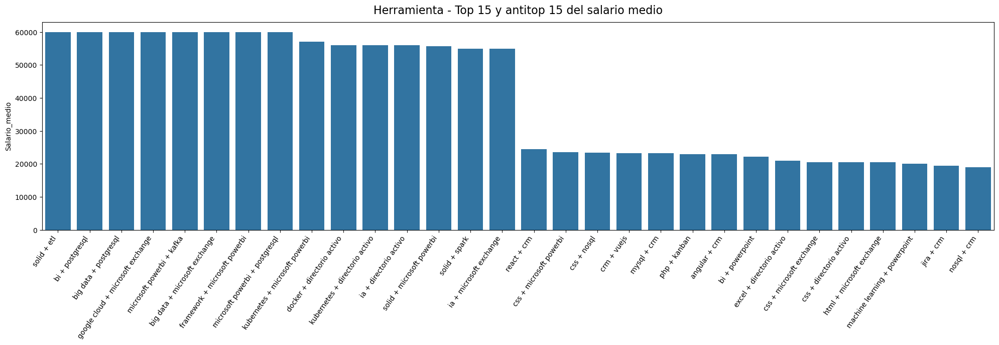

In [86]:
plt.figure(figsize=(20, 7))

df_grafico = df_normalizar.copy()

# Seleccionar las herramientas que aparecen al menos un 0.5% de las veces 
conteo_true = df_grafico[columnas_parejas_herramientas].mean()
columnas_normalizar = conteo_true[conteo_true > 0.005].index.tolist()

df_grafico = cambiar_bool_por_salario(df_normalizar, 'salario_medio', columnas_parejas_herramientas)[['salario_medio'] + columnas_parejas_herramientas]

salario_variable = df_grafico.replace(0, np.nan).mean().dropna().drop('salario_medio').astype(int).round(-1).sort_values(ascending = False)

top_15_salario_variable = salario_variable.head(15)
antitop_15_salario_variable = salario_variable.tail(15)

df_grafico = pd.concat([top_15_salario_variable, antitop_15_salario_variable]).reset_index(name = 'salario_medio')

# Plot del barplot
sns.barplot(data=df_grafico, x='index', y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

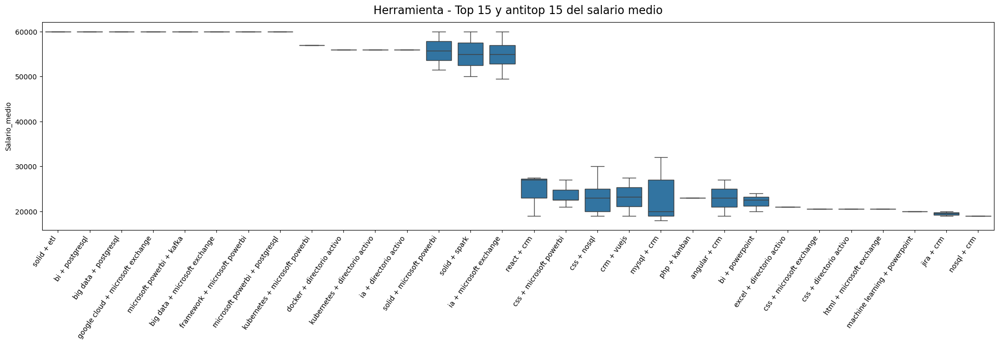

In [87]:
plt.figure(figsize=(20, 7))

df_grafico = df_normalizar.copy()

# Seleccionar las herramientas que aparecen al menos un 0.5% de las veces 
conteo_true = df_grafico[columnas_parejas_herramientas].mean()
columnas_normalizar = conteo_true[conteo_true > 0.005].index.tolist()

df_grafico = cambiar_bool_por_salario(df_normalizar, 'salario_medio', columnas_parejas_herramientas)[['salario_medio'] + columnas_parejas_herramientas]

salario_variable = df_grafico.replace(0, np.nan).mean().dropna().drop('salario_medio').astype(int).round(-1).sort_values(ascending = False)

top_15_salario_variable = salario_variable.head(15).index.tolist()
antitop_15_salario_variable = salario_variable.tail(15).index.tolist()

df_selected = df_herramientas_salarios[top_15_salario_variable + antitop_15_salario_variable + ['salario_medio']]

# Melt para convertir las columnas booleanas en una sola columna 'variable_categorica'
df_melted = pd.melt(df_selected, id_vars=['salario_medio'], var_name=variable, value_name='valor_booleano')

# Filtrar solo las filas con valor True en las columnas booleanas y ordenamos por media de salario
df_grafico = df_melted[df_melted['valor_booleano'] == True]

# Plot del boxplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

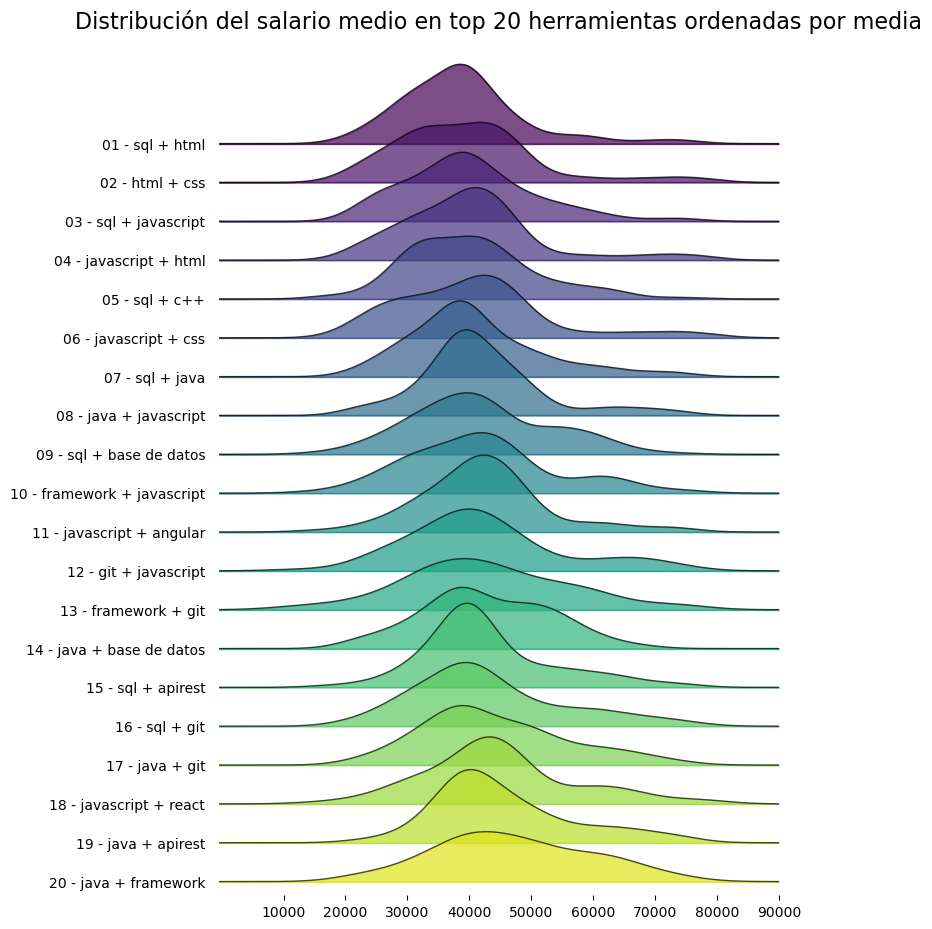

In [88]:
#Definimos el df y la variable

top_15_herramientas = df_herramientas_salarios[columnas_parejas_herramientas].sum().sort_values(ascending = False).head(20)
df_top_15_herramientas_salarios = df_herramientas_salarios[top_15_herramientas.index.tolist() + ['salario_medio']]

df_selected = df_top_15_herramientas_salarios[['salario_medio'] + top_15_herramientas.index.tolist()]

# Melt para convertir las columnas booleanas en una sola columna 'variable_categorica'
df_melted = pd.melt(df_selected, id_vars=['salario_medio'], var_name='herramienta', value_name='valor_booleano')

# Filtrar solo las filas con valor True en las columnas booleanas y ordenamos por media de salario
df_grafico = df_melted[df_melted['valor_booleano'] == True]
variable = 'herramienta'
titulo = 'herramientas'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en top 20 {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

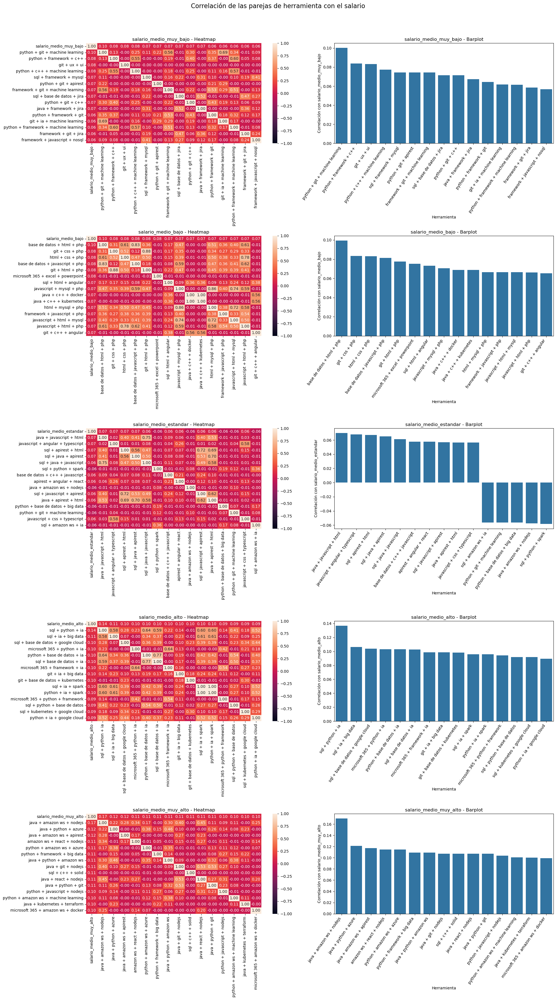

In [89]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):

    matriz_correlacion = df_herramientas_salarios[columnas_ternas_herramientas + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)
    
    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de las parejas de {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

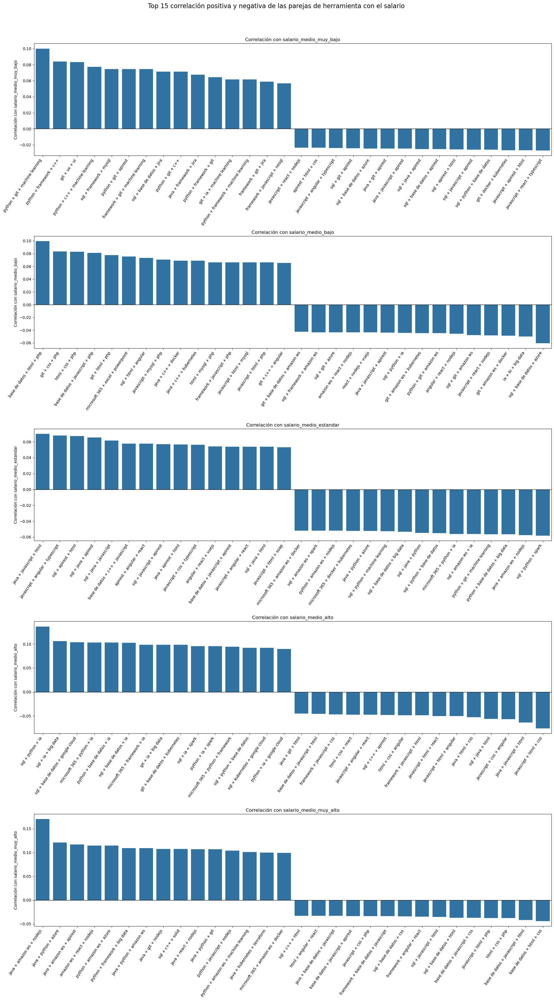

In [90]:
fig, axes = plt.subplots(len(columnas_iterar), figsize=(20, 7 * len(columnas_iterar)))

axes = axes.flatten()

for ax, categoria in zip(axes, columnas_iterar):
    df_grafico = df_normalizar
    
    matriz_correlacion = df_grafico[columnas_ternas_herramientas + [categoria]].corr()
    df_correlaciones = matriz_correlacion[categoria].reset_index()
    top_15_correlacion_positiva = df_correlaciones[(df_correlaciones[categoria] > 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).head(15)
    top_15_correlacion_negativa = df_correlaciones[(df_correlaciones[categoria] < 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).tail(15)
    df_grafico = pd.concat([top_15_correlacion_positiva, top_15_correlacion_negativa])
    
    # Plot del barplot
    sns.barplot(data=df_grafico, x='index', y=categoria, ax=ax)
    ax.set_xlabel('')
    ax.set_ylabel(f'Correlación con {categoria}')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=55, ha='right')
    ax.set_title(f'Correlación con {categoria}')
    
    # Ajustes para mover el eje x por debajo del valor mínimo en el eje y
    ax.axhline(y=0, color="black", linewidth=1)
    
fig.suptitle(f'Top 15 correlación positiva y negativa de las parejas de {variable} con el salario', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

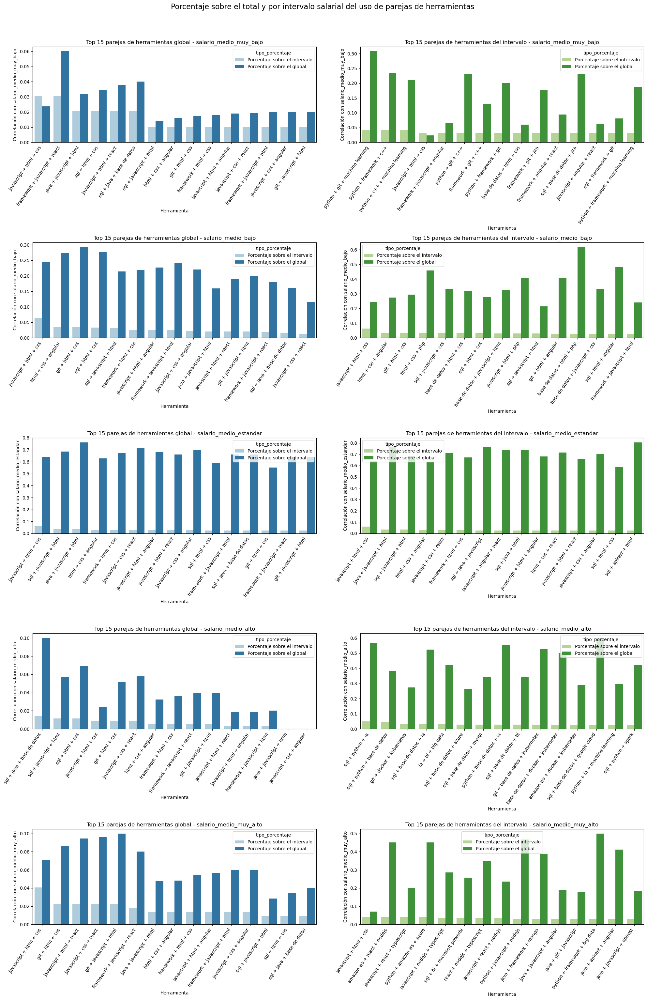

In [91]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 6 * len(columnas_iterar)))

top_15_herramientas = df_normalizar[columnas_ternas_herramientas].sum().sort_values(ascending = False).head(15)
df_temp_1 = df_normalizar[top_15_herramientas.index.tolist() + columnas_intervalos_salariales]

for i, categoria in enumerate(columnas_iterar):
    
    top_15_herramientas_categoria = df_normalizar[df_normalizar[categoria] == 1][columnas_ternas_herramientas].sum().sort_values(ascending = False).head(15)
    df_temp_2 = df_normalizar[top_15_herramientas_categoria.index.tolist() + columnas_intervalos_salariales]
    
    #Creamos el df del primer grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].mean().values
    porcentaje_top_total_global = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].sum().values / top_15_herramientas.values    

    dic_1 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired"), ax=axes[i, 0])
    axes[i, 0].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 0].set_ylabel(f'Correlación con {categoria}')
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=55, ha='right')
    axes[i, 0].set_title(f'Top 15 parejas de herramientas global - {categoria}')

    #Creamos el df del segundo grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas_categoria.index].mean().values
    porcentaje_top_total_global = top_15_herramientas_categoria.values / df_normalizar[top_15_herramientas_categoria.index].sum().values

    dic_1 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired")[2:], ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'Top 15 parejas de herramientas del intervalo - {categoria}')
    
fig.suptitle(f'Porcentaje sobre el total y por intervalo salarial del uso de parejas de herramientas', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

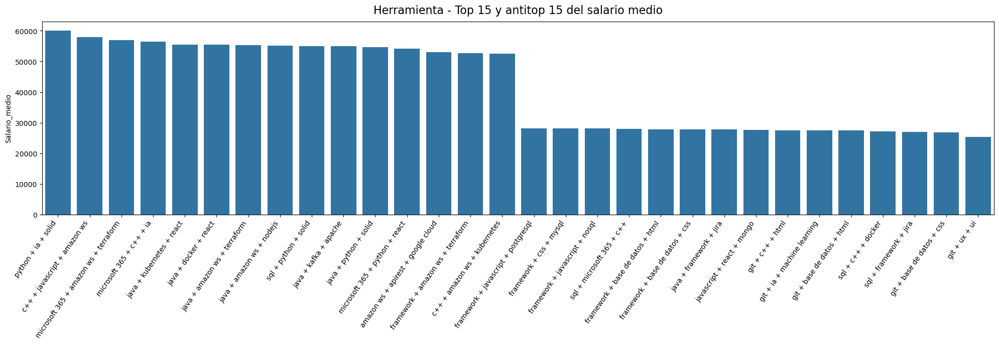

In [92]:
plt.figure(figsize=(20, 7))

df_grafico = df_normalizar.copy()

# Seleccionar las herramientas que aparecen al menos un 0.5% de las veces 
conteo_true = df_grafico[columnas_ternas_herramientas].mean()
columnas_normalizar = conteo_true[conteo_true > 0.005].index.tolist()

df_grafico = cambiar_bool_por_salario(df_normalizar, 'salario_medio', columnas_ternas_herramientas)[['salario_medio'] + columnas_ternas_herramientas]

salario_variable = df_grafico.replace(0, np.nan).mean().dropna().drop('salario_medio').astype(int).round(-1).sort_values(ascending = False)

top_15_salario_variable = salario_variable.head(15)
antitop_15_salario_variable = salario_variable.tail(15)

df_grafico = pd.concat([top_15_salario_variable, antitop_15_salario_variable]).reset_index(name = 'salario_medio')

# Plot del barplot
sns.barplot(data=df_grafico, x='index', y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

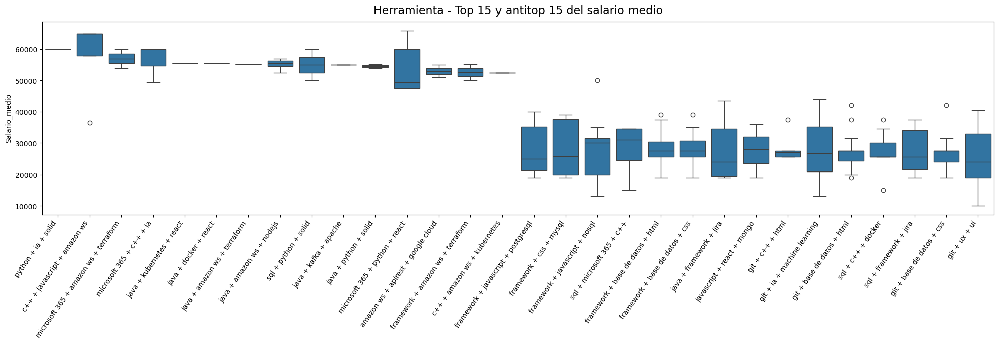

In [93]:
plt.figure(figsize=(20, 7))

df_grafico = df_normalizar.copy()

# Seleccionar las herramientas que aparecen al menos un 0.5% de las veces 
conteo_true = df_grafico[columnas_ternas_herramientas].mean()
columnas_normalizar = conteo_true[conteo_true > 0.005].index.tolist()

df_grafico = cambiar_bool_por_salario(df_normalizar, 'salario_medio', columnas_ternas_herramientas)[['salario_medio'] + columnas_ternas_herramientas]

salario_variable = df_grafico.replace(0, np.nan).mean().dropna().drop('salario_medio').astype(int).round(-1).sort_values(ascending = False)

top_15_salario_variable = salario_variable.head(15).index.tolist()
antitop_15_salario_variable = salario_variable.tail(15).index.tolist()

df_selected = df_herramientas_salarios[top_15_salario_variable + antitop_15_salario_variable + ['salario_medio']]

# Melt para convertir las columnas booleanas en una sola columna 'variable_categorica'
df_melted = pd.melt(df_selected, id_vars=['salario_medio'], var_name=variable, value_name='valor_booleano')

# Filtrar solo las filas con valor True en las columnas booleanas y ordenamos por media de salario
df_grafico = df_melted[df_melted['valor_booleano'] == True]

# Plot del boxplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

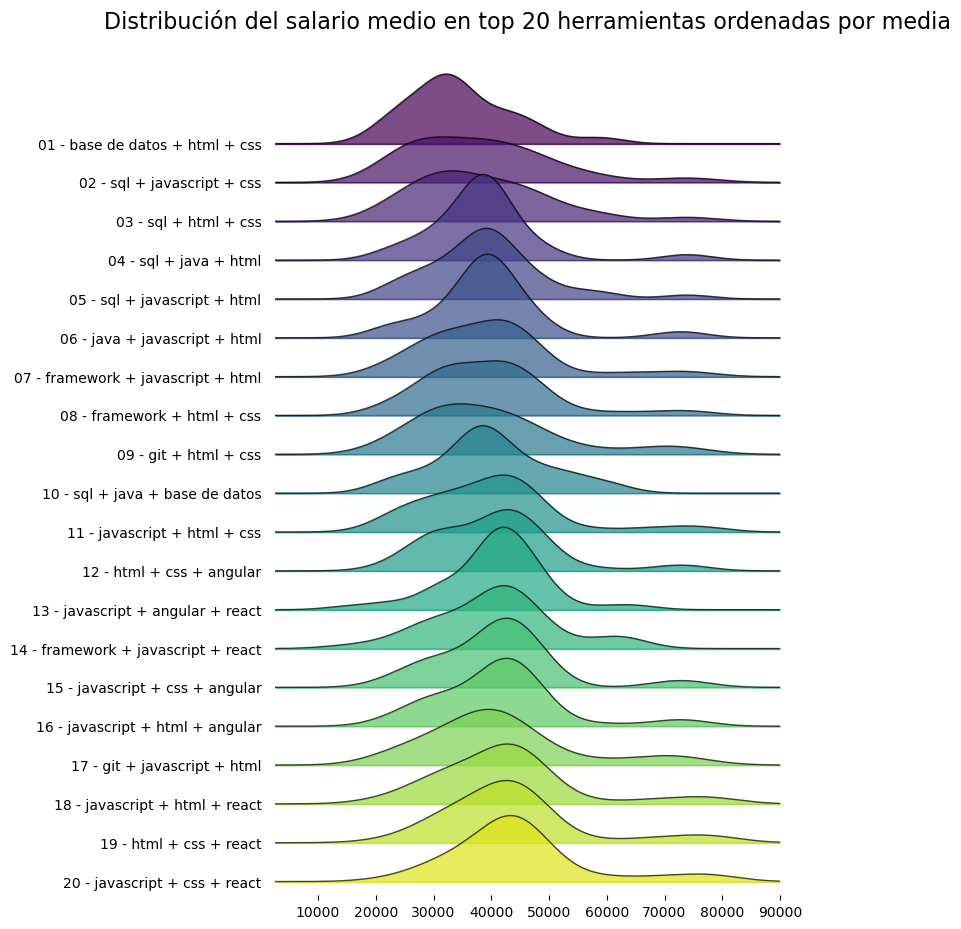

In [94]:
#Definimos el df y la variable

top_15_herramientas = df_herramientas_salarios[columnas_ternas_herramientas].sum().sort_values(ascending = False).head(20)
df_top_15_herramientas_salarios = df_herramientas_salarios[top_15_herramientas.index.tolist() + ['salario_medio']]

df_selected = df_top_15_herramientas_salarios[['salario_medio'] + top_15_herramientas.index.tolist()]

# Melt para convertir las columnas booleanas en una sola columna 'variable_categorica'
df_melted = pd.melt(df_selected, id_vars=['salario_medio'], var_name='herramienta', value_name='valor_booleano')

# Filtrar solo las filas con valor True en las columnas booleanas y ordenamos por media de salario
df_grafico = df_melted[df_melted['valor_booleano'] == True]
variable = 'herramienta'
titulo = 'herramientas'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en top 20 {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

## 3.6. Salario - Empresa

In [95]:
df_empresas_salario = pd.merge(left = df_empresas, right = df_salarios, on = df.columns.drop(['empresa', 'herramientas']).tolist())

In [96]:
#Datos a tratar
df_normalizar = df_empresas_salario.copy()

top_300_empresas = df_salarios['empresa'].value_counts().sort_values(ascending = False).head(300)
columnas_normalizar = top_300_empresas.index.tolist()

columnas_iterar = columnas_intervalos_salariales

#Caracteristicas grafico
variable = 'empresa'

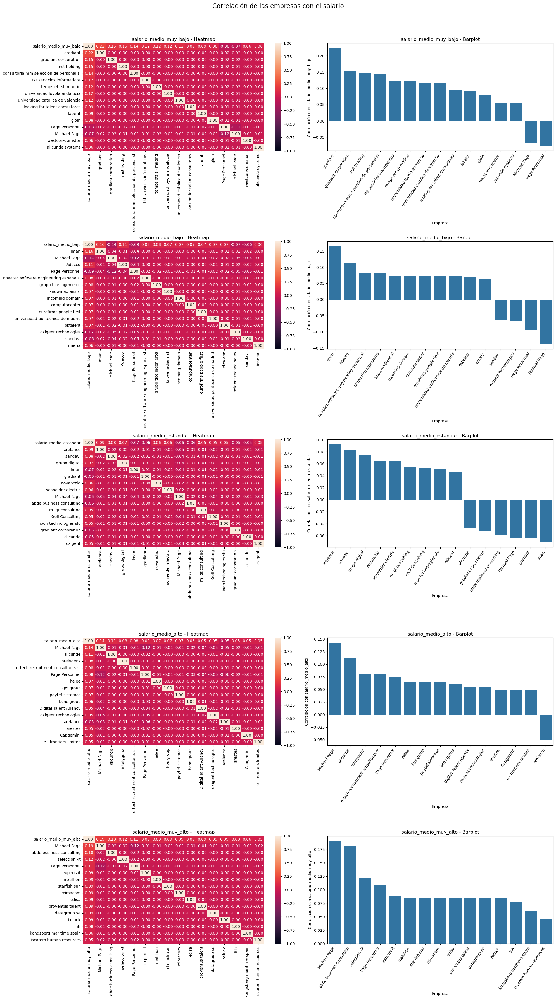

In [97]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):

    matriz_correlacion = df_normalizar[columnas_normalizar + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)
    
    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de las {variable}s con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

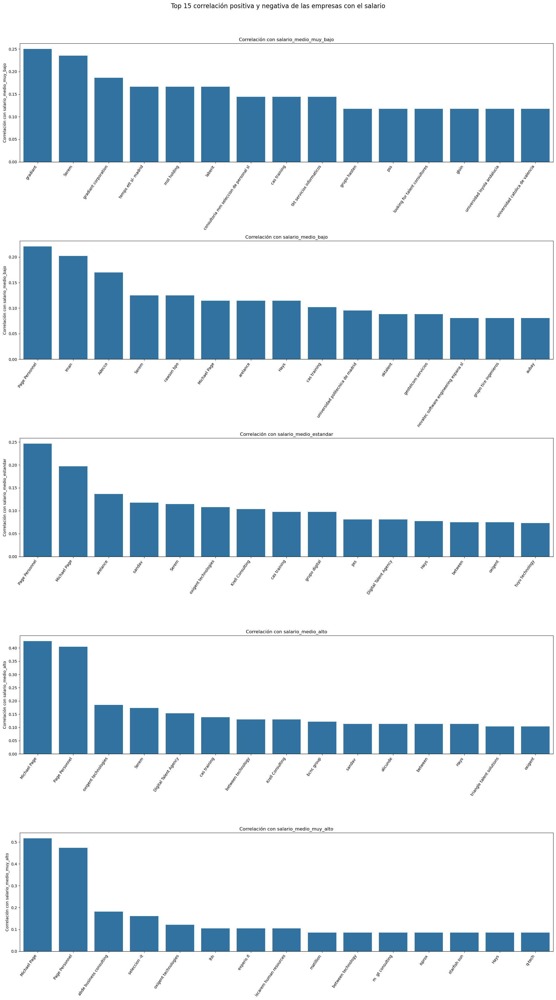

In [98]:
fig, axes = plt.subplots(len(columnas_iterar), figsize=(20, 7 * len(columnas_iterar)))

axes = axes.flatten()

for ax, categoria in zip(axes, columnas_iterar):
    df_grafico = normalizar_salarios_columna(df_normalizar, categoria, columnas_normalizar)
    
    matriz_correlacion = df_grafico[columnas_normalizar + [categoria]].corr()
    df_correlaciones = matriz_correlacion[categoria].reset_index()
    top_15_correlacion_positiva = df_correlaciones[(df_correlaciones[categoria] > 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).head(15)
    top_15_correlacion_negativa = df_correlaciones[(df_correlaciones[categoria] < 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).tail(15)
    df_grafico = pd.concat([top_15_correlacion_positiva, top_15_correlacion_negativa])
    
    # Plot del barplot
    sns.barplot(data=df_grafico, x='index', y=categoria, ax=ax)
    ax.set_xlabel('')
    ax.set_ylabel(f'Correlación con {categoria}')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=55, ha='right')
    ax.set_title(f'Correlación con {categoria}')
    
    # Ajustes para mover el eje x por debajo del valor mínimo en el eje y
    ax.axhline(y=0, color="black", linewidth=1)
    
fig.suptitle(f'Top 15 correlación positiva y negativa de las {variable}s con el salario', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

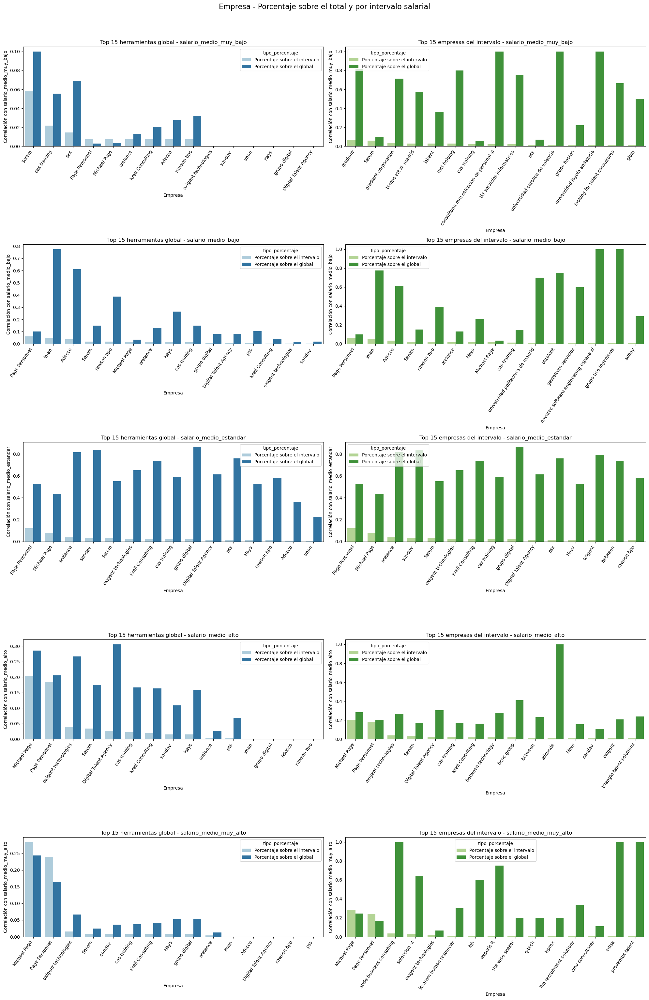

In [99]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 6 * len(columnas_iterar)))

top_15_herramientas = df_normalizar[columnas_normalizar].sum().sort_values(ascending = False).head(15)
df_temp_1 = df_normalizar[top_15_herramientas.index.tolist() + columnas_intervalos_salariales]

for i, categoria in enumerate(columnas_iterar):
    
    top_15_herramientas_categoria = df_normalizar[df_normalizar[categoria] == 1][columnas_normalizar].sum().sort_values(ascending = False).head(15)
    df_temp_2 = df_normalizar[top_15_herramientas_categoria.index.tolist() + columnas_intervalos_salariales]
    
    #Creamos el df del primer grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].mean().values
    porcentaje_top_total_global = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].sum().values / top_15_herramientas.values    

    dic_1 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired"), ax=axes[i, 0])
    axes[i, 0].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 0].set_ylabel(f'Correlación con {categoria}')
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=55, ha='right')
    axes[i, 0].set_title(f'Top 15 herramientas global - {categoria}')

    #Creamos el df del segundo grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas_categoria.index].mean().values
    porcentaje_top_total_global = top_15_herramientas_categoria.values / df_normalizar[top_15_herramientas_categoria.index].sum().values

    dic_1 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired")[2:], ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'Top 15 {variable}s del intervalo - {categoria}')
    
fig.suptitle(f'{variable[0].upper() + variable[1:]} - Porcentaje sobre el total y por intervalo salarial', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

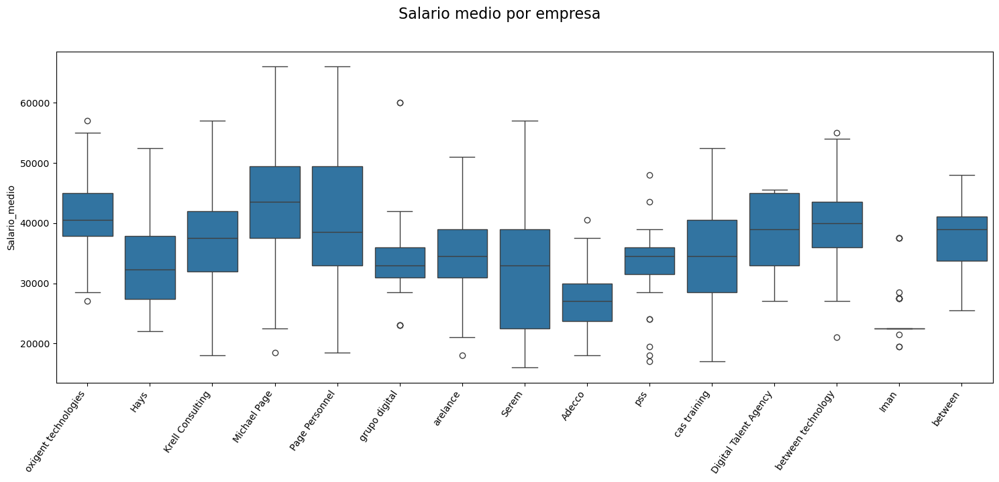

In [100]:
plt.figure(figsize=(15, 7))

top_15_empresas = df_salarios['empresa'].value_counts().sort_values(ascending = False).head(15)
df_grafico = df_top_15_empresas_salarios = df_salarios[df_salarios['empresa'].isin(top_15_empresas.index)]

# Plot del boxplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.suptitle(f'Salario medio por {variable}', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

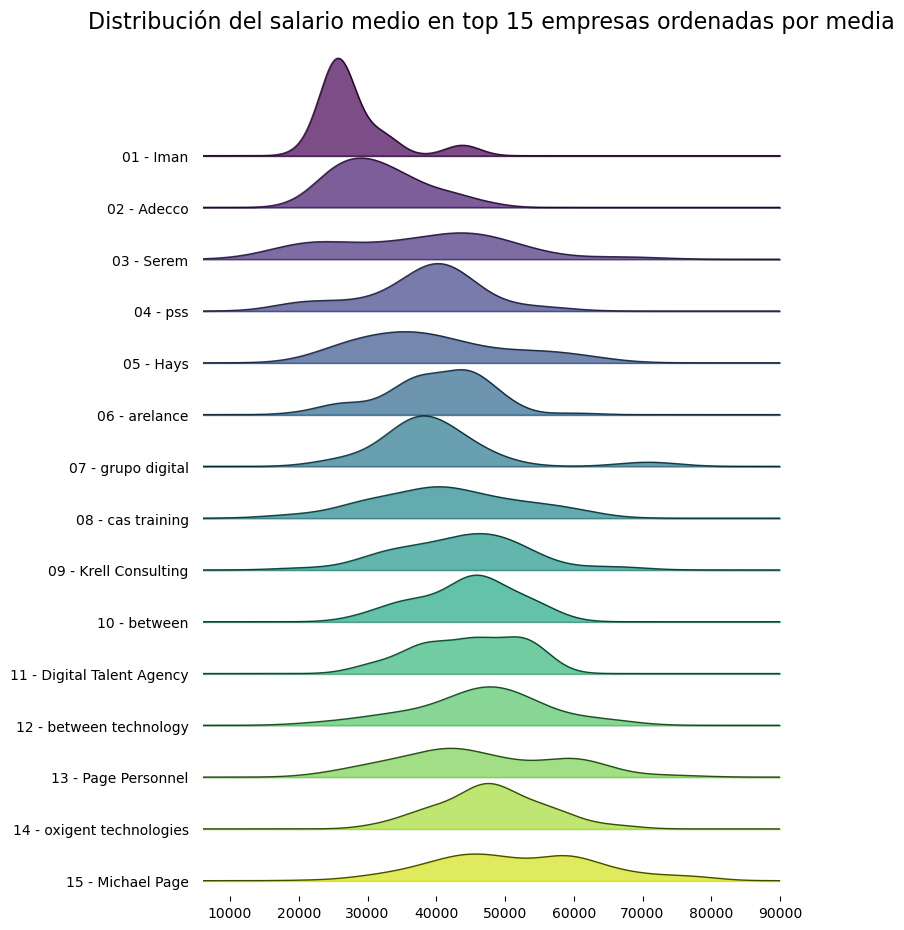

In [101]:
#Definimos el df y la variable
top_15_empresas = df_salarios['empresa'].value_counts().sort_values(ascending = False).head(15)
df_grafico = df_top_15_empresas_salarios = df_salarios[df_salarios['empresa'].isin(top_15_empresas.index)]
variable = 'empresa'
titulo = 'empresas'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en top 15 {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

## 3.7. Salario - Sector

In [102]:
df_stack_salario = pd.merge(left = df_stack, right = df_salarios, on = df.columns.drop(['categoria_empleo', 'herramientas']).tolist())

In [103]:
#Datos a tratar
df_normalizar = df_stack_salario

columnas_normalizar = df_normalizar['categoria_empleo'].unique().tolist()

columnas_iterar = columnas_intervalos_salariales

#Caracteristicas grafico
variable = 'categoria_empleo'

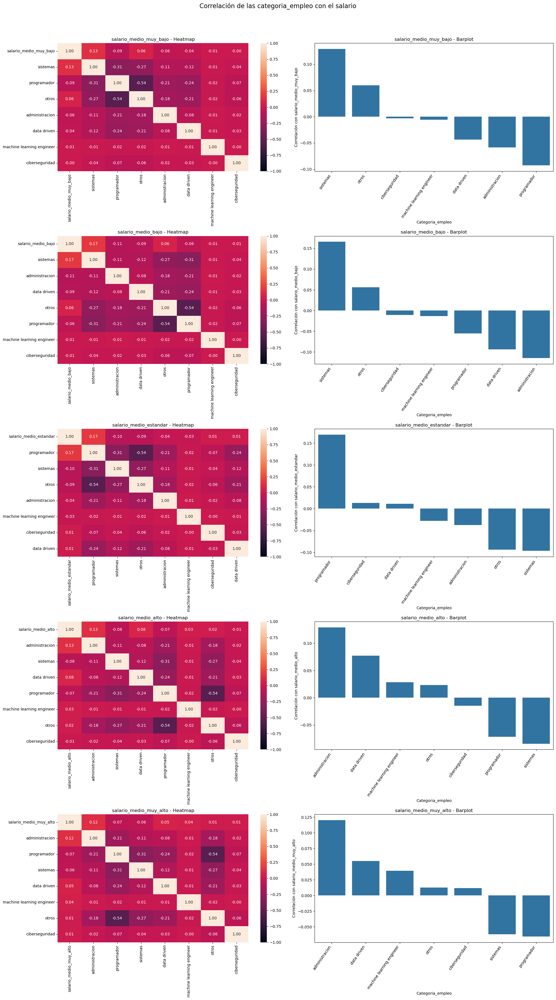

In [104]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):

    matriz_correlacion = df_normalizar[columnas_normalizar + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)
    
    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de las {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

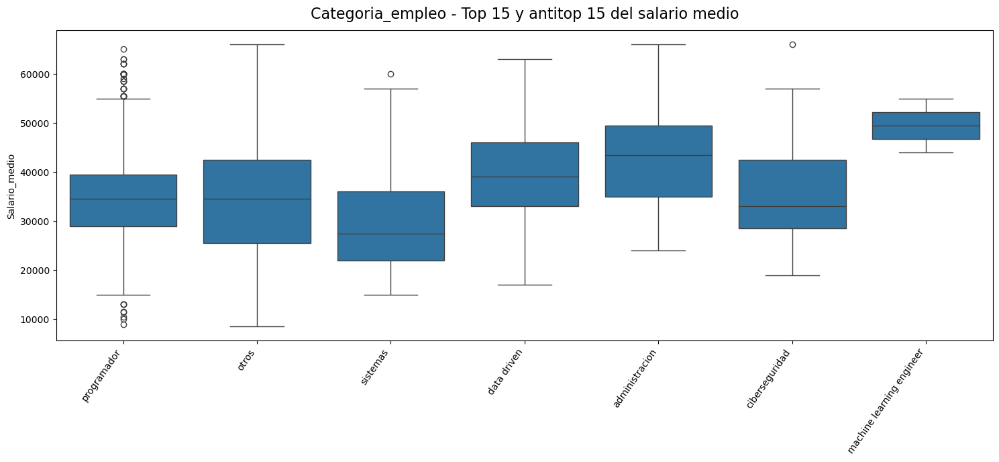

In [105]:
plt.figure(figsize=(15, 7))

df_grafico = df_normalizar.copy()

# Plot del barplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

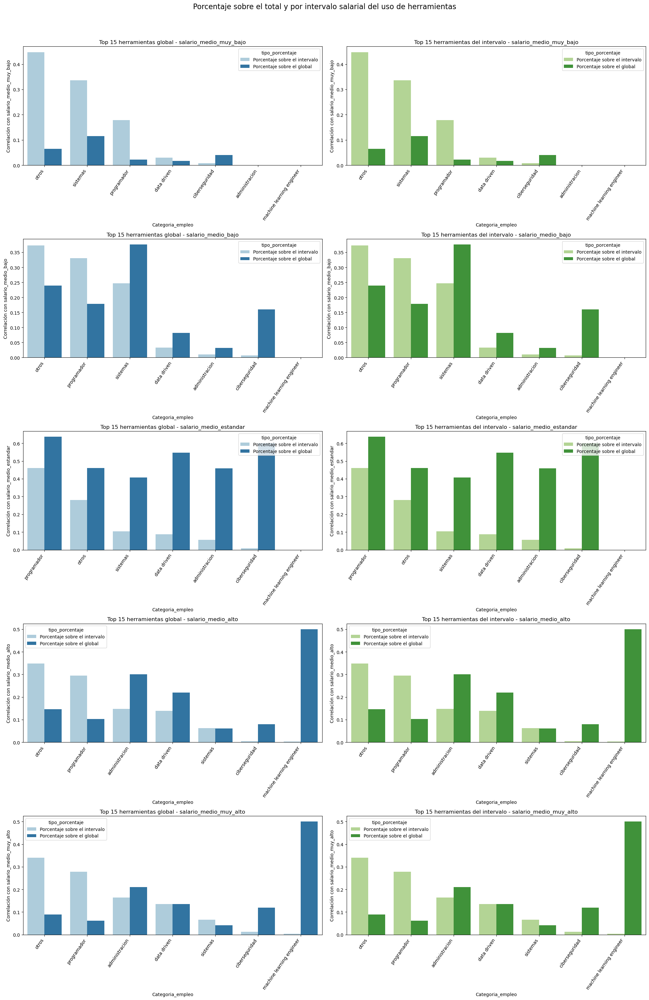

In [106]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 6 * len(columnas_iterar)))

top_15_herramientas = df_normalizar[columnas_normalizar].sum().sort_values(ascending = False).head(15)
df_temp_1 = df_normalizar[top_15_herramientas.index.tolist() + columnas_intervalos_salariales]

for i, categoria in enumerate(columnas_iterar):
    
    top_15_herramientas_categoria = df_normalizar[df_normalizar[categoria] == 1][columnas_normalizar].sum().sort_values(ascending = False).head(15)
    df_temp_2 = df_normalizar[top_15_herramientas_categoria.index.tolist() + columnas_intervalos_salariales]
    
    #Creamos el df del primer grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].mean().values
    porcentaje_top_total_global = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].sum().values / top_15_herramientas.values    

    dic_1 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired"), ax=axes[i, 0])
    axes[i, 0].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 0].set_ylabel(f'Correlación con {categoria}')
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=55, ha='right')
    axes[i, 0].set_title(f'Top 15 herramientas global - {categoria}')

    #Creamos el df del segundo grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas_categoria.index].mean().values
    porcentaje_top_total_global = top_15_herramientas_categoria.values / df_normalizar[top_15_herramientas_categoria.index].sum().values

    dic_1 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired")[2:], ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'Top 15 herramientas del intervalo - {categoria}')
    
fig.suptitle(f'Porcentaje sobre el total y por intervalo salarial del uso de herramientas', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

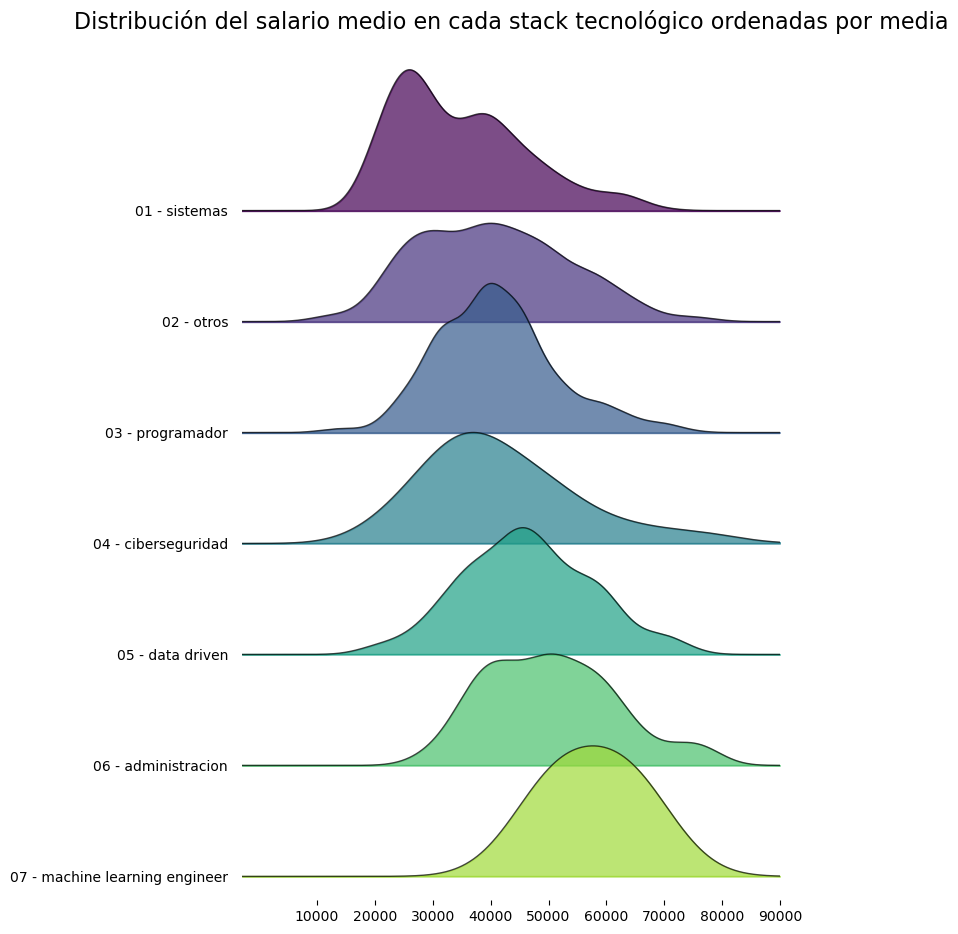

In [107]:
#Definimos el df y la variable
df_grafico = df_salarios.copy()
variable = 'categoria_empleo'
titulo = 'cada stack tecnológico'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

## 3.8. Salario - Rol

In [108]:
df_rol = df.copy()
columnas_rol = df.dropna(subset = 'titulo')['titulo'].unique().tolist()

df_rol = pd.get_dummies(data = df_rol, columns = ['titulo'], dtype = int, prefix = '', prefix_sep = '')

In [109]:
df_rol_salario = pd.merge(left = df_rol, right = df_salarios, on = df.columns.drop(['titulo', 'herramientas']).tolist())

In [110]:
#Datos a tratar
df_normalizar = df_rol_salario

top_300_variable = df_salarios['titulo'].value_counts().sort_values(ascending = False).head(20)
columnas_normalizar = top_300_variable.index.tolist()

columnas_iterar = columnas_intervalos_salariales

#Caracteristicas grafico
variable = 'titulo'

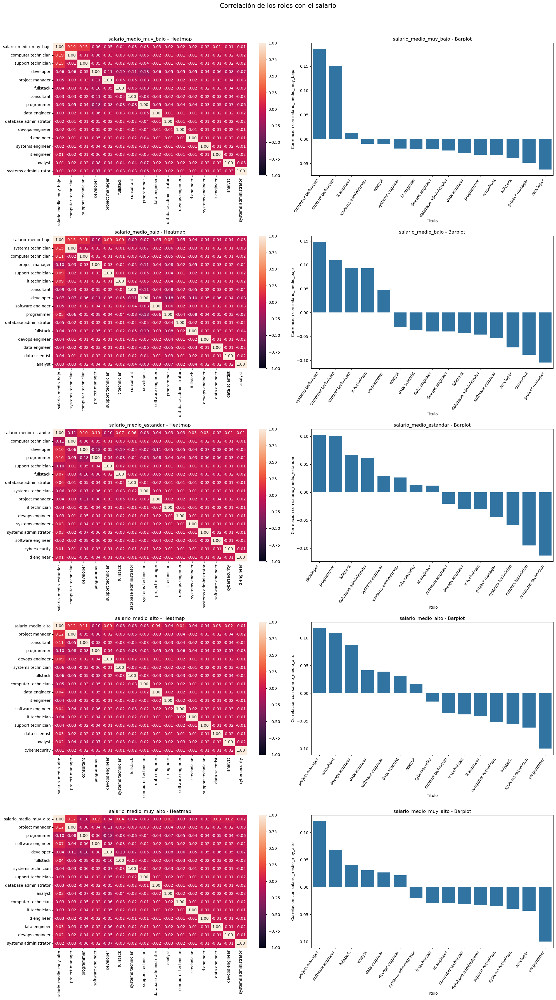

In [111]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):

    matriz_correlacion = df_normalizar[columnas_normalizar + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)
    
    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de los roles con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

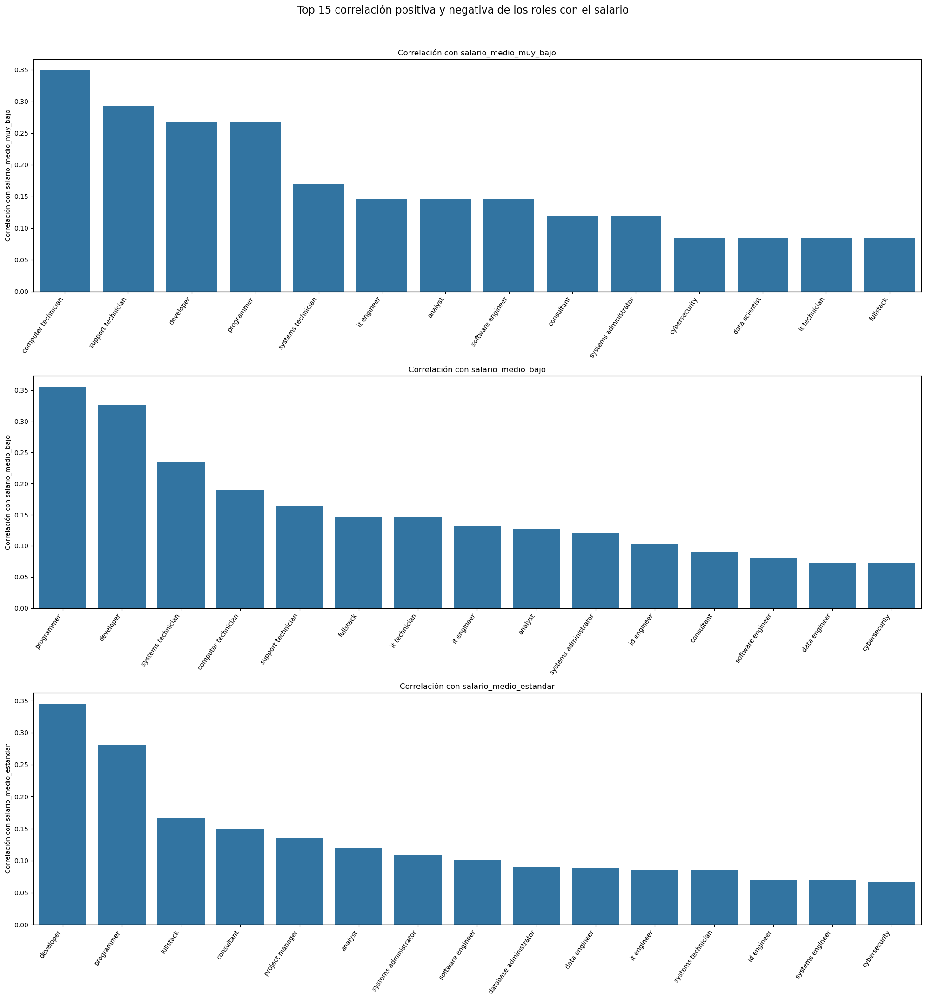

In [112]:
fig, axes = plt.subplots(len(columnas_salarios), figsize=(20, 7 * len(columnas_salarios)))

axes = axes.flatten()

for ax, categoria in zip(axes, columnas_iterar):
    df_grafico = normalizar_salarios_columna(df_normalizar, categoria, columnas_normalizar)
    
    matriz_correlacion = df_grafico[columnas_normalizar + [categoria]].corr()
    df_correlaciones = matriz_correlacion[categoria].reset_index()
    top_15_correlacion_positiva = df_correlaciones[(df_correlaciones[categoria] > 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).head(15)
    top_15_correlacion_negativa = df_correlaciones[(df_correlaciones[categoria] < 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).tail(15)
    df_grafico = pd.concat([top_15_correlacion_positiva, top_15_correlacion_negativa])
    
    # Plot del barplot
    sns.barplot(data=df_grafico, x='index', y=categoria, ax=ax)
    ax.set_xlabel('')
    ax.set_ylabel(f'Correlación con {categoria}')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=55, ha='right')
    ax.set_title(f'Correlación con {categoria}')
    
    # Ajustes para mover el eje x por debajo del valor mínimo en el eje y
    ax.axhline(y=0, color="black", linewidth=1)
    
fig.suptitle(f'Top 15 correlación positiva y negativa de los roles con el salario', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

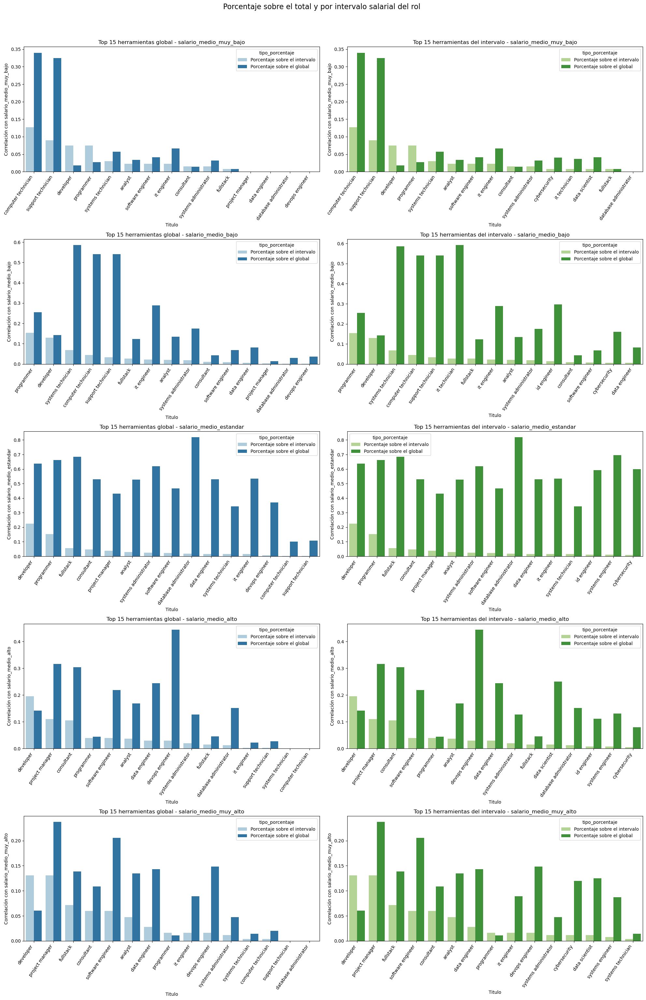

In [113]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 6 * len(columnas_iterar)))

top_15_herramientas = df_normalizar[columnas_normalizar].sum().sort_values(ascending = False).head(15)
df_temp_1 = df_normalizar[top_15_herramientas.index.tolist() + columnas_intervalos_salariales]

for i, categoria in enumerate(columnas_iterar):
    
    top_15_herramientas_categoria = df_normalizar[df_normalizar[categoria] == 1][columnas_normalizar].sum().sort_values(ascending = False).head(15)
    df_temp_2 = df_normalizar[top_15_herramientas_categoria.index.tolist() + columnas_intervalos_salariales]
    
    #Creamos el df del primer grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].mean().values
    porcentaje_top_total_global = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas.index].sum().values / top_15_herramientas.values    

    dic_1 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired"), ax=axes[i, 0])
    axes[i, 0].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 0].set_ylabel(f'Correlación con {categoria}')
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=55, ha='right')
    axes[i, 0].set_title(f'Top 15 herramientas global - {categoria}')

    #Creamos el df del segundo grafico
    porcentaje_top_total_categoria = df_normalizar[df_normalizar[categoria] == 1][top_15_herramientas_categoria.index].mean().values
    porcentaje_top_total_global = top_15_herramientas_categoria.values / df_normalizar[top_15_herramientas_categoria.index].sum().values

    dic_1 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_categoria}
    df_grafico_1 = pd.DataFrame(dic_1).sort_values(ascending = False, by = 'porcentaje')
    df_grafico_1['tipo_porcentaje'] = 'Porcentaje sobre el intervalo'

    dic_2 = {'herramienta' : top_15_herramientas_categoria.index, 'porcentaje' : porcentaje_top_total_global}
    df_grafico_2 = pd.DataFrame(dic_2)
    df_grafico_2['tipo_porcentaje'] = 'Porcentaje sobre el global'

    df_grafico = pd.concat([df_grafico_1, df_grafico_2])
    
    # Plot del barplot
    sns.barplot(data = df_grafico, x='herramienta', y='porcentaje', hue = 'tipo_porcentaje', palette = sns.color_palette("Paired")[2:], ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'Top 15 herramientas del intervalo - {categoria}')
    
fig.suptitle(f'Porcentaje sobre el total y por intervalo salarial del rol', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

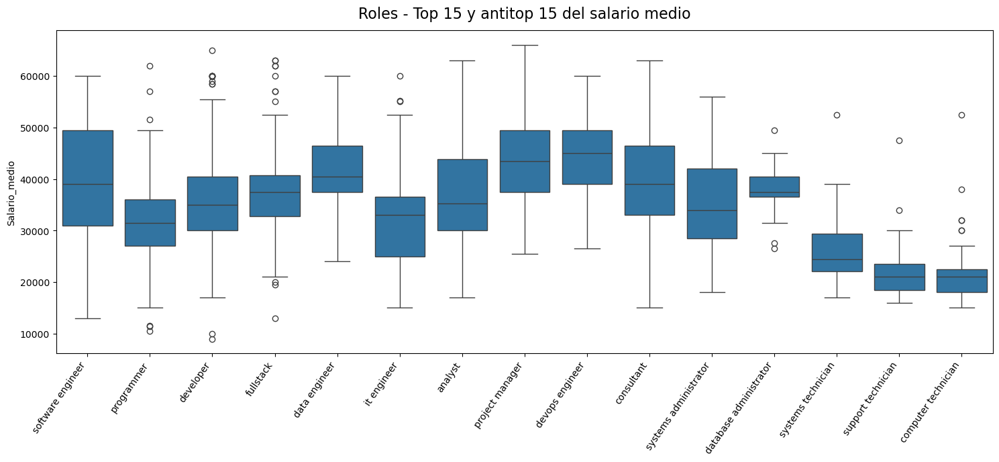

In [114]:
plt.figure(figsize=(15, 7))

#Definimos el df y la variable
top_15_variable = df_salarios['titulo'].value_counts().sort_values(ascending = False).head(15)
df_grafico = df_top_15_variable_salarios = df_salarios[df_salarios['titulo'].isin(top_15_variable.index)]

# Plot del barplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'Roles - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

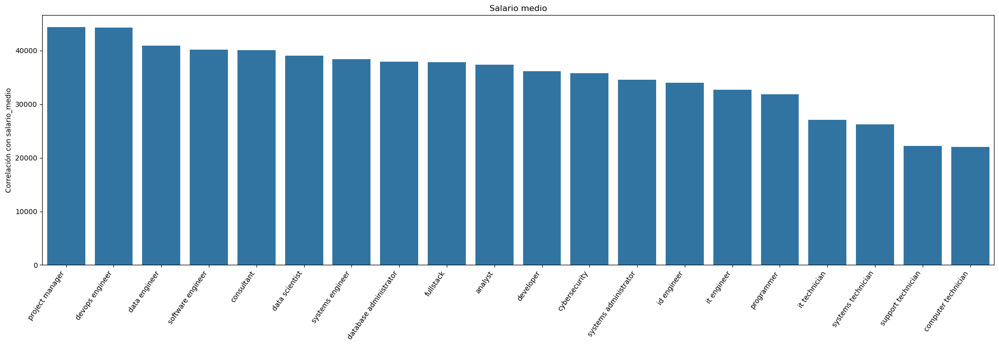

In [115]:
plt.figure(figsize=(20, 7))

df_grafico = df_normalizar.copy()

# Seleccionar las herramientas que aparecen al menos un 0.3% de las veces (True <= 10)
conteo_true = df_grafico[columnas_normalizar].mean()
columnas_normalizar = conteo_true[conteo_true > 0.003].index.tolist()


df_grafico = cambiar_bool_por_salario(df_normalizar, 'salario_medio', columnas_normalizar)[['salario_medio'] + columnas_normalizar]

salario_variable = df_grafico.replace(0, np.nan).mean().dropna().drop('salario_medio').astype(int).round(-1).sort_values(ascending = False)

top_15_salario_variable = salario_variable.head(15)
antitop_15_salario_variable = salario_variable.tail(15)

df_grafico = pd.concat([top_15_salario_variable, antitop_15_salario_variable]).reset_index(name = 'salario_medio')

# Plot del barplot
sns.barplot(data=df_grafico, x='index', y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Correlación con salario_medio')
plt.xticks(rotation = 55, ha = 'right')
plt.title(f'Salario medio')

fig.suptitle(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

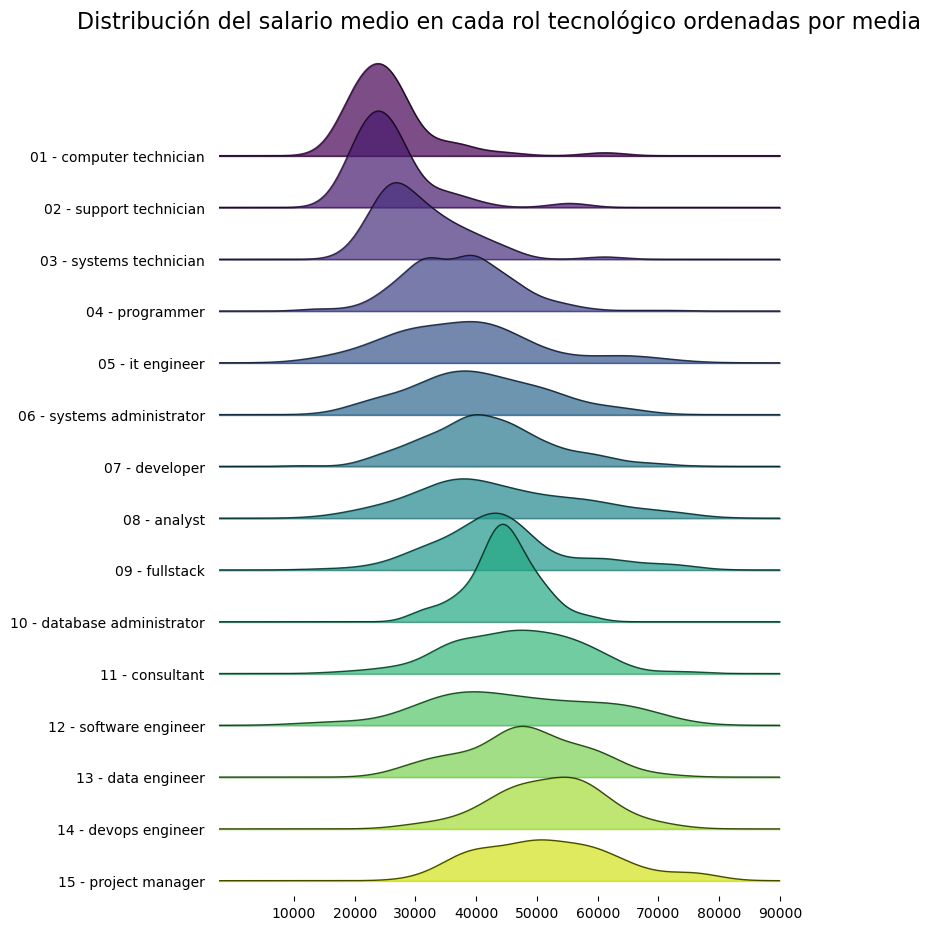

In [116]:
#Definimos el df y la variable
top_15_variable = df_salarios['titulo'].value_counts().sort_values(ascending = False).head(15)
df_grafico = df_top_15_variable_salarios = df_salarios[df_salarios['titulo'].isin(top_15_variable.index)]
variable = 'titulo'
titulo = 'cada rol tecnológico'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

## 3.9. Salario - Presencialidad

In [117]:
df_presencialidad = df.copy()
columnas_presencialidad = df.dropna(subset = 'presencialidad')['presencialidad'].unique().tolist()

df_presencialidad = pd.get_dummies(data = df_presencialidad, columns = ['presencialidad'], dtype = int, prefix = '', prefix_sep = '')

In [118]:
df_presencialidad_salario = pd.merge(left = df_presencialidad, right = df_salarios, on = df.columns.drop(['presencialidad', 'herramientas']).tolist())

In [119]:
#Datos a tratar
df_normalizar = df_presencialidad_salario

columnas_normalizar = columnas_presencialidad

columnas_iterar = columnas_intervalos_salariales

#Caracteristicas grafico
variable = 'presencialidad'

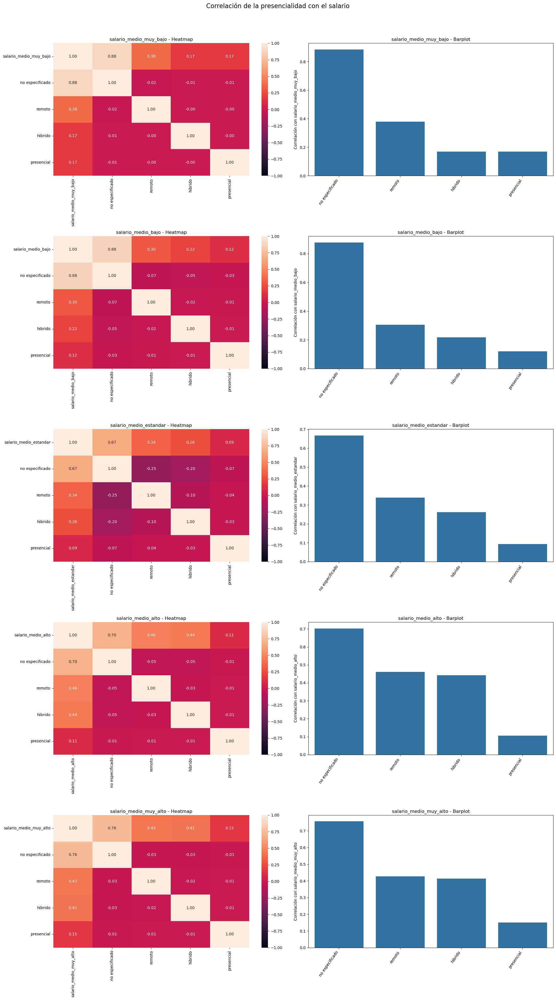

In [120]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):
    df_grafico = normalizar_salarios_columna(df_normalizar, categoria, columnas_normalizar)
    
    matriz_correlacion = df_grafico[columnas_normalizar + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)

    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel('')
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de la {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

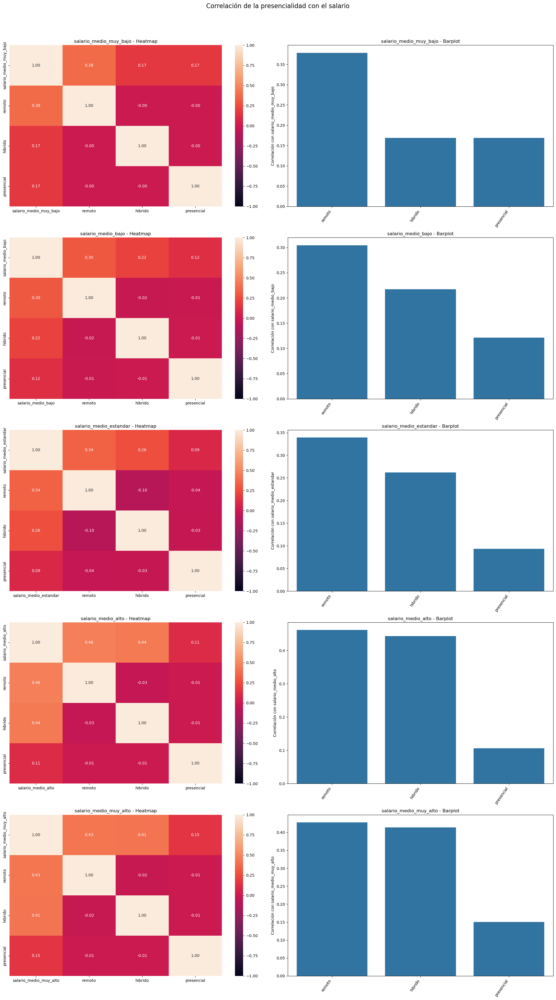

In [121]:
#Solo los trabajos con presencialidad especificada
df_normalizar = df_presencialidad_salario.drop(columns = 'no especificado')

columnas_normalizar = columnas_presencialidad.copy()
columnas_normalizar.remove('no especificado')

fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):
    df_grafico = normalizar_salarios_columna(df_normalizar, categoria, columnas_normalizar)
    
    matriz_correlacion = df_grafico[columnas_normalizar + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)

    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel('')
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de la {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

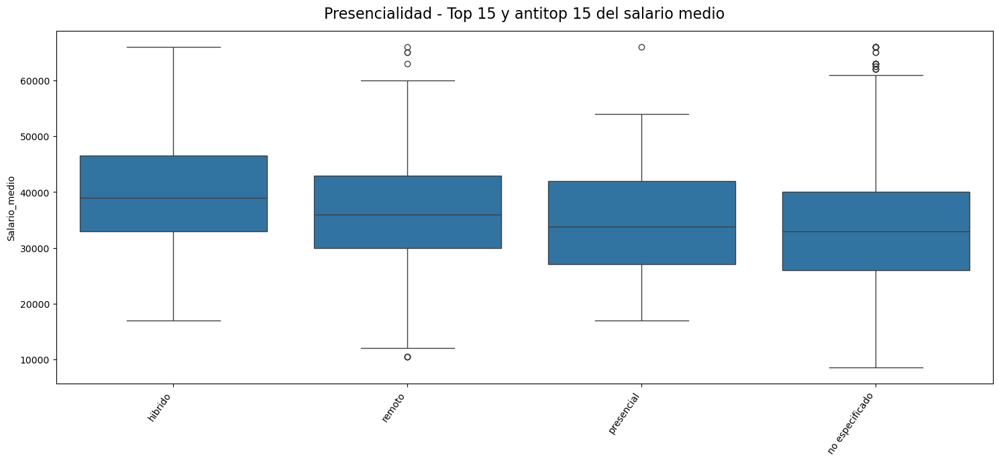

In [122]:
plt.figure(figsize=(15, 7))

df_grafico = df_normalizar.copy()

# Plot del barplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

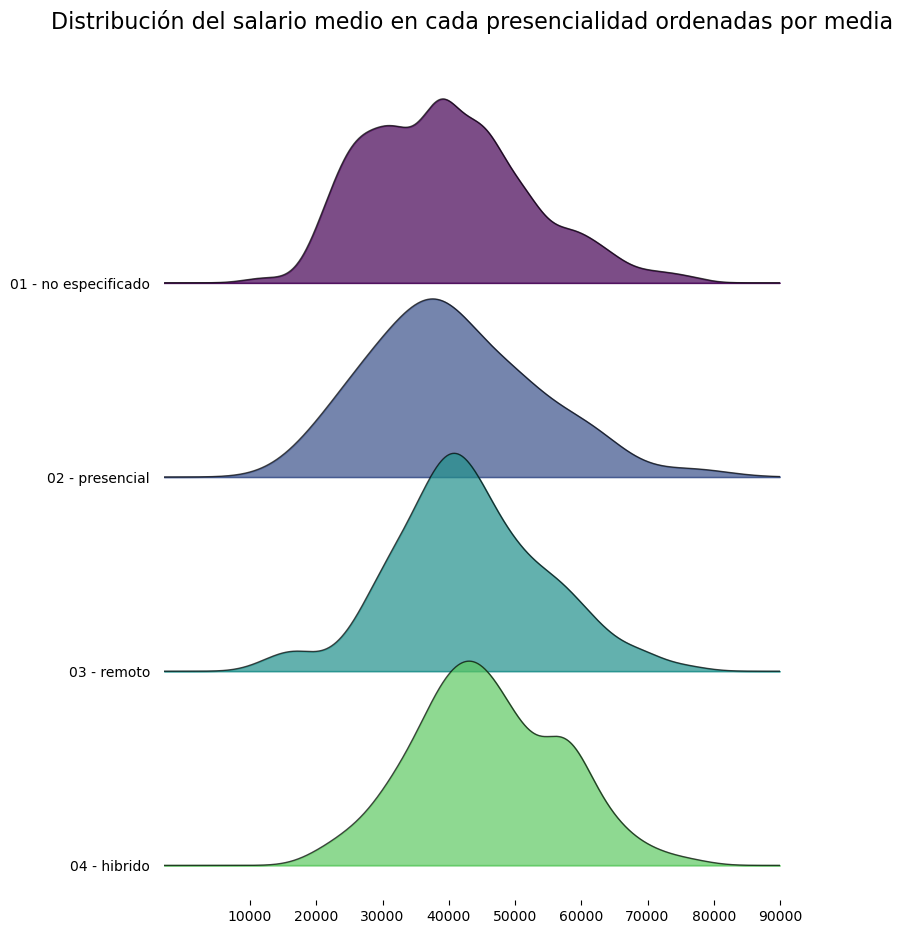

In [123]:
#Definimos el df y la variable
df_grafico = df_presencialidad_salario.copy()
titulo = 'cada presencialidad'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

## 3.10. Salario - Comunidad

In [124]:
df_comunidad = df.copy()
columnas_comunidad = df.dropna(subset = 'comunidad')['comunidad'].unique().tolist()

df_comunidad = pd.get_dummies(data = df_comunidad, columns = ['comunidad'], dtype = int, prefix = '', prefix_sep = '')

In [125]:
df_comunidad_salario = pd.merge(left = df_comunidad, right = df_salarios, on = df.columns.drop(['comunidad', 'herramientas']).tolist())

In [126]:
#Datos a tratar
df_normalizar = df_comunidad_salario

top_300_variable = df_salarios['comunidad'].value_counts().sort_values(ascending = False).head(20)
columnas_normalizar = top_300_variable.index.tolist()

columnas_iterar = columnas_intervalos_salariales

#Caracteristicas grafico
variable = 'comunidad'

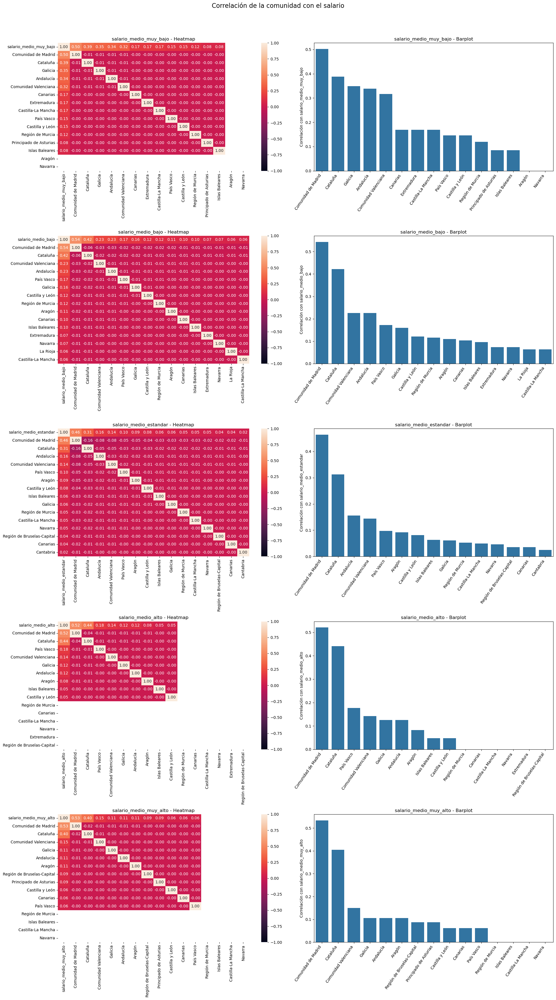

In [127]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):
    df_grafico = normalizar_salarios_columna(df_normalizar, categoria, columnas_normalizar)
    
    matriz_correlacion = df_grafico[columnas_normalizar + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)

    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel('')
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de la {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

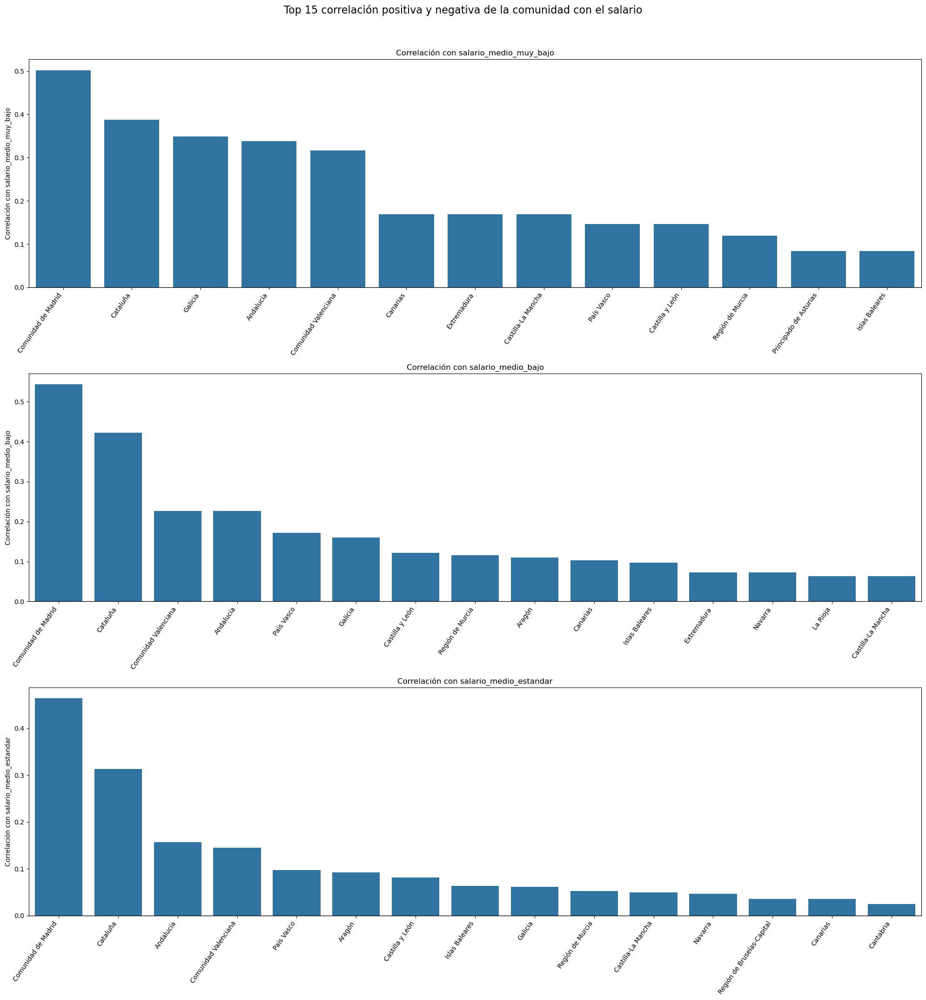

In [128]:
fig, axes = plt.subplots(len(columnas_salarios), figsize=(20, 7 * len(columnas_salarios)))

axes = axes.flatten()

for ax, categoria in zip(axes, columnas_iterar):
    df_grafico = normalizar_salarios_columna(df_normalizar, categoria, columnas_normalizar)
    
    matriz_correlacion = df_grafico[columnas_normalizar + [categoria]].corr()
    df_correlaciones = matriz_correlacion[categoria].reset_index()
    top_15_correlacion_positiva = df_correlaciones[(df_correlaciones[categoria] > 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).head(15)
    top_15_correlacion_negativa = df_correlaciones[(df_correlaciones[categoria] < 0) & (df_correlaciones['index'] != categoria)].sort_values(by=categoria, ascending=False).tail(15)
    df_grafico = pd.concat([top_15_correlacion_positiva, top_15_correlacion_negativa])
    
    # Plot del barplot
    sns.barplot(data=df_grafico, x='index', y=categoria, ax=ax)
    ax.set_xlabel('')
    ax.set_ylabel(f'Correlación con {categoria}')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=55, ha='right')
    ax.set_title(f'Correlación con {categoria}')
    
    # Ajustes para mover el eje x por debajo del valor mínimo en el eje y
    ax.axhline(y=0, color="black", linewidth=1)
    
fig.suptitle(f'Top 15 correlación positiva y negativa de la {variable} con el salario', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

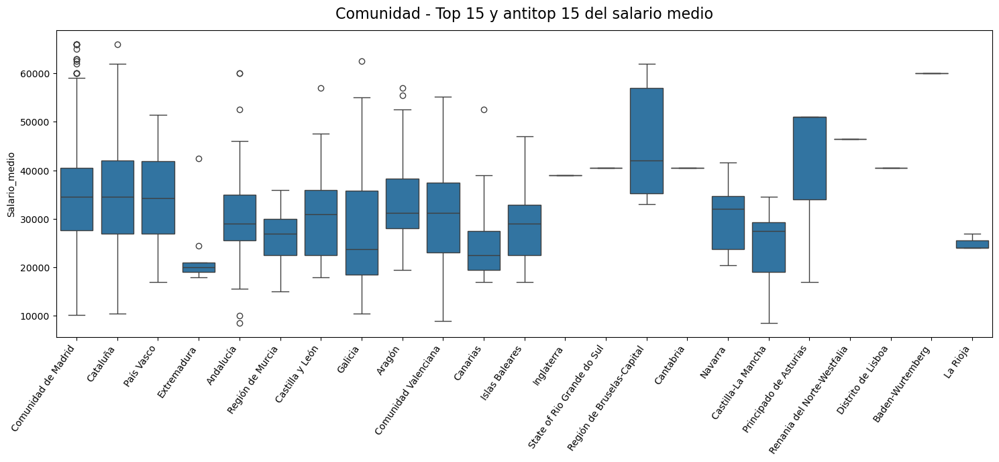

In [129]:
plt.figure(figsize=(15, 7))

df_grafico = df_normalizar.copy()

# Plot del barplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

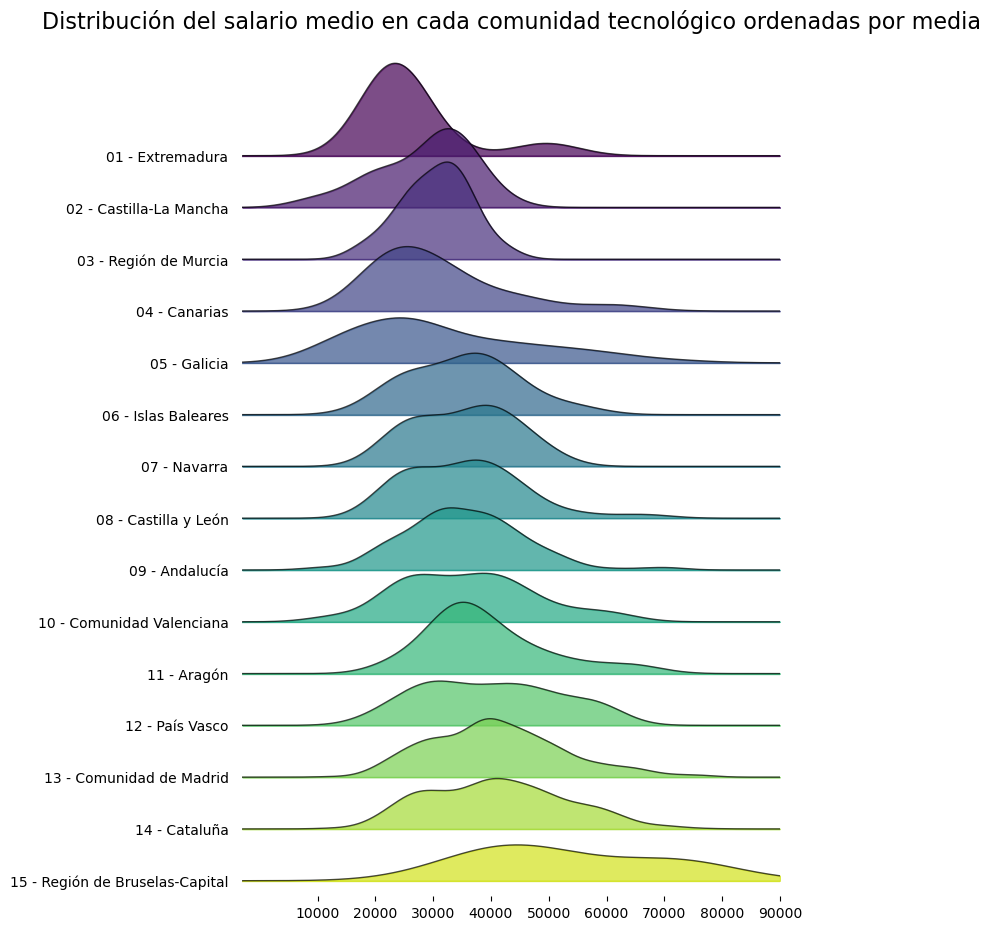

In [130]:
#Definimos el df y la variable
top_15_variable = df_salarios['comunidad'].value_counts().sort_values(ascending = False).head(15)
df_grafico = df_salarios[df_salarios['comunidad'].isin(top_15_variable.index)]
variable = 'comunidad'
titulo = 'cada comunidad tecnológico'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

## 3.11. Salario - Experiencia

In [131]:
df_experiencia = df.copy()

df_experiencia['rango'] = df_experiencia['experiencia']
df_experiencia['rango'] = df_experiencia['rango'].apply(intervalo_experiencia)

columnas_experiencia = df_experiencia.dropna(subset = 'experiencia')['experiencia'].unique().astype(str).tolist()
columnas_rango = df_experiencia.dropna(subset = 'rango')['rango'].unique().tolist()


df_experiencia = pd.get_dummies(data = df_experiencia, columns = ['rango', 'experiencia'], dtype = int, prefix = '', prefix_sep = '')
df_experiencia['experiencia'] = df['experiencia']

In [132]:
df_experiencia_salario = pd.merge(left = df_experiencia, right = df_salarios, on = df.columns.drop(['herramientas']).tolist())

In [133]:
df_experiencia_salario[df_experiencia_salario['Lead'] == 1][['titulo', 'salario_medio', 'experiencia']].sort_values(by = 'salario_medio')

,titulo,salario_medio,experiencia
1961,developer,10000.0,10.0
2132,junior uav engineer,10500.0,10.0
2034,junior uav engineer,10500.0,10.0
2624,software engineer,13000.0,10.0
2138,software engineer,13000.0,10.0
2061,senior uav engineer,14000.0,10.0
2797,helpdesk con aleman avanzado,19000.0,10.0
2136,computer engineer,23500.0,10.0
2160,computer engineer,23500.0,10.0
856,ingeniero/a de calculo,30000.0,10.0


- Vemos que se han categorizado como requerimiento 10 años de experiencia en trabajos que realmente no corresponden (Junior, Senior) por eso los limpiaremos aplicando un filtro de salario medio de 30000

In [134]:
indices_a_eliminar = df_experiencia_salario[(df_experiencia_salario['Lead'] == 1) & (df_experiencia_salario['salario_medio'] < 30000)].index
df_experiencia_salario = df_experiencia_salario.drop(indices_a_eliminar)

In [135]:
df_experiencia_salario['rango'] = df_experiencia_salario['experiencia'].apply(intervalo_experiencia)

### 2.11.1. Por años de experiencia

In [136]:
#Datos a tratar
df_normalizar = df_experiencia_salario.copy()

columnas_normalizar = columnas_experiencia.copy()

columnas_iterar = columnas_intervalos_salariales

#Caracteristicas grafico
variable = 'experiencia'

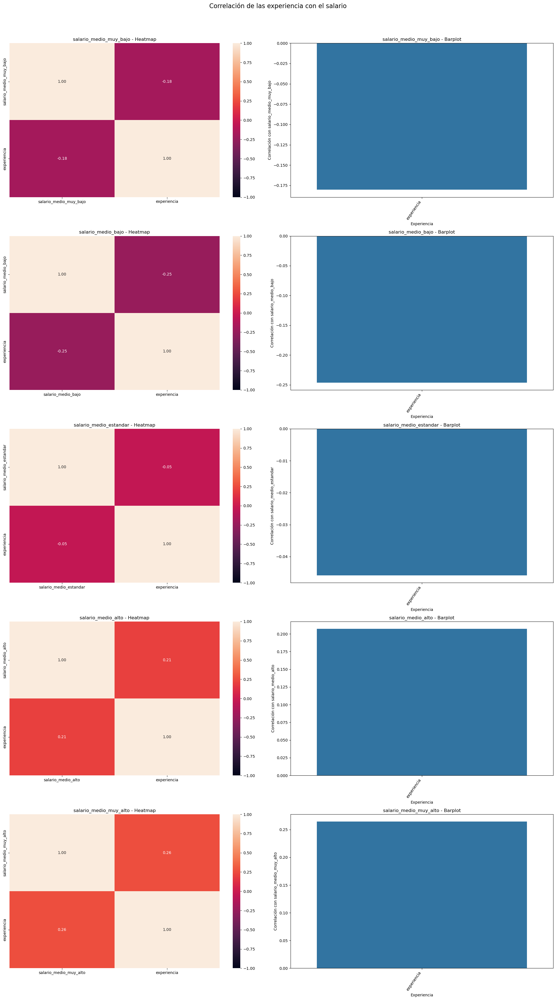

In [137]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):
    df_grafico = df_normalizar.copy()
    
    matriz_correlacion = df_grafico[['experiencia' , categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)

    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de las {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

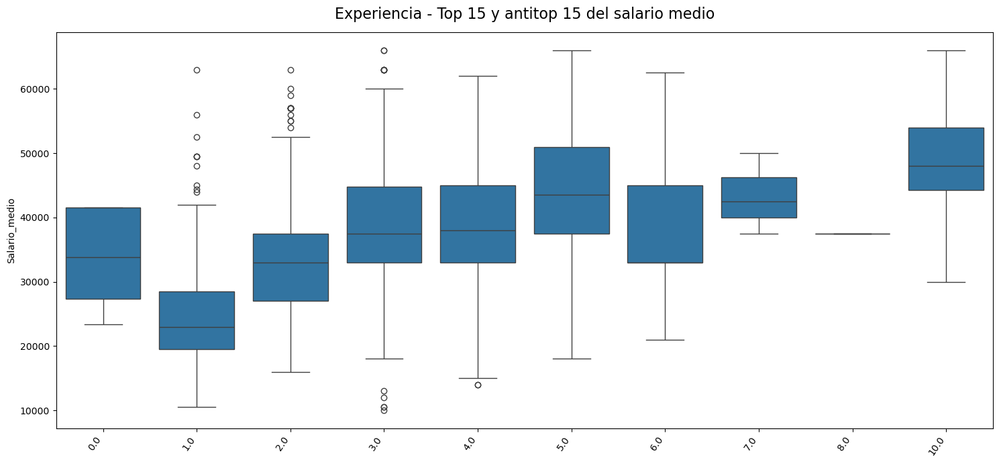

In [138]:
plt.figure(figsize=(15, 7))

df_grafico = df_normalizar.copy()

# Plot del barplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

### 2.11.2. Por rango

In [153]:
#Datos a tratar
df_normalizar = df_experiencia_salario

columnas_normalizar = columnas_rango.copy()

columnas_iterar = columnas_intervalos_salariales

#Caracteristicas grafico
variable = 'rango'

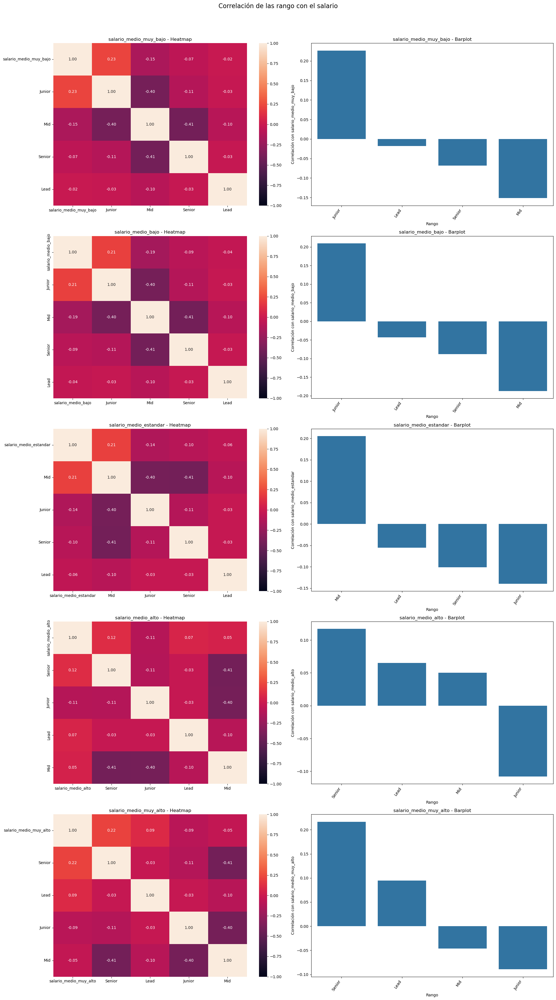

In [154]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):
    df_grafico = df_normalizar.copy()
    
    matriz_correlacion = df_grafico[columnas_rango + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)

    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de las {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

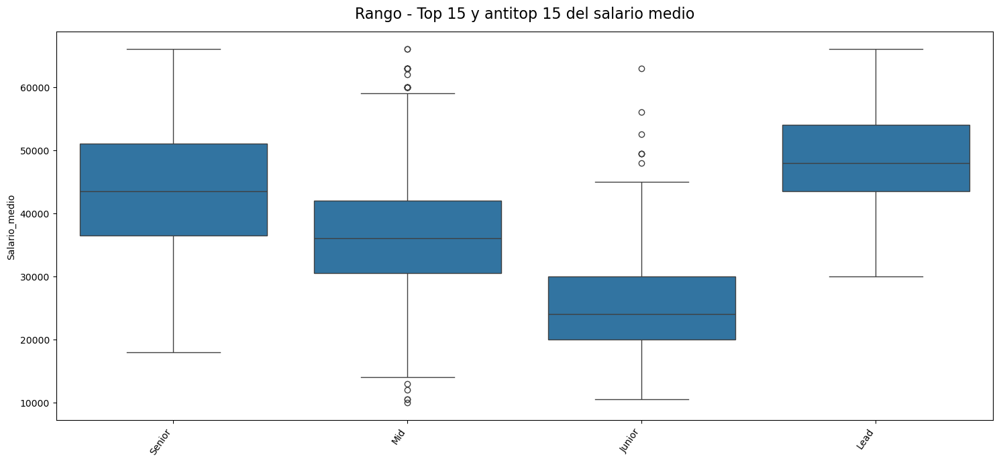

In [155]:
plt.figure(figsize=(15, 7))

df_grafico = df_normalizar.copy()
df_grafico['rango'] = df_grafico['experiencia'].apply(intervalo_experiencia)

# Plot del barplot
sns.boxplot(data=df_grafico, x=variable, y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

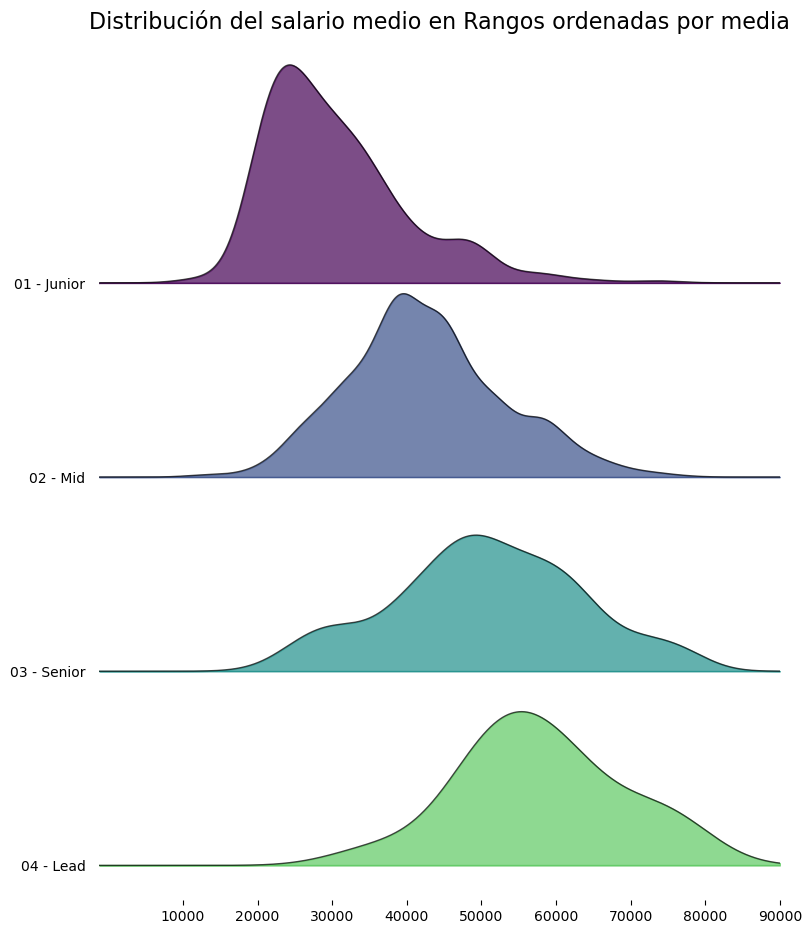

In [156]:
#Definimos el df y la variable
df_selected = df_normalizar[['salario_medio'] + columnas_normalizar]

# Melt para convertir las columnas booleanas en una sola columna 'variable_categorica'
df_melted = pd.melt(df_selected, id_vars=['salario_medio'], var_name='rango', value_name='valor_booleano')

# Filtrar solo las filas con valor True en las columnas booleanas y ordenamos por media de salario
df_grafico = df_melted[df_melted['valor_booleano'] == True]
variable = 'rango'
titulo = 'Rangos'

dic = {el : f'0{i+1} - ' + el if len(f'{i+1}') < 2 else f'{i+1} - ' + el for i, el in enumerate(df_grafico.groupby(variable)['salario_medio'].mean().sort_values().index)}

df_grafico[variable] = df_grafico[variable].map(dic)

# Crear el gráfico ridgelinenormalizar_salarios_columna10, 6))
joyplot(
    data=df_grafico,
    by=variable,
    column='salario_medio',
    colormap=sns.color_palette("viridis", as_cmap=True),
    alpha=0.7,
    linewidth=1,
    figsize=(8, 9),
)

# Configuraciones adicionales
plt.xticks(np.arange(10_000, 100_000, 10_000))
plt.title(f'Distribución del salario medio en {titulo} ordenadas por media', fontsize=16, y=1.02, loc = 'center')
plt.show()

## 3.12. Salario - Jornada

In [157]:
df_jornada = df.copy()
columnas_jornada = df.dropna(subset = 'jornada')['jornada'].unique().tolist()

df_jornada = pd.get_dummies(data = df_jornada, columns = ['jornada'], dtype = int, prefix = '', prefix_sep = '')

In [158]:
df_jornada_salario = pd.merge(left = df_jornada, right = df_salarios, on = df.columns.drop(['jornada', 'herramientas']).tolist())

In [159]:
#Datos a tratar
df_normalizar = df_jornada_salario

columnas_normalizar = df_normalizar['jornada'].unique().tolist()

columnas_iterar = columnas_intervalos_salariales

#Caracteristicas grafico
variable = 'jornada'

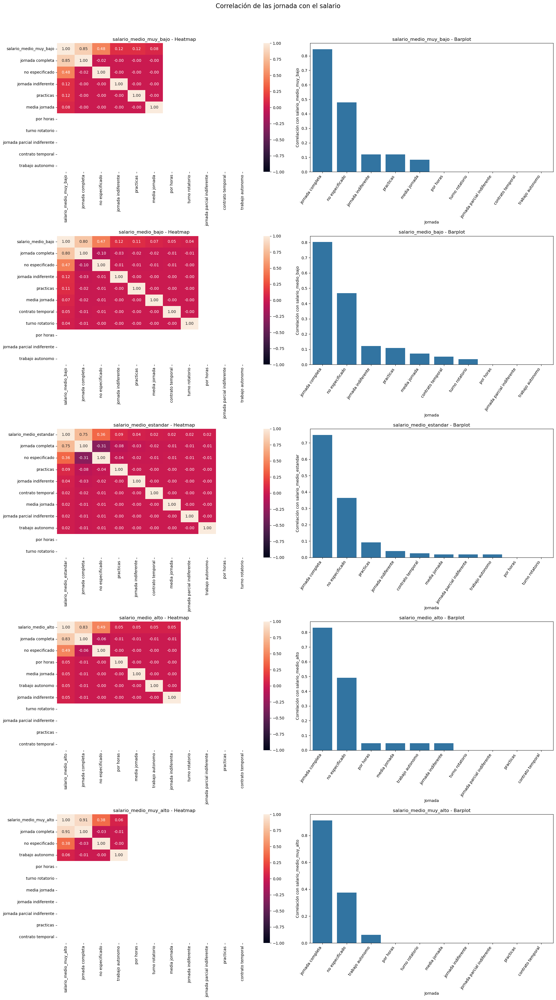

In [160]:
fig, axes = plt.subplots(len(columnas_iterar), 2, figsize=(20, 7 * len(columnas_iterar)))

for i, categoria in enumerate(columnas_iterar):
    df_grafico = normalizar_salarios_columna(df_normalizar, categoria, columnas_normalizar)
    
    matriz_correlacion = df_grafico[columnas_normalizar + [categoria]].corr()
    top_15_mayor_correlacion = abs(matriz_correlacion[categoria]).sort_values(ascending=False).head(16)

    matriz_correlacion = matriz_correlacion[top_15_mayor_correlacion.index].loc[top_15_mayor_correlacion.index]
    top_15_mayor_correlacion = matriz_correlacion[categoria].sort_values(ascending=False).head(16).drop(categoria)
    
    # Plot del heatmap
    sns.heatmap(matriz_correlacion, vmin=-1, vmax=1, annot=True, ax=axes[i, 0], fmt = ".2f")
    axes[i, 0].set_title(f'{categoria} - Heatmap')
    
    # Plot del barplot
    sns.barplot(x=top_15_mayor_correlacion.index, y=top_15_mayor_correlacion.values, ax=axes[i, 1])
    axes[i, 1].set_xlabel(variable[0].upper() + variable[1:])
    axes[i, 1].set_ylabel(f'Correlación con {categoria}')
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=55, ha='right')
    axes[i, 1].set_title(f'{categoria} - Barplot')
    
fig.suptitle(f'Correlación de las {variable} con el salario', fontsize=16, y=1.02)
    
# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

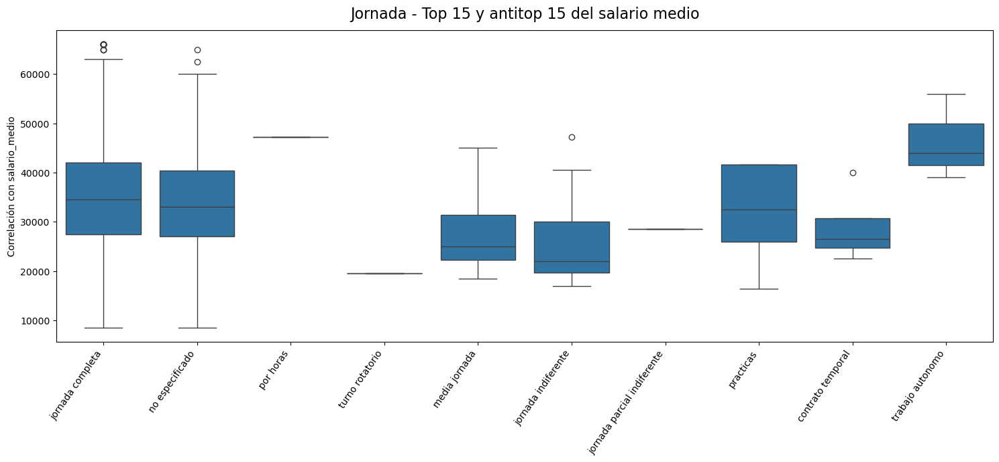

In [161]:
plt.figure(figsize=(15, 7))

df_grafico = df_normalizar.copy()

# Plot del barplot
sns.boxplot(data=df_grafico, x='jornada', y='salario_medio')
plt.xlabel('')
plt.ylabel(f'Correlación con salario_medio')
plt.xticks(rotation = 55, ha = 'right')

plt.title(f'{variable[0].upper() + variable[1:]} - Top 15 y antitop 15 del salario medio', fontsize=16, y=1.02)

# Ajustes adicionales según sea necesario
plt.tight_layout()
plt.show()

# 4. Análisis multivariable

## 4.1. Empresas - Beneficios - Presencialidad

<Figure size 1800x600 with 0 Axes>

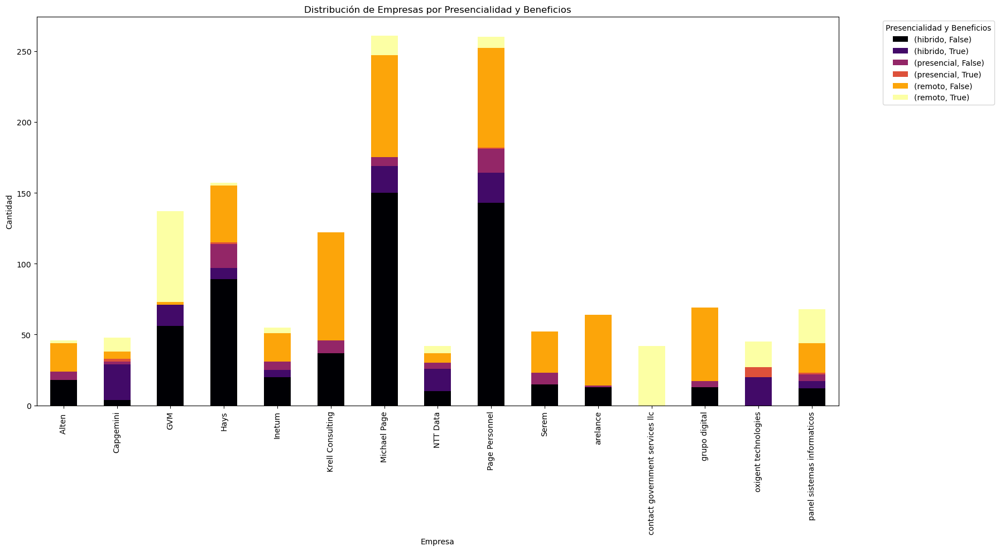

In [162]:
## Empresa - Beneficios - Presencialidad

df_empresa_BP = df[df["presencialidad"] != "no especificado"][["empresa", "beneficios", "presencialidad"]].dropna()
top_15_buss = df_empresa_BP.value_counts("empresa").head(15).index.to_list()

df_empresa_BP = df_empresa_BP[df_empresa_BP["empresa"].isin(top_15_buss)]
df_empresa_BP = df_empresa_BP.groupby(['empresa', 'presencialidad', 'beneficios']).size().reset_index(name='counts')
df_empresa_BP = df_empresa_BP.pivot_table(index='empresa', columns=['presencialidad', 'beneficios'], values='counts', fill_value=0)

plt.figure(figsize=(18, 6))
df_empresa_BP.plot(kind='bar', stacked=True, figsize=(18, 10), colormap='inferno')
plt.title('Distribución de Empresas por Presencialidad y Beneficios')
plt.xlabel('Empresa')
plt.ylabel('Cantidad')
plt.legend(title='Presencialidad y Beneficios', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

## 4.2. Salario - herramienta - titulo

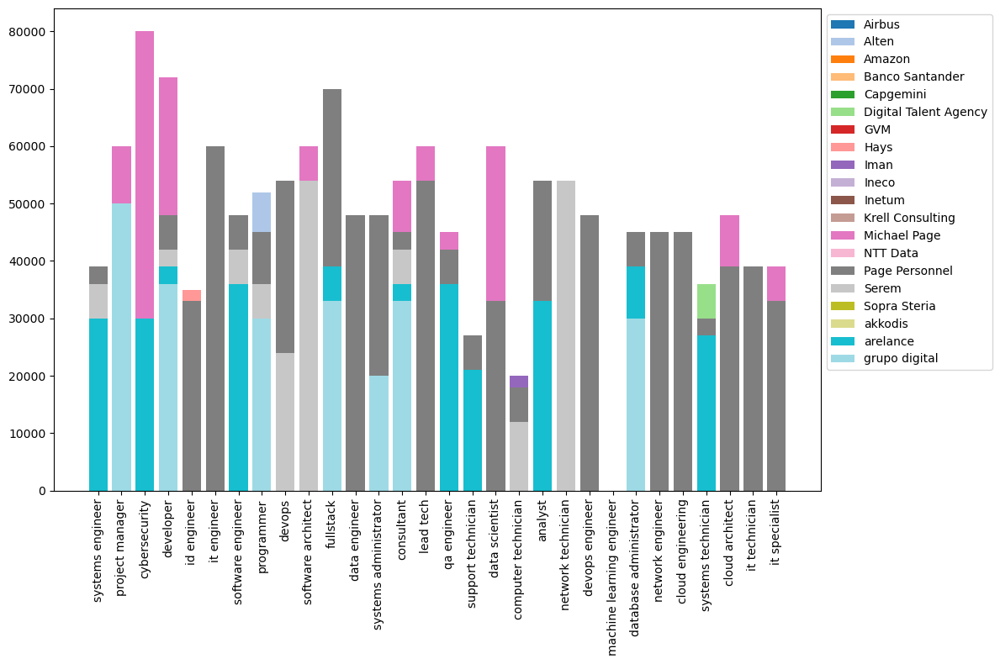

In [163]:
#Salario - herramienta - titulo

top_empresas = df['empresa'].value_counts().head(20).index
top_titulos = df['titulo'].value_counts().head(30).index
df_filtrado = df[df['empresa'].isin(top_empresas) & df['titulo'].isin(top_titulos)]

plt.figure(figsize=(12, 8))
bar_colors = plt.cm.tab20.colors[:len(top_empresas)]

for i, (empresa, datos) in enumerate(df_filtrado.groupby('empresa')):
    plt.bar(datos['titulo'], datos['salario_min'], label=empresa, color=bar_colors[i])

plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1, 1)) 
plt.tight_layout()
plt.show()

## 4.3. Empresas - Sector - Rol

In [165]:
df_empresas['empresa'] = df['empresa']

df_empresas_top_15 = df_empresas[df_empresas['empresa'].isin(top_15_empresas.index)]

df_empresas_top_15['total'] = 1

df_empresas_top_15_sin_otros = df_empresas_top_15[df_empresas_top_15['categoria_empleo'] != 'otros']

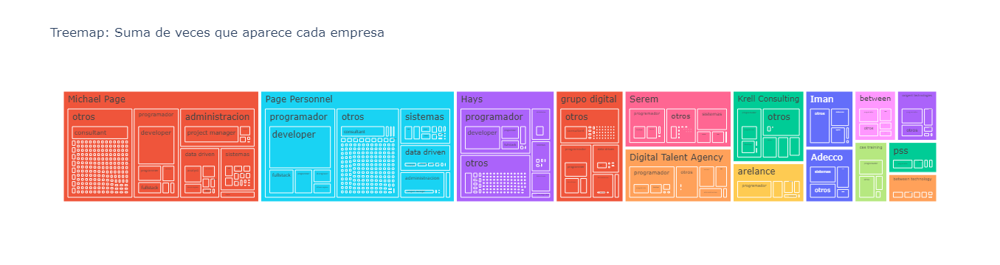

In [166]:
#Grafico con la categoria otros
fig = px.treemap(df_empresas_top_15, 
                 values="total", 
                 path=["empresa", "categoria_empleo", "titulo"],
                 hover_name="titulo",
                 color="empresa",
                 title='Treemap: Suma de veces que aparece cada empresa')

# Mostrar el gráfico
fig.show()

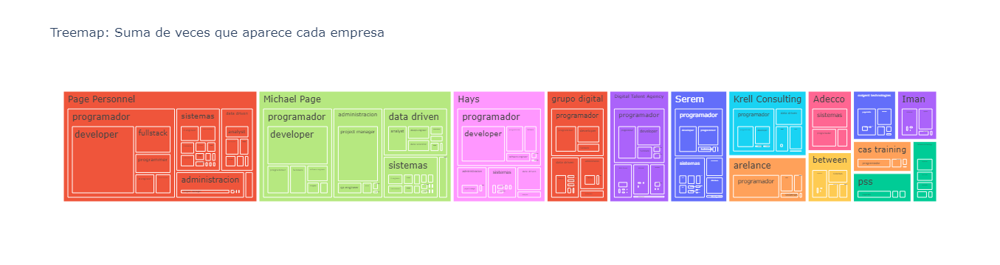

In [167]:
#Grafico sin la categoria otros

fig = px.treemap(df_empresas_top_15_sin_otros, 
                 values="total", 
                 path=["empresa", "categoria_empleo", "titulo"],
                 hover_name="titulo",
                 color="empresa",
                 title='Treemap: Suma de veces que aparece cada empresa')

# Mostrar el gráfico
fig.show()